DDPM : Denoising Diffusion Probabilistic Models

- Ref: 
    - DDPM: https://github.com/MaximeVandegar/Papers-in-100-Lines-of-Code/tree/main/Denoising_Diffusion_Probabilistic_Models


In [1]:
import os
import torch
import torch.nn as nn
import numpy as np

import math
import torch
import torchvision
import torchvision.transforms as transforms
from torchvision import datasets
from torch.utils.data import DataLoader
from torchsummary import summary
import torchshow as ts

from tqdm import tqdm
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import torchvision.transforms.functional as F
from pathlib import Path

from torch.utils.data import Dataset, Subset, random_split
import time
import random



In [2]:
## Unet network model
# Ref: https://github.com/MaximeVandegar/Papers-in-100-Lines-of-Code/blob/main/Denoising_Diffusion_Probabilistic_Models/unet.py

def get_timestep_embedding(timesteps, embedding_dim: int):
    """
    Retrieved from https://github.com/hojonathanho/diffusion/blob/master/diffusion_tf/nn.py#LL90C1-L109C13
    """
    assert len(timesteps.shape) == 1

    half_dim = embedding_dim // 2
    emb = math.log(10000) / (half_dim - 1)
    emb = torch.exp(torch.arange(half_dim, dtype=torch.float32, device=timesteps.device) * -emb)
    emb = timesteps.type(torch.float32)[:, None] * emb[None, :]
    emb = torch.concat([torch.sin(emb), torch.cos(emb)], axis=1)

    if embedding_dim % 2 == 1:  # zero pad
        emb = torch.nn.functional.pad(emb, (0, 1, 0, 0))

    assert emb.shape == (timesteps.shape[0], embedding_dim), f"{emb.shape}"
    return emb


class Downsample(nn.Module):

    def __init__(self, C):
        """
        :param C (int): number of input and output channels
        """
        super(Downsample, self).__init__()
        self.conv = nn.Conv2d(C, C, 3, stride=2, padding=1)

    def forward(self, x):
        B, C, H, W = x.shape
        x = self.conv(x)
        assert x.shape == (B, C, H // 2, W // 2)
        return x


class Upsample(nn.Module):

    def __init__(self, C):
        """
        :param C (int): number of input and output channels
        """
        super(Upsample, self).__init__()
        self.conv = nn.Conv2d(C, C, 3, stride=1, padding=1)

    def forward(self, x):
        B, C, H, W = x.shape

        x = nn.functional.interpolate(x, size=None, scale_factor=2, mode='nearest')

        x = self.conv(x)
        assert x.shape == (B, C, H * 2, W * 2)
        return x


class Nin(nn.Module):

    def __init__(self, in_dim, out_dim, scale=1e-10):
        super(Nin, self).__init__()

        n = (in_dim + out_dim) / 2
        limit = np.sqrt(3 * scale / n)
        self.W = torch.nn.Parameter(torch.zeros((in_dim, out_dim), dtype=torch.float32
                                                ).uniform_(-limit, limit))
        self.b = torch.nn.Parameter(torch.zeros((1, out_dim, 1, 1), dtype=torch.float32))

    def forward(self, x):
        return torch.einsum('bchw, co->bohw', x, self.W) + self.b


class ResNetBlock(nn.Module):

    def __init__(self, in_ch, out_ch, dropout_rate=0.1):
        super(ResNetBlock, self).__init__()

        self.conv1 = nn.Conv2d(in_ch, out_ch, 3, stride=1, padding=1)
        self.dense = nn.Linear(512, out_ch)
        self.conv2 = nn.Conv2d(out_ch, out_ch, 3, stride=1, padding=1)

        if not (in_ch == out_ch):
            self.nin = Nin(in_ch, out_ch)

        self.dropout_rate = dropout_rate
        self.nonlinearity = torch.nn.SiLU()

    def forward(self, x, temb):
        """
        :param x: (B, C, H, W)
        :param temb: (B, dim)
        """

        h = self.nonlinearity(nn.functional.group_norm(x, num_groups=32))
        h = self.conv1(h)

        # add in timestep embedding
        h += self.dense(self.nonlinearity(temb))[:, :, None, None]

        h = self.nonlinearity(nn.functional.group_norm(h, num_groups=32))
        h = nn.functional.dropout(h, p=self.dropout_rate)
        h = self.conv2(h)

        if not (x.shape[1] == h.shape[1]):
            x = self.nin(x)

        assert x.shape == h.shape
        return x + h


class AttentionBlock(nn.Module):

    def __init__(self, ch):
        super(AttentionBlock, self).__init__()

        self.Q = Nin(ch, ch)
        self.K = Nin(ch, ch)
        self.V = Nin(ch, ch)

        self.ch = ch

        self.nin = Nin(ch, ch, scale=0.)

    def forward(self, x):
        B, C, H, W = x.shape
        assert C == self.ch

        h = nn.functional.group_norm(x, num_groups=32)
        q = self.Q(h)
        k = self.K(h)
        v = self.V(h)

        w = torch.einsum('bchw,bcHW->bhwHW', q, k) * (int(C) ** (-0.5))  # [B, H, W, H, W]
        w = torch.reshape(w, [B, H, W, H * W])
        w = torch.nn.functional.softmax(w, dim=-1)
        w = torch.reshape(w, [B, H, W, H, W])

        h = torch.einsum('bhwHW,bcHW->bchw', w, v)
        h = self.nin(h)

        assert h.shape == x.shape
        return x + h


class UNet(nn.Module):

    def __init__(self, ch=128, in_ch=1):
        super(UNet, self).__init__()

        self.ch = ch
        self.linear1 = nn.Linear(ch, 4 * ch)
        self.linear2 = nn.Linear(4 * ch, 4 * ch)

        self.conv1 = nn.Conv2d(in_ch, ch, 3, stride=1, padding=1)

        self.down = nn.ModuleList([ResNetBlock(ch, 1 * ch),
                                   ResNetBlock(1 * ch, 1 * ch),
                                   Downsample(1 * ch),
                                   ResNetBlock(1 * ch, 2 * ch),
                                   AttentionBlock(2 * ch),
                                   ResNetBlock(2 * ch, 2 * ch),
                                   AttentionBlock(2 * ch),
                                   Downsample(2 * ch),
                                   ResNetBlock(2 * ch, 2 * ch),
                                   ResNetBlock(2 * ch, 2 * ch),
                                   Downsample(2 * ch),
                                   ResNetBlock(2 * ch, 2 * ch),
                                   ResNetBlock(2 * ch, 2 * ch)])

        self.middle = nn.ModuleList([ResNetBlock(2 * ch, 2 * ch),
                                     AttentionBlock(2 * ch),
                                     ResNetBlock(2 * ch, 2 * ch)])

        self.up = nn.ModuleList([ResNetBlock(4 * ch, 2 * ch),
                                 ResNetBlock(4 * ch, 2 * ch),
                                 ResNetBlock(4 * ch, 2 * ch),
                                 Upsample(2 * ch),
                                 ResNetBlock(4 * ch, 2 * ch),
                                 ResNetBlock(4 * ch, 2 * ch),
                                 ResNetBlock(4 * ch, 2 * ch),
                                 Upsample(2 * ch),
                                 ResNetBlock(4 * ch, 2 * ch),
                                 AttentionBlock(2 * ch),
                                 ResNetBlock(4 * ch, 2 * ch),
                                 AttentionBlock(2 * ch),
                                 ResNetBlock(3 * ch, 2 * ch),
                                 AttentionBlock(2 * ch),
                                 Upsample(2 * ch),
                                 ResNetBlock(3 * ch, ch),
                                 ResNetBlock(2 * ch, ch),
                                 ResNetBlock(2 * ch, ch)])

        self.final_conv = nn.Conv2d(ch, in_ch, 3, stride=1, padding=1)

    def forward(self, x, t):
        """
        :param x: (torch.Tensor) batch of images [B, C, H, W]
        :param t: (torch.Tensor) tensor of time steps (torch.long) [B]
        """

        temb = get_timestep_embedding(t, self.ch)
        temb = torch.nn.functional.silu(self.linear1(temb))
        temb = self.linear2(temb)
        assert temb.shape == (t.shape[0], self.ch * 4)

        x1 = self.conv1(x)

        # Down
        x2 = self.down[0](x1, temb)
        x3 = self.down[1](x2, temb)
        x4 = self.down[2](x3)
        x5 = self.down[3](x4, temb)
        x6 = self.down[4](x5)  # Attention
        x7 = self.down[5](x6, temb)
        x8 = self.down[6](x7)  # Attention
        x9 = self.down[7](x8)
        x10 = self.down[8](x9, temb)
        x11 = self.down[9](x10, temb)
        x12 = self.down[10](x11)
        x13 = self.down[11](x12, temb)
        x14 = self.down[12](x13, temb)

        # Middle
        x = self.middle[0](x14, temb)
        x = self.middle[1](x)
        x = self.middle[2](x, temb)

        # Up
        x = self.up[0](torch.cat((x, x14), dim=1), temb)
        x = self.up[1](torch.cat((x, x13), dim=1), temb)
        x = self.up[2](torch.cat((x, x12), dim=1), temb)
        x = self.up[3](x)
        x = self.up[4](torch.cat((x, x11), dim=1), temb)
        x = self.up[5](torch.cat((x, x10), dim=1), temb)
        x = self.up[6](torch.cat((x, x9), dim=1), temb)
        x = self.up[7](x)
        x = self.up[8](torch.cat((x, x8), dim=1), temb)
        x = self.up[9](x)
        x = self.up[10](torch.cat((x, x6), dim=1), temb)
        x = self.up[11](x)
        x = self.up[12](torch.cat((x, x4), dim=1), temb)
        x = self.up[13](x)
        x = self.up[14](x)
        x = self.up[15](torch.cat((x, x3), dim=1), temb)
        x = self.up[16](torch.cat((x, x2), dim=1), temb)
        x = self.up[17](torch.cat((x, x1), dim=1), temb)

        x = nn.functional.silu(nn.functional.group_norm(x, num_groups=32))
        x = self.final_conv(x)

        return x


- DDPM
    - ![DDPM](https://img1.daumcdn.net/thumb/R1280x0/?scode=mtistory2&fname=https%3A%2F%2Fblog.kakaocdn.net%2Fdn%2FRXOe5%2Fbtru2nyl2SU%2FzkLx0SMgf1qpaI01kCmGu1%2Fimg.png)

- DDPM vs. DDIM
    - ![](https://kimjy99.github.io/assets/img/ddim/ddim-markovian.webp)
    - $x_{t-1} = \sqrt{\alpha_{t-1}} \underbrace{\bigg( \frac{x_t - \sqrt{1-\alpha_t} \epsilon_\theta^{(t)} (x_t)}{\sqrt{\alpha_t}} \bigg)}_{\textrm{predicted } x_0} + \underbrace{\sqrt{1-\alpha_{t-1} -\sigma_t^2} \cdot \epsilon_\theta^{(t)} (x_t)}_{\textrm{direction pointing to } x_t}+ \underbrace{\sigma_t \epsilon_t}_{\textrm{random noise}}$ 
    - if $\sigma_t = \sqrt{\frac{1-\alpha_{t-1}}{1-\alpha_t}} \sqrt{1 - \frac{\alpha_t}{\alpha_{t-1}}}$, Generative process -> DDPM

In [3]:
# Diffusion Model

class DiffusionModel:

    def __init__(self, T: int, model: nn.Module, device: str):
        self.T = T
        self.function_approximator = model.to(device)
        self.device = device

        self.beta = torch.linspace(1e-4, 0.02, T).to(device)
        self.alpha = 1. - self.beta
        self.alpha_bar = torch.cumprod(self.alpha, dim=0)

        # DPM_SOLVER
        self.alphas = torch.sqrt(self.alpha_bar)
        self.sigmas = torch.sqrt(1.0 - self.alpha_bar)
        self.lambdas = torch.log(self.alphas / self.sigmas)

    def training(self, x0, batch_size, optimizer):
        """
        Algorithm 1 in Denoising Diffusion Probabilistic Models
        """
        # with torch.autocast(device_type='cuda', dtype=torch.float16):
            # x0 = sample_batch(batch_size, self.device)
        t = torch.randint(1, self.T + 1, (batch_size,), device=self.device,
                        dtype=torch.long)
        eps = torch.randn_like(x0)

        # Take one gradient descent step
        alpha_bar_t = self.alpha_bar[t - 1].unsqueeze(-1).unsqueeze(
            -1).unsqueeze(-1)
        eps_predicted = self.function_approximator(torch.sqrt(alpha_bar_t) * x0 + torch.sqrt(1 - alpha_bar_t) * eps, t - 1)
        loss = nn.functional.mse_loss(eps, eps_predicted)
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        return loss.item()
    

    def training_2(self, x0, batch_size, optimizer):
        """
        Algorithm 1 in Denoising Diffusion Probabilistic Models
        """
        t_list =  list(range(1, self.T + 1))
        random.shuffle(t_list)
        t_loss = 0
        for tidx in tqdm(t_list):
        
            # x0 = sample_batch(batch_size, self.device)
            # t = torch.randint(1, self.T + 1, (batch_size,), device=self.device,
            #                 dtype=torch.long)
            t = torch.ones((batch_size,), device=self.device, dtype=torch.long) * tidx
            eps = torch.randn_like(x0)

            # Take one gradient descent step
            alpha_bar_t = self.alpha_bar[t - 1].unsqueeze(-1).unsqueeze(
                -1).unsqueeze(-1)
            eps_predicted = self.function_approximator(torch.sqrt(alpha_bar_t) * x0 + torch.sqrt(1 - alpha_bar_t) * eps, t - 1)
            loss = nn.functional.mse_loss(eps, eps_predicted)
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            t_loss += loss.item()

        return t_loss / self.T
    
    def training_3(self, x0, batch_size, optimizer):
        """
        Algorithm 1 in Denoising Diffusion Probabilistic Models
        """
        _t_list =  list(range(1, self.T + 1))
        t_list = random.sample(_t_list, self.T // 10)
        t_loss = 0
        for tidx in tqdm(t_list):
        
            # x0 = sample_batch(batch_size, self.device)
            # t = torch.randint(1, self.T + 1, (batch_size,), device=self.device,
            #                 dtype=torch.long)
            t = torch.ones((batch_size,), device=self.device, dtype=torch.long) * tidx
            eps = torch.randn_like(x0)

            # Take one gradient descent step
            alpha_bar_t = self.alpha_bar[t - 1].unsqueeze(-1).unsqueeze(
                -1).unsqueeze(-1)
            eps_predicted = self.function_approximator(torch.sqrt(alpha_bar_t) * x0 + torch.sqrt(1 - alpha_bar_t) * eps, t - 1)
            loss = nn.functional.mse_loss(eps, eps_predicted)
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            t_loss += loss.item()

        return t_loss / len(t_list)

    @torch.no_grad()
    def sampling(self, n_samples=1, image_channels=1, img_size=(32, 32), sample_it = 10):
        """
        Algorithm 2 in Denoising Diffusion Probabilistic Models
        """
        t_lst = []
        x = torch.randn((n_samples, image_channels, img_size[0], img_size[1]),
                        device=self.device)
        for it in tqdm(range(self.T, 0, -1), desc="Sampling"):
            if it % sample_it == 0:
                t_lst.append((it, x))
            z = torch.randn_like(x) if it > 1 else torch.zeros_like(x)
            t = torch.ones(n_samples, dtype=torch.long, device=self.device) * it

            beta_t = self.beta[t - 1].unsqueeze(-1).unsqueeze(-1).unsqueeze(-1)
            alpha_t = self.alpha[t - 1].unsqueeze(-1).unsqueeze(-1).unsqueeze(-1)
            alpha_bar_t = self.alpha_bar[t - 1].unsqueeze(-1).unsqueeze(-1).unsqueeze(-1)

            mean = 1 / torch.sqrt(alpha_t) * (x - ((1 - alpha_t) / torch.sqrt(
                1 - alpha_bar_t)) * self.function_approximator(x, t - 1))
            sigma = torch.sqrt(beta_t)
            x = mean + sigma * z
        t_lst.append((it-1, x))
        return x, t_lst

    @torch.no_grad()
    def ddpm_sampling(self, n_samples=1, image_channels=1, img_size=(32, 32),
                 use_tqdm=True):
        """
        Algorithm 2 in Denoising Diffusion Probabilistic Models
        """

        x = torch.randn((n_samples, image_channels, img_size[0], img_size[1]),
                        device=self.device)
        progress_bar = tqdm if use_tqdm else lambda x: x
        # for t in progress_bar(range(self.T, 0, -1)):
        for t in tqdm(range(self.T, 0, -1), desc="DDPM Sampling"):
            z = torch.randn_like(x) if t > 1 else torch.zeros_like(x)
            t = torch.ones(n_samples, dtype=torch.long, device=self.device) * t

            beta_t = self.beta[t - 1].unsqueeze(-1).unsqueeze(-1).unsqueeze(-1)
            alpha_t = self.alpha[t - 1].unsqueeze(-1).unsqueeze(-1).unsqueeze(-1)
            alpha_bar_t = self.alpha_bar[t - 1].unsqueeze(-1).unsqueeze(-1).unsqueeze(-1)

            mean = 1 / torch.sqrt(alpha_t) * (x - ((1 - alpha_t) / torch.sqrt(
                1 - alpha_bar_t)) * self.function_approximator(x, t - 1))
            sigma = torch.sqrt(beta_t)
            x = mean + sigma * z
        return x

    @torch.no_grad()
    def ddim_sampling(self, n_samples=1, image_channels=1, img_size=(32, 32),
                      n_steps=50, use_tqdm=True):

        step_size = self.T // n_steps
        x = torch.randn((n_samples, image_channels, img_size[0], img_size[1]),
                        device=self.device)
        progress_bar = tqdm if use_tqdm else lambda x: x

        # for i in progress_bar(range(n_steps)):
        for i in tqdm(range(n_steps), desc="DDIM Sampling"):
            t = self.T - i * step_size
            t_tensor = torch.ones(n_samples, dtype=torch.long, device=self.device) * t

            alpha_bar_t = self.alpha_bar[t - 1].unsqueeze(-1).unsqueeze(-1).unsqueeze(-1)
            alpha_bar_prev = self.alpha_bar[t - step_size - 1].unsqueeze(-1).unsqueeze(-1).unsqueeze(-1) if t > step_size else torch.tensor(1.0).to(self.device)

            # Predicted noise
            eps_pred = self.function_approximator(x, t_tensor - 1)

            # Predicted x_0
            x0_pred = (x - torch.sqrt(1 - alpha_bar_t) * eps_pred) / torch.sqrt(alpha_bar_t)

            # Direction pointing to xt
            dir_xt = torch.sqrt(1 - alpha_bar_prev) * eps_pred

            # Update rule
            x = torch.sqrt(alpha_bar_prev) * x0_pred + dir_xt

        return x

    @torch.no_grad()
    def dpm_solver_sampling(self, n_samples=1, image_channels=1, img_size=(32, 32), n_steps=10, use_tqdm=True):
        """
        DPM-Solver-2 (Algorithm 1 from https://arxiv.org/pdf/2206.00927).
        """
        step_size = self.T // n_steps
        # start from Gaussian noise x_T
        xT = torch.randn((n_samples, image_channels, img_size[0], img_size[1]), device=self.device)
        x_tilde = xT

        for i in tqdm(range(n_steps), desc="DPM-Solver Sampling", disable=not use_tqdm):

            t_prev = self.T - i * step_size
            t_cur = max(t_prev - step_size, 1)

            # midpoint in λ-space
            lam_mid = (self.lambdas[t_prev - 1] + self.lambdas[t_cur - 1]) / 2.
            # invert λ→t via nearest neighbor lookup
            s_i = torch.argmin(torch.abs(self.lambdas - lam_mid)).item() + 1

            # λ-step size
            h = self.lambdas[t_cur - 1] - self.lambdas[t_prev - 1]

            # model evaluation at t_prev
            t_prev_tensor = torch.full((n_samples,), t_prev, dtype=torch.long, device=self.device)
            u_i = (self.alphas[s_i - 1] / self.alphas[t_prev - 1]) * x_tilde - self.sigmas[s_i - 1] * (
                torch.exp(h * 0.5) - 1) * self.function_approximator(x_tilde, t_prev_tensor - 1)

            t_s_tensor = torch.full((n_samples,), s_i, dtype=torch.long, device=self.device)
            x_tilde = (self.alphas[t_cur - 1] / self.alphas[t_prev - 1]) * x_tilde - self.sigmas[t_cur - 1] * (
                torch.exp(h) - 1) * self.function_approximator(u_i, t_s_tensor - 1)

        return x_tilde

In [4]:
if torch.backends.mps.is_available():
    g_device = torch.device("mps")
    print(f"Current memory allocated on MPS: {torch.mps.current_allocated_memory()} bytes")
    print(f"Driver memory allocated on MPS: {torch.mps.driver_allocated_memory()} bytes")
elif torch.cuda.is_available():
    g_device = torch.device("cuda")
else:
    g_device = torch.device("cpu")
print(g_device)

cuda


In [5]:

def save_video(img_t_lst, nrows = 9, ncols = 9, v_fp = "test.mp4"):
    # fig, axes = plt.subplots(nrows, ncols, figsize=(6, 6))
    fig, axes = plt.subplots(nrows, ncols)
    ims = []
    for i, imt in img_t_lst:
        frame_ims = []
        if not isinstance(i, int):
            i = i[0]
        for j, ax in enumerate(axes.flat):
            # print(f"{i}_{j}")
            # ax.set_title(f"{i}_{j}")
            ax.axis('off')
            img_n = (imt[j].to("cpu") + 1) * 0.5
            img_n = F.to_pil_image(img_n.clip(0, 1))
            frame_ims.append(ax.imshow(img_n, cmap='gray'))
            # frame_ims.append(ax.imshow(F.to_pil_image(imt[j].to("cpu").clip(0, 1)), cmap='gray'))
        ims.append(frame_ims)
    ani = animation.ArtistAnimation(fig, ims, interval=50, blit=True, repeat_delay=1000)
    # vfp = os.path.join(g_video_path, v_fname)
    ani.save(v_fp, writer="ffmpeg", fps=10)



def save_video_01(img_t_lst, nrows = 9, ncols = 9, v_fp = "test.mp4"):
    # fig, axes = plt.subplots(nrows, ncols, figsize=(6, 6))
    fig, axes = plt.subplots(nrows, ncols)
    ims = []
    for i, imt in img_t_lst:
        frame_ims = []
        if not isinstance(i, int):
            i = i[0]
        for j, ax in enumerate(axes.flat):
            # print(f"{i}_{j}")
            # ax.set_title(f"{i}_{j}")
            ax.axis('off')
            img_n = (imt[j].to("cpu") + 1) * 0.5
            img_n = F.to_pil_image(img_n.clip(0, 1))
            frame_ims.append(ax.imshow(img_n, cmap='gray'))
            # frame_ims.append(ax.imshow(F.to_pil_image(imt[j].to("cpu").clip(0, 1)), cmap='gray'))
        ims.append(frame_ims)
    ani = animation.ArtistAnimation(fig, ims, interval=50, blit=True, repeat_delay=1000)
    # vfp = os.path.join(g_video_path, v_fname)
    ani.save(v_fp, writer="ffmpeg", fps=10)

Epoch - 0 / 2000000- Loss: 0.94417; step 4; epoch 0: 100%|██████████| 5/5 [00:01<00:00,  2.65it/s]


best loss : 5.162677049636841


Sampling: 100%|██████████| 1000/1000 [01:58<00:00,  8.47it/s]
INFO:matplotlib.animation:Animation.save using <class 'matplotlib.animation.FFMpegWriter'>
INFO:matplotlib.animation:MovieWriter._run: running command: ffmpeg -f rawvideo -vcodec rawvideo -s 640x480 -pix_fmt rgba -framerate 10 -loglevel error -i pipe: -vcodec h264 -pix_fmt yuv420p -y ./temp_2_3/Diffusion_00_Food101_videos_sample_10_data_01/test_000.mp4
DPM-Solver Sampling: 100%|██████████| 10/10 [00:02<00:00,  4.55it/s]


ddpm - 119.37806, ddim - 5.88331, dpm_sampling - 2.20108


Epoch - 1 / 2000000- Loss: 0.75161; step 4; epoch 1: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]


best loss : 4.188551843166351


Epoch - 2 / 2000000- Loss: 0.57944; step 4; epoch 2: 100%|██████████| 5/5 [00:01<00:00,  2.85it/s]


best loss : 3.530725836753845


Epoch - 3 / 2000000- Loss: 0.52385; step 4; epoch 3: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]


best loss : 2.670438975095749


Epoch - 4 / 2000000- Loss: 0.42360; step 4; epoch 4: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]


best loss : 2.010840117931366


Epoch - 5 / 2000000- Loss: 0.48399; step 4; epoch 5: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]


best loss : 1.895318627357483


Epoch - 6 / 2000000- Loss: 0.24678; step 4; epoch 6: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]


best loss : 1.2451732754707336


Epoch - 7 / 2000000- Loss: 0.37134; step 4; epoch 7: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]


best loss : 1.2271605283021927


Epoch - 8 / 2000000- Loss: 0.19463; step 4; epoch 8: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]


best loss : 1.051901862025261


Epoch - 9 / 2000000- Loss: 0.16149; step 4; epoch 9: 100%|██████████| 5/5 [00:01<00:00,  2.92it/s]


best loss : 0.7707339227199554


Epoch - 10 / 2000000- Loss: 0.13264; step 4; epoch 10: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 11 / 2000000- Loss: 0.16805; step 4; epoch 11: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 12 / 2000000- Loss: 0.10420; step 4; epoch 12: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]


best loss : 0.5997141599655151


Epoch - 13 / 2000000- Loss: 0.09922; step 4; epoch 13: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 14 / 2000000- Loss: 0.10417; step 4; epoch 14: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 15 / 2000000- Loss: 0.09818; step 4; epoch 15: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]


best loss : 0.5993613004684448


Epoch - 16 / 2000000- Loss: 0.09099; step 4; epoch 16: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]


best loss : 0.45271456241607666


Epoch - 17 / 2000000- Loss: 0.11638; step 4; epoch 17: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 18 / 2000000- Loss: 0.08089; step 4; epoch 18: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 19 / 2000000- Loss: 0.08865; step 4; epoch 19: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 20 / 2000000- Loss: 0.08016; step 4; epoch 20: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 21 / 2000000- Loss: 0.07602; step 4; epoch 21: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 22 / 2000000- Loss: 0.08858; step 4; epoch 22: 100%|██████████| 5/5 [00:01<00:00,  2.92it/s]


best loss : 0.4323222041130066


Epoch - 23 / 2000000- Loss: 0.06996; step 4; epoch 23: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]


best loss : 0.4034828767180443


Epoch - 24 / 2000000- Loss: 0.11191; step 4; epoch 24: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 25 / 2000000- Loss: 0.07435; step 4; epoch 25: 100%|██████████| 5/5 [00:01<00:00,  2.92it/s]
Epoch - 26 / 2000000- Loss: 0.16546; step 4; epoch 26: 100%|██████████| 5/5 [00:01<00:00,  2.93it/s]
Epoch - 27 / 2000000- Loss: 0.11841; step 4; epoch 27: 100%|██████████| 5/5 [00:01<00:00,  2.93it/s]
Epoch - 28 / 2000000- Loss: 0.10908; step 4; epoch 28: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 29 / 2000000- Loss: 0.08081; step 4; epoch 29: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]


best loss : 0.3728102520108223


Epoch - 30 / 2000000- Loss: 0.19743; step 4; epoch 30: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 31 / 2000000- Loss: 0.28912; step 4; epoch 31: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 32 / 2000000- Loss: 0.05818; step 4; epoch 32: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 33 / 2000000- Loss: 0.09324; step 4; epoch 33: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]


best loss : 0.3551040068268776


Epoch - 34 / 2000000- Loss: 0.05784; step 4; epoch 34: 100%|██████████| 5/5 [00:01<00:00,  2.92it/s]


best loss : 0.3347233422100544


Epoch - 35 / 2000000- Loss: 0.05928; step 4; epoch 35: 100%|██████████| 5/5 [00:01<00:00,  2.92it/s]
Epoch - 36 / 2000000- Loss: 0.06283; step 4; epoch 36: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 37 / 2000000- Loss: 0.05443; step 4; epoch 37: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 38 / 2000000- Loss: 0.05880; step 4; epoch 38: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 39 / 2000000- Loss: 0.05758; step 4; epoch 39: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]


best loss : 0.32334959506988525


Epoch - 40 / 2000000- Loss: 0.06042; step 4; epoch 40: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]


best loss : 0.2923697344958782


Epoch - 41 / 2000000- Loss: 0.06095; step 4; epoch 41: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]


best loss : 0.28611382097005844


Epoch - 42 / 2000000- Loss: 0.06661; step 4; epoch 42: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 43 / 2000000- Loss: 0.06812; step 4; epoch 43: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 44 / 2000000- Loss: 0.10637; step 4; epoch 44: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 45 / 2000000- Loss: 0.06241; step 4; epoch 45: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 46 / 2000000- Loss: 0.11156; step 4; epoch 46: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 47 / 2000000- Loss: 0.05991; step 4; epoch 47: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 48 / 2000000- Loss: 0.04574; step 4; epoch 48: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 49 / 2000000- Loss: 0.04656; step 4; epoch 49: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]


best loss : 0.24821072816848755


Epoch - 50 / 2000000- Loss: 0.06534; step 4; epoch 50: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 51 / 2000000- Loss: 0.12316; step 4; epoch 51: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 52 / 2000000- Loss: 0.05289; step 4; epoch 52: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 53 / 2000000- Loss: 0.04871; step 4; epoch 53: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]


best loss : 0.2415613941848278


Epoch - 54 / 2000000- Loss: 0.04342; step 4; epoch 54: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 55 / 2000000- Loss: 0.10626; step 4; epoch 55: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 56 / 2000000- Loss: 0.04896; step 4; epoch 56: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 57 / 2000000- Loss: 0.25804; step 4; epoch 57: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 58 / 2000000- Loss: 0.09085; step 4; epoch 58: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 59 / 2000000- Loss: 0.04341; step 4; epoch 59: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 60 / 2000000- Loss: 0.05898; step 4; epoch 60: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 61 / 2000000- Loss: 0.12279; step 4; epoch 61: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 62 / 2000000- Loss: 0.04424; step 4; epoch 62: 100%|██████████| 5/5 [00:01<00:00,  2.92it/s]
Epoch - 63 / 2000000- Loss: 0.08617; step 4; epoch 63: 100%|██████████| 5/5 [00:01<00:00,  

best loss : 0.22922668233513832


Epoch - 65 / 2000000- Loss: 0.05952; step 4; epoch 65: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 66 / 2000000- Loss: 0.03796; step 4; epoch 66: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 67 / 2000000- Loss: 0.04420; step 4; epoch 67: 100%|██████████| 5/5 [00:01<00:00,  2.92it/s]
Epoch - 68 / 2000000- Loss: 0.04364; step 4; epoch 68: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 69 / 2000000- Loss: 0.05923; step 4; epoch 69: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 70 / 2000000- Loss: 0.05772; step 4; epoch 70: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]


best loss : 0.2200460284948349


Epoch - 71 / 2000000- Loss: 0.05660; step 4; epoch 71: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 72 / 2000000- Loss: 0.03609; step 4; epoch 72: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 73 / 2000000- Loss: 0.03656; step 4; epoch 73: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]


best loss : 0.21283425018191338


Epoch - 74 / 2000000- Loss: 0.03829; step 4; epoch 74: 100%|██████████| 5/5 [00:01<00:00,  2.86it/s]
Epoch - 75 / 2000000- Loss: 0.05460; step 4; epoch 75: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]


best loss : 0.20857316628098488


Epoch - 76 / 2000000- Loss: 0.03594; step 4; epoch 76: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]


best loss : 0.19129042699933052


Epoch - 77 / 2000000- Loss: 0.05285; step 4; epoch 77: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 78 / 2000000- Loss: 0.03355; step 4; epoch 78: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 79 / 2000000- Loss: 0.04702; step 4; epoch 79: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 80 / 2000000- Loss: 0.04252; step 4; epoch 80: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 81 / 2000000- Loss: 0.04555; step 4; epoch 81: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 82 / 2000000- Loss: 0.05388; step 4; epoch 82: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 83 / 2000000- Loss: 0.03967; step 4; epoch 83: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 84 / 2000000- Loss: 0.05570; step 4; epoch 84: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 85 / 2000000- Loss: 0.03547; step 4; epoch 85: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 86 / 2000000- Loss: 0.05664; step 4; epoch 86: 100%|██████████| 5/5 [00:01<00:00,  

best loss : 0.17686791345477104


Epoch - 96 / 2000000- Loss: 0.03532; step 4; epoch 96: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 97 / 2000000- Loss: 0.03244; step 4; epoch 97: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 98 / 2000000- Loss: 0.04154; step 4; epoch 98: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 99 / 2000000- Loss: 0.03015; step 4; epoch 99: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 100 / 2000000- Loss: 0.02893; step 4; epoch 100: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 101 / 2000000- Loss: 0.04678; step 4; epoch 101: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 102 / 2000000- Loss: 0.06111; step 4; epoch 102: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 103 / 2000000- Loss: 0.03499; step 4; epoch 103: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 104 / 2000000- Loss: 0.04540; step 4; epoch 104: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 105 / 2000000- Loss: 0.02839; step 4; epoch 105: 100%|██████████| 5/5 [00

best loss : 0.1652150060981512


Epoch - 106 / 2000000- Loss: 0.02959; step 4; epoch 106: 100%|██████████| 5/5 [00:01<00:00,  2.86it/s]
Epoch - 107 / 2000000- Loss: 0.02934; step 4; epoch 107: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]


best loss : 0.15584772638976574


Epoch - 108 / 2000000- Loss: 0.04119; step 4; epoch 108: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 109 / 2000000- Loss: 0.03026; step 4; epoch 109: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 110 / 2000000- Loss: 0.03078; step 4; epoch 110: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 111 / 2000000- Loss: 0.03396; step 4; epoch 111: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 112 / 2000000- Loss: 0.03188; step 4; epoch 112: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 113 / 2000000- Loss: 0.03241; step 4; epoch 113: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 114 / 2000000- Loss: 0.02804; step 4; epoch 114: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 115 / 2000000- Loss: 0.08955; step 4; epoch 115: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 116 / 2000000- Loss: 0.10227; step 4; epoch 116: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 117 / 2000000- Loss: 0.03205; step 4; epoch 117: 100%|██████████|

best loss : 0.1425750982016325


Epoch - 125 / 2000000- Loss: 0.04340; step 4; epoch 125: 100%|██████████| 5/5 [00:01<00:00,  2.92it/s]
Epoch - 126 / 2000000- Loss: 0.03359; step 4; epoch 126: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 127 / 2000000- Loss: 0.03148; step 4; epoch 127: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 128 / 2000000- Loss: 0.03052; step 4; epoch 128: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 129 / 2000000- Loss: 0.02401; step 4; epoch 129: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 130 / 2000000- Loss: 0.10348; step 4; epoch 130: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 131 / 2000000- Loss: 0.08051; step 4; epoch 131: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 132 / 2000000- Loss: 0.26166; step 4; epoch 132: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 133 / 2000000- Loss: 0.06267; step 4; epoch 133: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 134 / 2000000- Loss: 0.02375; step 4; epoch 134: 100%|██████████|

best loss : 0.1391646061092615


Epoch - 155 / 2000000- Loss: 0.02770; step 4; epoch 155: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 156 / 2000000- Loss: 0.02548; step 4; epoch 156: 100%|██████████| 5/5 [00:01<00:00,  2.92it/s]
Epoch - 157 / 2000000- Loss: 0.03376; step 4; epoch 157: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 158 / 2000000- Loss: 0.02035; step 4; epoch 158: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]


best loss : 0.12599690817296505


Epoch - 159 / 2000000- Loss: 0.02528; step 4; epoch 159: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 160 / 2000000- Loss: 0.03678; step 4; epoch 160: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 161 / 2000000- Loss: 0.02031; step 4; epoch 161: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 162 / 2000000- Loss: 0.04642; step 4; epoch 162: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 163 / 2000000- Loss: 0.02130; step 4; epoch 163: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]


best loss : 0.11686647310853004


Epoch - 164 / 2000000- Loss: 0.02266; step 4; epoch 164: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 165 / 2000000- Loss: 0.02453; step 4; epoch 165: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 166 / 2000000- Loss: 0.02086; step 4; epoch 166: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 167 / 2000000- Loss: 0.02581; step 4; epoch 167: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 168 / 2000000- Loss: 0.03584; step 4; epoch 168: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 169 / 2000000- Loss: 0.05077; step 4; epoch 169: 100%|██████████| 5/5 [00:01<00:00,  2.86it/s]
Epoch - 170 / 2000000- Loss: 0.07127; step 4; epoch 170: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 171 / 2000000- Loss: 0.16250; step 4; epoch 171: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 172 / 2000000- Loss: 0.06355; step 4; epoch 172: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 173 / 2000000- Loss: 0.03070; step 4; epoch 173: 100%|██████████|

best loss : 0.09613418579101562


Epoch - 185 / 2000000- Loss: 0.02604; step 4; epoch 185: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 186 / 2000000- Loss: 0.01787; step 4; epoch 186: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 187 / 2000000- Loss: 0.01807; step 4; epoch 187: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 188 / 2000000- Loss: 0.02064; step 4; epoch 188: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 189 / 2000000- Loss: 0.02256; step 4; epoch 189: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 190 / 2000000- Loss: 0.03773; step 4; epoch 190: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 191 / 2000000- Loss: 0.03838; step 4; epoch 191: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 192 / 2000000- Loss: 0.03101; step 4; epoch 192: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 193 / 2000000- Loss: 0.02745; step 4; epoch 193: 100%|██████████| 5/5 [00:01<00:00,  2.92it/s]
Epoch - 194 / 2000000- Loss: 0.02312; step 4; epoch 194: 100%|██████████|

ddpm - 119.32161, ddim - 5.88705, dpm_sampling - 2.20170


Epoch - 201 / 2000000- Loss: 0.05659; step 4; epoch 201: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 202 / 2000000- Loss: 0.04116; step 4; epoch 202: 100%|██████████| 5/5 [00:01<00:00,  2.86it/s]
Epoch - 203 / 2000000- Loss: 0.01927; step 4; epoch 203: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 204 / 2000000- Loss: 0.02299; step 4; epoch 204: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 205 / 2000000- Loss: 0.02220; step 4; epoch 205: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 206 / 2000000- Loss: 0.08164; step 4; epoch 206: 100%|██████████| 5/5 [00:01<00:00,  2.86it/s]
Epoch - 207 / 2000000- Loss: 0.06555; step 4; epoch 207: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 208 / 2000000- Loss: 0.01955; step 4; epoch 208: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 209 / 2000000- Loss: 0.02890; step 4; epoch 209: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 210 / 2000000- Loss: 0.04232; step 4; epoch 210: 100%|██████████|

best loss : 0.09565333463251591


Epoch - 231 / 2000000- Loss: 0.02766; step 4; epoch 231: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 232 / 2000000- Loss: 0.01767; step 4; epoch 232: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 233 / 2000000- Loss: 0.01407; step 4; epoch 233: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 234 / 2000000- Loss: 0.01518; step 4; epoch 234: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 235 / 2000000- Loss: 0.03072; step 4; epoch 235: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 236 / 2000000- Loss: 0.01869; step 4; epoch 236: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 237 / 2000000- Loss: 0.01621; step 4; epoch 237: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 238 / 2000000- Loss: 0.01709; step 4; epoch 238: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 239 / 2000000- Loss: 0.04178; step 4; epoch 239: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 240 / 2000000- Loss: 0.01557; step 4; epoch 240: 100%|██████████|

best loss : 0.08361528161913157


Epoch - 243 / 2000000- Loss: 0.04048; step 4; epoch 243: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 244 / 2000000- Loss: 0.20928; step 4; epoch 244: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 245 / 2000000- Loss: 0.02604; step 4; epoch 245: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 246 / 2000000- Loss: 0.02094; step 4; epoch 246: 100%|██████████| 5/5 [00:01<00:00,  2.86it/s]
Epoch - 247 / 2000000- Loss: 0.03130; step 4; epoch 247: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 248 / 2000000- Loss: 0.01760; step 4; epoch 248: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 249 / 2000000- Loss: 0.07130; step 4; epoch 249: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 250 / 2000000- Loss: 0.02841; step 4; epoch 250: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 251 / 2000000- Loss: 0.03456; step 4; epoch 251: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 252 / 2000000- Loss: 0.07692; step 4; epoch 252: 100%|██████████|

best loss : 0.07951394282281399


Epoch - 268 / 2000000- Loss: 0.01841; step 4; epoch 268: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 269 / 2000000- Loss: 0.01428; step 4; epoch 269: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 270 / 2000000- Loss: 0.05892; step 4; epoch 270: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 271 / 2000000- Loss: 0.02133; step 4; epoch 271: 100%|██████████| 5/5 [00:01<00:00,  2.86it/s]
Epoch - 272 / 2000000- Loss: 0.03504; step 4; epoch 272: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 273 / 2000000- Loss: 0.03789; step 4; epoch 273: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 274 / 2000000- Loss: 0.02742; step 4; epoch 274: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 275 / 2000000- Loss: 0.07296; step 4; epoch 275: 100%|██████████| 5/5 [00:01<00:00,  2.85it/s]
Epoch - 276 / 2000000- Loss: 0.02717; step 4; epoch 276: 100%|██████████| 5/5 [00:01<00:00,  2.86it/s]
Epoch - 277 / 2000000- Loss: 0.01374; step 4; epoch 277: 100%|██████████|

best loss : 0.07895771786570549


Epoch - 295 / 2000000- Loss: 0.01777; step 4; epoch 295: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]


best loss : 0.07054674345999956


Epoch - 296 / 2000000- Loss: 0.03182; step 4; epoch 296: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 297 / 2000000- Loss: 0.02315; step 4; epoch 297: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 298 / 2000000- Loss: 0.03391; step 4; epoch 298: 100%|██████████| 5/5 [00:01<00:00,  2.86it/s]
Epoch - 299 / 2000000- Loss: 0.01137; step 4; epoch 299: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 300 / 2000000- Loss: 0.02132; step 4; epoch 300: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 301 / 2000000- Loss: 0.01144; step 4; epoch 301: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 302 / 2000000- Loss: 0.01231; step 4; epoch 302: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 303 / 2000000- Loss: 0.06789; step 4; epoch 303: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 304 / 2000000- Loss: 0.02316; step 4; epoch 304: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 305 / 2000000- Loss: 0.08892; step 4; epoch 305: 100%|██████████|

best loss : 0.07002220209687948


Epoch - 317 / 2000000- Loss: 0.02731; step 4; epoch 317: 100%|██████████| 5/5 [00:01<00:00,  2.86it/s]
Epoch - 318 / 2000000- Loss: 0.03358; step 4; epoch 318: 100%|██████████| 5/5 [00:01<00:00,  2.84it/s]
Epoch - 319 / 2000000- Loss: 0.02314; step 4; epoch 319: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 320 / 2000000- Loss: 0.01200; step 4; epoch 320: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 321 / 2000000- Loss: 0.01181; step 4; epoch 321: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 322 / 2000000- Loss: 0.01171; step 4; epoch 322: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 323 / 2000000- Loss: 0.02065; step 4; epoch 323: 100%|██████████| 5/5 [00:01<00:00,  2.85it/s]
Epoch - 324 / 2000000- Loss: 0.01407; step 4; epoch 324: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 325 / 2000000- Loss: 0.01324; step 4; epoch 325: 100%|██████████| 5/5 [00:01<00:00,  2.85it/s]
Epoch - 326 / 2000000- Loss: 0.01361; step 4; epoch 326: 100%|██████████|

best loss : 0.06736749690026045


Epoch - 353 / 2000000- Loss: 0.01315; step 4; epoch 353: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 354 / 2000000- Loss: 0.02300; step 4; epoch 354: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 355 / 2000000- Loss: 0.01504; step 4; epoch 355: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 356 / 2000000- Loss: 0.01226; step 4; epoch 356: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 357 / 2000000- Loss: 0.01535; step 4; epoch 357: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 358 / 2000000- Loss: 0.00918; step 4; epoch 358: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]


best loss : 0.06421012617647648


Epoch - 359 / 2000000- Loss: 0.02379; step 4; epoch 359: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 360 / 2000000- Loss: 0.01732; step 4; epoch 360: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 361 / 2000000- Loss: 0.01211; step 4; epoch 361: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 362 / 2000000- Loss: 0.03226; step 4; epoch 362: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 363 / 2000000- Loss: 0.01040; step 4; epoch 363: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 364 / 2000000- Loss: 0.01503; step 4; epoch 364: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]


best loss : 0.06397467292845249


Epoch - 365 / 2000000- Loss: 0.01068; step 4; epoch 365: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 366 / 2000000- Loss: 0.04006; step 4; epoch 366: 100%|██████████| 5/5 [00:01<00:00,  2.86it/s]
Epoch - 367 / 2000000- Loss: 0.08140; step 4; epoch 367: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 368 / 2000000- Loss: 0.03285; step 4; epoch 368: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 369 / 2000000- Loss: 0.21415; step 4; epoch 369: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 370 / 2000000- Loss: 0.01686; step 4; epoch 370: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 371 / 2000000- Loss: 0.00903; step 4; epoch 371: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 372 / 2000000- Loss: 0.01048; step 4; epoch 372: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 373 / 2000000- Loss: 0.02848; step 4; epoch 373: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 374 / 2000000- Loss: 0.01045; step 4; epoch 374: 100%|██████████|

best loss : 0.05765734612941742


Epoch - 392 / 2000000- Loss: 0.03514; step 4; epoch 392: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 393 / 2000000- Loss: 0.02819; step 4; epoch 393: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 394 / 2000000- Loss: 0.02391; step 4; epoch 394: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 395 / 2000000- Loss: 0.01436; step 4; epoch 395: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 396 / 2000000- Loss: 0.02071; step 4; epoch 396: 100%|██████████| 5/5 [00:01<00:00,  2.93it/s]
Epoch - 397 / 2000000- Loss: 0.18055; step 4; epoch 397: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 398 / 2000000- Loss: 0.00957; step 4; epoch 398: 100%|██████████| 5/5 [00:01<00:00,  2.92it/s]
Epoch - 399 / 2000000- Loss: 0.02443; step 4; epoch 399: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 400 / 2000000- Loss: 0.01105; step 4; epoch 400: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]


best loss : 0.05760229006409645


Sampling: 100%|██████████| 1000/1000 [01:59<00:00,  8.35it/s]
INFO:matplotlib.animation:Animation.save using <class 'matplotlib.animation.FFMpegWriter'>
INFO:matplotlib.animation:MovieWriter._run: running command: ffmpeg -f rawvideo -vcodec rawvideo -s 640x480 -pix_fmt rgba -framerate 10 -loglevel error -i pipe: -vcodec h264 -pix_fmt yuv420p -y ./temp_2_3/Diffusion_00_Food101_videos_sample_10_data_01/test_400.mp4
DPM-Solver Sampling: 100%|██████████| 10/10 [00:02<00:00,  4.52it/s]


ddpm - 119.85050, ddim - 5.91815, dpm_sampling - 2.21519


Epoch - 401 / 2000000- Loss: 0.00873; step 4; epoch 401: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 402 / 2000000- Loss: 0.01002; step 4; epoch 402: 100%|██████████| 5/5 [00:01<00:00,  2.86it/s]
Epoch - 403 / 2000000- Loss: 0.01930; step 4; epoch 403: 100%|██████████| 5/5 [00:01<00:00,  2.86it/s]
Epoch - 404 / 2000000- Loss: 0.01652; step 4; epoch 404: 100%|██████████| 5/5 [00:01<00:00,  2.85it/s]
Epoch - 405 / 2000000- Loss: 0.01587; step 4; epoch 405: 100%|██████████| 5/5 [00:01<00:00,  2.86it/s]
Epoch - 406 / 2000000- Loss: 0.01036; step 4; epoch 406: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 407 / 2000000- Loss: 0.02372; step 4; epoch 407: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 408 / 2000000- Loss: 0.01566; step 4; epoch 408: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 409 / 2000000- Loss: 0.01977; step 4; epoch 409: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 410 / 2000000- Loss: 0.02785; step 4; epoch 410: 100%|██████████|

best loss : 0.05312623456120491


Epoch - 437 / 2000000- Loss: 0.01064; step 4; epoch 437: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 438 / 2000000- Loss: 0.01696; step 4; epoch 438: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 439 / 2000000- Loss: 0.01835; step 4; epoch 439: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 440 / 2000000- Loss: 0.01012; step 4; epoch 440: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 441 / 2000000- Loss: 0.01783; step 4; epoch 441: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 442 / 2000000- Loss: 0.00914; step 4; epoch 442: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 443 / 2000000- Loss: 0.02042; step 4; epoch 443: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 444 / 2000000- Loss: 0.01285; step 4; epoch 444: 100%|██████████| 5/5 [00:01<00:00,  2.92it/s]
Epoch - 445 / 2000000- Loss: 0.01668; step 4; epoch 445: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 446 / 2000000- Loss: 0.00842; step 4; epoch 446: 100%|██████████|

best loss : 0.04693138878792524


Epoch - 469 / 2000000- Loss: 0.00894; step 4; epoch 469: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 470 / 2000000- Loss: 0.01640; step 4; epoch 470: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 471 / 2000000- Loss: 0.01219; step 4; epoch 471: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 472 / 2000000- Loss: 0.02109; step 4; epoch 472: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 473 / 2000000- Loss: 0.00748; step 4; epoch 473: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 474 / 2000000- Loss: 0.00945; step 4; epoch 474: 100%|██████████| 5/5 [00:01<00:00,  2.86it/s]
Epoch - 475 / 2000000- Loss: 0.12668; step 4; epoch 475: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 476 / 2000000- Loss: 0.00898; step 4; epoch 476: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 477 / 2000000- Loss: 0.01697; step 4; epoch 477: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 478 / 2000000- Loss: 0.01233; step 4; epoch 478: 100%|██████████|

best loss : 0.04166163923218846


Epoch - 552 / 2000000- Loss: 0.00812; step 4; epoch 552: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 553 / 2000000- Loss: 0.01126; step 4; epoch 553: 100%|██████████| 5/5 [00:01<00:00,  2.92it/s]
Epoch - 554 / 2000000- Loss: 0.01507; step 4; epoch 554: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 555 / 2000000- Loss: 0.00698; step 4; epoch 555: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 556 / 2000000- Loss: 0.01661; step 4; epoch 556: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 557 / 2000000- Loss: 0.16972; step 4; epoch 557: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 558 / 2000000- Loss: 0.05612; step 4; epoch 558: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 559 / 2000000- Loss: 0.03720; step 4; epoch 559: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 560 / 2000000- Loss: 0.00790; step 4; epoch 560: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 561 / 2000000- Loss: 0.18844; step 4; epoch 561: 100%|██████████|

ddpm - 119.87390, ddim - 5.89720, dpm_sampling - 2.20625


Epoch - 601 / 2000000- Loss: 0.00663; step 4; epoch 601: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 602 / 2000000- Loss: 0.01112; step 4; epoch 602: 100%|██████████| 5/5 [00:01<00:00,  2.86it/s]
Epoch - 603 / 2000000- Loss: 0.01133; step 4; epoch 603: 100%|██████████| 5/5 [00:01<00:00,  2.84it/s]
Epoch - 604 / 2000000- Loss: 0.01042; step 4; epoch 604: 100%|██████████| 5/5 [00:01<00:00,  2.86it/s]
Epoch - 605 / 2000000- Loss: 0.06496; step 4; epoch 605: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 606 / 2000000- Loss: 0.00763; step 4; epoch 606: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 607 / 2000000- Loss: 0.00917; step 4; epoch 607: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 608 / 2000000- Loss: 0.02121; step 4; epoch 608: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 609 / 2000000- Loss: 0.00740; step 4; epoch 609: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 610 / 2000000- Loss: 0.02424; step 4; epoch 610: 100%|██████████|

best loss : 0.03650067513808608


Epoch - 628 / 2000000- Loss: 0.01274; step 4; epoch 628: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 629 / 2000000- Loss: 0.03721; step 4; epoch 629: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 630 / 2000000- Loss: 0.00771; step 4; epoch 630: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 631 / 2000000- Loss: 0.06135; step 4; epoch 631: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 632 / 2000000- Loss: 0.00948; step 4; epoch 632: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 633 / 2000000- Loss: 0.01675; step 4; epoch 633: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 634 / 2000000- Loss: 0.00958; step 4; epoch 634: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 635 / 2000000- Loss: 0.06111; step 4; epoch 635: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 636 / 2000000- Loss: 0.00768; step 4; epoch 636: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 637 / 2000000- Loss: 0.02890; step 4; epoch 637: 100%|██████████|

best loss : 0.03619415359571576


Epoch - 650 / 2000000- Loss: 0.00975; step 4; epoch 650: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 651 / 2000000- Loss: 0.00585; step 4; epoch 651: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 652 / 2000000- Loss: 0.00716; step 4; epoch 652: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 653 / 2000000- Loss: 0.14346; step 4; epoch 653: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 654 / 2000000- Loss: 0.00834; step 4; epoch 654: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 655 / 2000000- Loss: 0.01171; step 4; epoch 655: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 656 / 2000000- Loss: 0.01174; step 4; epoch 656: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 657 / 2000000- Loss: 0.00986; step 4; epoch 657: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 658 / 2000000- Loss: 0.09558; step 4; epoch 658: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 659 / 2000000- Loss: 0.01400; step 4; epoch 659: 100%|██████████|

best loss : 0.03491027653217316


Epoch - 741 / 2000000- Loss: 0.00798; step 4; epoch 741: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 742 / 2000000- Loss: 0.01552; step 4; epoch 742: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 743 / 2000000- Loss: 0.00589; step 4; epoch 743: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 744 / 2000000- Loss: 0.01893; step 4; epoch 744: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 745 / 2000000- Loss: 0.00607; step 4; epoch 745: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 746 / 2000000- Loss: 0.00842; step 4; epoch 746: 100%|██████████| 5/5 [00:01<00:00,  2.86it/s]
Epoch - 747 / 2000000- Loss: 0.02168; step 4; epoch 747: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 748 / 2000000- Loss: 0.00706; step 4; epoch 748: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 749 / 2000000- Loss: 0.00941; step 4; epoch 749: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 750 / 2000000- Loss: 0.01307; step 4; epoch 750: 100%|██████████|

best loss : 0.032657811883836985


Epoch - 774 / 2000000- Loss: 0.00598; step 4; epoch 774: 100%|██████████| 5/5 [00:01<00:00,  2.84it/s]
Epoch - 775 / 2000000- Loss: 0.01264; step 4; epoch 775: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 776 / 2000000- Loss: 0.01042; step 4; epoch 776: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 777 / 2000000- Loss: 0.03386; step 4; epoch 777: 100%|██████████| 5/5 [00:01<00:00,  2.84it/s]
Epoch - 778 / 2000000- Loss: 0.00513; step 4; epoch 778: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 779 / 2000000- Loss: 0.00489; step 4; epoch 779: 100%|██████████| 5/5 [00:01<00:00,  2.86it/s]
Epoch - 780 / 2000000- Loss: 0.00575; step 4; epoch 780: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 781 / 2000000- Loss: 0.01875; step 4; epoch 781: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 782 / 2000000- Loss: 0.01064; step 4; epoch 782: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 783 / 2000000- Loss: 0.01236; step 4; epoch 783: 100%|██████████|

ddpm - 119.74561, ddim - 5.90272, dpm_sampling - 2.20682


Epoch - 801 / 2000000- Loss: 0.01147; step 4; epoch 801: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 802 / 2000000- Loss: 0.00523; step 4; epoch 802: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]


best loss : 0.031017590779811144


Epoch - 803 / 2000000- Loss: 0.00943; step 4; epoch 803: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 804 / 2000000- Loss: 0.00437; step 4; epoch 804: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 805 / 2000000- Loss: 0.10681; step 4; epoch 805: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 806 / 2000000- Loss: 0.00569; step 4; epoch 806: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 807 / 2000000- Loss: 0.00596; step 4; epoch 807: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 808 / 2000000- Loss: 0.00618; step 4; epoch 808: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 809 / 2000000- Loss: 0.00756; step 4; epoch 809: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 810 / 2000000- Loss: 0.00534; step 4; epoch 810: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 811 / 2000000- Loss: 0.00929; step 4; epoch 811: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 812 / 2000000- Loss: 0.00803; step 4; epoch 812: 100%|██████████|

best loss : 0.027334955986589193


Epoch - 918 / 2000000- Loss: 0.01068; step 4; epoch 918: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 919 / 2000000- Loss: 0.00887; step 4; epoch 919: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 920 / 2000000- Loss: 0.00509; step 4; epoch 920: 100%|██████████| 5/5 [00:01<00:00,  2.86it/s]
Epoch - 921 / 2000000- Loss: 0.00873; step 4; epoch 921: 100%|██████████| 5/5 [00:01<00:00,  2.86it/s]
Epoch - 922 / 2000000- Loss: 0.00889; step 4; epoch 922: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 923 / 2000000- Loss: 0.01064; step 4; epoch 923: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 924 / 2000000- Loss: 0.00636; step 4; epoch 924: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 925 / 2000000- Loss: 0.00525; step 4; epoch 925: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 926 / 2000000- Loss: 0.00906; step 4; epoch 926: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 927 / 2000000- Loss: 0.01998; step 4; epoch 927: 100%|██████████|

best loss : 0.024918989278376102


Epoch - 941 / 2000000- Loss: 0.01890; step 4; epoch 941: 100%|██████████| 5/5 [00:01<00:00,  2.86it/s]
Epoch - 942 / 2000000- Loss: 0.00924; step 4; epoch 942: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 943 / 2000000- Loss: 0.00455; step 4; epoch 943: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 944 / 2000000- Loss: 0.01265; step 4; epoch 944: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 945 / 2000000- Loss: 0.01048; step 4; epoch 945: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 946 / 2000000- Loss: 0.01476; step 4; epoch 946: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 947 / 2000000- Loss: 0.00368; step 4; epoch 947: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 948 / 2000000- Loss: 0.03903; step 4; epoch 948: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 949 / 2000000- Loss: 0.00468; step 4; epoch 949: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 950 / 2000000- Loss: 0.00853; step 4; epoch 950: 100%|██████████|

ddpm - 119.59416, ddim - 5.88858, dpm_sampling - 2.19825


Epoch - 1001 / 2000000- Loss: 0.00699; step 4; epoch 1001: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 1002 / 2000000- Loss: 0.02106; step 4; epoch 1002: 100%|██████████| 5/5 [00:01<00:00,  2.84it/s]
Epoch - 1003 / 2000000- Loss: 0.00720; step 4; epoch 1003: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 1004 / 2000000- Loss: 0.01086; step 4; epoch 1004: 100%|██████████| 5/5 [00:01<00:00,  2.84it/s]
Epoch - 1005 / 2000000- Loss: 0.01798; step 4; epoch 1005: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 1006 / 2000000- Loss: 0.00558; step 4; epoch 1006: 100%|██████████| 5/5 [00:01<00:00,  2.86it/s]
Epoch - 1007 / 2000000- Loss: 0.01381; step 4; epoch 1007: 100%|██████████| 5/5 [00:01<00:00,  2.86it/s]
Epoch - 1008 / 2000000- Loss: 0.01439; step 4; epoch 1008: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 1009 / 2000000- Loss: 0.01561; step 4; epoch 1009: 100%|██████████| 5/5 [00:01<00:00,  2.85it/s]
Epoch - 1010 / 2000000- Loss: 0.00523; step 4; epoch 10

best loss : 0.021481663919985294


Epoch - 1072 / 2000000- Loss: 0.02116; step 4; epoch 1072: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 1073 / 2000000- Loss: 0.00672; step 4; epoch 1073: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 1074 / 2000000- Loss: 0.00473; step 4; epoch 1074: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 1075 / 2000000- Loss: 0.00594; step 4; epoch 1075: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 1076 / 2000000- Loss: 0.00326; step 4; epoch 1076: 100%|██████████| 5/5 [00:01<00:00,  2.85it/s]
Epoch - 1077 / 2000000- Loss: 0.03826; step 4; epoch 1077: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 1078 / 2000000- Loss: 0.00552; step 4; epoch 1078: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 1079 / 2000000- Loss: 0.00344; step 4; epoch 1079: 100%|██████████| 5/5 [00:01<00:00,  2.86it/s]
Epoch - 1080 / 2000000- Loss: 0.16617; step 4; epoch 1080: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 1081 / 2000000- Loss: 0.01111; step 4; epoch 10

best loss : 0.020295180613175035


Epoch - 1147 / 2000000- Loss: 0.01205; step 4; epoch 1147: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 1148 / 2000000- Loss: 0.02875; step 4; epoch 1148: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 1149 / 2000000- Loss: 0.00904; step 4; epoch 1149: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 1150 / 2000000- Loss: 0.00636; step 4; epoch 1150: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 1151 / 2000000- Loss: 0.01094; step 4; epoch 1151: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 1152 / 2000000- Loss: 0.01925; step 4; epoch 1152: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 1153 / 2000000- Loss: 0.00572; step 4; epoch 1153: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 1154 / 2000000- Loss: 0.00651; step 4; epoch 1154: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 1155 / 2000000- Loss: 0.01432; step 4; epoch 1155: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 1156 / 2000000- Loss: 0.01608; step 4; epoch 11

ddpm - 119.73180, ddim - 5.89468, dpm_sampling - 2.19963


Epoch - 1201 / 2000000- Loss: 0.02151; step 4; epoch 1201: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 1202 / 2000000- Loss: 0.00352; step 4; epoch 1202: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 1203 / 2000000- Loss: 0.00573; step 4; epoch 1203: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 1204 / 2000000- Loss: 0.00468; step 4; epoch 1204: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 1205 / 2000000- Loss: 0.00950; step 4; epoch 1205: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 1206 / 2000000- Loss: 0.03918; step 4; epoch 1206: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 1207 / 2000000- Loss: 0.04922; step 4; epoch 1207: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 1208 / 2000000- Loss: 0.00957; step 4; epoch 1208: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 1209 / 2000000- Loss: 0.00354; step 4; epoch 1209: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 1210 / 2000000- Loss: 0.00552; step 4; epoch 12

best loss : 0.01893532508984208


Epoch - 1260 / 2000000- Loss: 0.00475; step 4; epoch 1260: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 1261 / 2000000- Loss: 0.00373; step 4; epoch 1261: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 1262 / 2000000- Loss: 0.07667; step 4; epoch 1262: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 1263 / 2000000- Loss: 0.02726; step 4; epoch 1263: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 1264 / 2000000- Loss: 0.04007; step 4; epoch 1264: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 1265 / 2000000- Loss: 0.00469; step 4; epoch 1265: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 1266 / 2000000- Loss: 0.00299; step 4; epoch 1266: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 1267 / 2000000- Loss: 0.00353; step 4; epoch 1267: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 1268 / 2000000- Loss: 0.00643; step 4; epoch 1268: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 1269 / 2000000- Loss: 0.00296; step 4; epoch 12

best loss : 0.018682482419535518


Epoch - 1333 / 2000000- Loss: 0.00894; step 4; epoch 1333: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 1334 / 2000000- Loss: 0.00335; step 4; epoch 1334: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 1335 / 2000000- Loss: 0.00499; step 4; epoch 1335: 100%|██████████| 5/5 [00:01<00:00,  2.86it/s]
Epoch - 1336 / 2000000- Loss: 0.00657; step 4; epoch 1336: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 1337 / 2000000- Loss: 0.00500; step 4; epoch 1337: 100%|██████████| 5/5 [00:01<00:00,  2.86it/s]
Epoch - 1338 / 2000000- Loss: 0.00492; step 4; epoch 1338: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 1339 / 2000000- Loss: 0.00539; step 4; epoch 1339: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 1340 / 2000000- Loss: 0.00481; step 4; epoch 1340: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 1341 / 2000000- Loss: 0.07458; step 4; epoch 1341: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 1342 / 2000000- Loss: 0.00815; step 4; epoch 13

ddpm - 119.30952, ddim - 5.89945, dpm_sampling - 2.20337


Epoch - 1401 / 2000000- Loss: 0.00335; step 4; epoch 1401: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 1402 / 2000000- Loss: 0.01100; step 4; epoch 1402: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 1403 / 2000000- Loss: 0.00407; step 4; epoch 1403: 100%|██████████| 5/5 [00:01<00:00,  2.86it/s]
Epoch - 1404 / 2000000- Loss: 0.00366; step 4; epoch 1404: 100%|██████████| 5/5 [00:01<00:00,  2.86it/s]
Epoch - 1405 / 2000000- Loss: 0.01076; step 4; epoch 1405: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 1406 / 2000000- Loss: 0.01914; step 4; epoch 1406: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 1407 / 2000000- Loss: 0.00337; step 4; epoch 1407: 100%|██████████| 5/5 [00:01<00:00,  2.84it/s]
Epoch - 1408 / 2000000- Loss: 0.01814; step 4; epoch 1408: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 1409 / 2000000- Loss: 0.00377; step 4; epoch 1409: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 1410 / 2000000- Loss: 0.00948; step 4; epoch 14

best loss : 0.018555476097390056


Epoch - 1461 / 2000000- Loss: 0.00687; step 4; epoch 1461: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 1462 / 2000000- Loss: 0.00330; step 4; epoch 1462: 100%|██████████| 5/5 [00:01<00:00,  2.85it/s]
Epoch - 1463 / 2000000- Loss: 0.01098; step 4; epoch 1463: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 1464 / 2000000- Loss: 0.00282; step 4; epoch 1464: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]


best loss : 0.017336784629151225


Epoch - 1465 / 2000000- Loss: 0.00334; step 4; epoch 1465: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 1466 / 2000000- Loss: 0.00349; step 4; epoch 1466: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 1467 / 2000000- Loss: 0.02151; step 4; epoch 1467: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 1468 / 2000000- Loss: 0.01008; step 4; epoch 1468: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 1469 / 2000000- Loss: 0.00762; step 4; epoch 1469: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 1470 / 2000000- Loss: 0.00341; step 4; epoch 1470: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 1471 / 2000000- Loss: 0.01186; step 4; epoch 1471: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 1472 / 2000000- Loss: 0.00830; step 4; epoch 1472: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 1473 / 2000000- Loss: 0.03451; step 4; epoch 1473: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 1474 / 2000000- Loss: 0.00355; step 4; epoch 14

best loss : 0.016061706468462944


Epoch - 1494 / 2000000- Loss: 0.03849; step 4; epoch 1494: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 1495 / 2000000- Loss: 0.00719; step 4; epoch 1495: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 1496 / 2000000- Loss: 0.01524; step 4; epoch 1496: 100%|██████████| 5/5 [00:01<00:00,  2.94it/s]
Epoch - 1497 / 2000000- Loss: 0.00447; step 4; epoch 1497: 100%|██████████| 5/5 [00:01<00:00,  2.94it/s]
Epoch - 1498 / 2000000- Loss: 0.05543; step 4; epoch 1498: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 1499 / 2000000- Loss: 0.01154; step 4; epoch 1499: 100%|██████████| 5/5 [00:01<00:00,  2.92it/s]
Epoch - 1500 / 2000000- Loss: 0.00309; step 4; epoch 1500: 100%|██████████| 5/5 [00:01<00:00,  2.93it/s]
Epoch - 1501 / 2000000- Loss: 0.00689; step 4; epoch 1501: 100%|██████████| 5/5 [00:01<00:00,  2.92it/s]
Epoch - 1502 / 2000000- Loss: 0.00940; step 4; epoch 1502: 100%|██████████| 5/5 [00:01<00:00,  2.93it/s]
Epoch - 1503 / 2000000- Loss: 0.07307; step 4; epoch 15

best loss : 0.015185968019068241


Epoch - 1553 / 2000000- Loss: 0.00688; step 4; epoch 1553: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 1554 / 2000000- Loss: 0.00488; step 4; epoch 1554: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 1555 / 2000000- Loss: 0.01146; step 4; epoch 1555: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 1556 / 2000000- Loss: 0.00893; step 4; epoch 1556: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 1557 / 2000000- Loss: 0.00328; step 4; epoch 1557: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 1558 / 2000000- Loss: 0.00999; step 4; epoch 1558: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 1559 / 2000000- Loss: 0.00224; step 4; epoch 1559: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 1560 / 2000000- Loss: 0.01269; step 4; epoch 1560: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 1561 / 2000000- Loss: 0.00392; step 4; epoch 1561: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 1562 / 2000000- Loss: 0.00184; step 4; epoch 15

best loss : 0.013187751406803727


Epoch - 1571 / 2000000- Loss: 0.00362; step 4; epoch 1571: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 1572 / 2000000- Loss: 0.01208; step 4; epoch 1572: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 1573 / 2000000- Loss: 0.00375; step 4; epoch 1573: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 1574 / 2000000- Loss: 0.05831; step 4; epoch 1574: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 1575 / 2000000- Loss: 0.01331; step 4; epoch 1575: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 1576 / 2000000- Loss: 0.00754; step 4; epoch 1576: 100%|██████████| 5/5 [00:01<00:00,  2.86it/s]
Epoch - 1577 / 2000000- Loss: 0.01333; step 4; epoch 1577: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 1578 / 2000000- Loss: 0.00198; step 4; epoch 1578: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 1579 / 2000000- Loss: 0.00359; step 4; epoch 1579: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 1580 / 2000000- Loss: 0.00249; step 4; epoch 15

ddpm - 114.02653, ddim - 5.62317, dpm_sampling - 2.11369


Epoch - 1601 / 2000000- Loss: 0.00224; step 4; epoch 1601: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 1602 / 2000000- Loss: 0.01798; step 4; epoch 1602: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 1603 / 2000000- Loss: 0.00265; step 4; epoch 1603: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 1604 / 2000000- Loss: 0.03846; step 4; epoch 1604: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 1605 / 2000000- Loss: 0.00391; step 4; epoch 1605: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 1606 / 2000000- Loss: 0.00357; step 4; epoch 1606: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 1607 / 2000000- Loss: 0.00299; step 4; epoch 1607: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 1608 / 2000000- Loss: 0.01713; step 4; epoch 1608: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 1609 / 2000000- Loss: 0.00525; step 4; epoch 1609: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 1610 / 2000000- Loss: 0.00657; step 4; epoch 16

ddpm - 114.06154, ddim - 5.61739, dpm_sampling - 2.10796


Epoch - 1801 / 2000000- Loss: 0.03198; step 4; epoch 1801: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 1802 / 2000000- Loss: 0.01291; step 4; epoch 1802: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 1803 / 2000000- Loss: 0.01232; step 4; epoch 1803: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 1804 / 2000000- Loss: 0.00241; step 4; epoch 1804: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 1805 / 2000000- Loss: 0.01072; step 4; epoch 1805: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 1806 / 2000000- Loss: 0.00686; step 4; epoch 1806: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 1807 / 2000000- Loss: 0.00190; step 4; epoch 1807: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 1808 / 2000000- Loss: 0.00314; step 4; epoch 1808: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 1809 / 2000000- Loss: 0.06026; step 4; epoch 1809: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 1810 / 2000000- Loss: 0.01233; step 4; epoch 18

best loss : 0.012204165337607265


Epoch - 1835 / 2000000- Loss: 0.00771; step 4; epoch 1835: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 1836 / 2000000- Loss: 0.00336; step 4; epoch 1836: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 1837 / 2000000- Loss: 0.00226; step 4; epoch 1837: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 1838 / 2000000- Loss: 0.00208; step 4; epoch 1838: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 1839 / 2000000- Loss: 0.00195; step 4; epoch 1839: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 1840 / 2000000- Loss: 0.00754; step 4; epoch 1840: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 1841 / 2000000- Loss: 0.00309; step 4; epoch 1841: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 1842 / 2000000- Loss: 0.00362; step 4; epoch 1842: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 1843 / 2000000- Loss: 0.01134; step 4; epoch 1843: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 1844 / 2000000- Loss: 0.00252; step 4; epoch 18

best loss : 0.010368712362833321


Epoch - 1876 / 2000000- Loss: 0.02099; step 4; epoch 1876: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 1877 / 2000000- Loss: 0.01901; step 4; epoch 1877: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 1878 / 2000000- Loss: 0.00481; step 4; epoch 1878: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 1879 / 2000000- Loss: 0.00235; step 4; epoch 1879: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 1880 / 2000000- Loss: 0.08385; step 4; epoch 1880: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 1881 / 2000000- Loss: 0.01582; step 4; epoch 1881: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 1882 / 2000000- Loss: 0.00280; step 4; epoch 1882: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 1883 / 2000000- Loss: 0.00598; step 4; epoch 1883: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 1884 / 2000000- Loss: 0.00563; step 4; epoch 1884: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 1885 / 2000000- Loss: 0.01160; step 4; epoch 18

best loss : 0.008009195677004755


Epoch - 1958 / 2000000- Loss: 0.00190; step 4; epoch 1958: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 1959 / 2000000- Loss: 0.00444; step 4; epoch 1959: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 1960 / 2000000- Loss: 0.00456; step 4; epoch 1960: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 1961 / 2000000- Loss: 0.00638; step 4; epoch 1961: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 1962 / 2000000- Loss: 0.00410; step 4; epoch 1962: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 1963 / 2000000- Loss: 0.00828; step 4; epoch 1963: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 1964 / 2000000- Loss: 0.00225; step 4; epoch 1964: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 1965 / 2000000- Loss: 0.00686; step 4; epoch 1965: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 1966 / 2000000- Loss: 0.00543; step 4; epoch 1966: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 1967 / 2000000- Loss: 0.00174; step 4; epoch 19

ddpm - 114.04958, ddim - 5.62078, dpm_sampling - 2.11057


Epoch - 2001 / 2000000- Loss: 0.03872; step 4; epoch 2001: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 2002 / 2000000- Loss: 0.00179; step 4; epoch 2002: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 2003 / 2000000- Loss: 0.00158; step 4; epoch 2003: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 2004 / 2000000- Loss: 0.00164; step 4; epoch 2004: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 2005 / 2000000- Loss: 0.00210; step 4; epoch 2005: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 2006 / 2000000- Loss: 0.00218; step 4; epoch 2006: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 2007 / 2000000- Loss: 0.00132; step 4; epoch 2007: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 2008 / 2000000- Loss: 0.00182; step 4; epoch 2008: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 2009 / 2000000- Loss: 0.06420; step 4; epoch 2009: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 2010 / 2000000- Loss: 0.00263; step 4; epoch 20

ddpm - 114.08074, ddim - 5.62191, dpm_sampling - 2.10692


Epoch - 2201 / 2000000- Loss: 0.02333; step 4; epoch 2201: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 2202 / 2000000- Loss: 0.00152; step 4; epoch 2202: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 2203 / 2000000- Loss: 0.00264; step 4; epoch 2203: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 2204 / 2000000- Loss: 0.00382; step 4; epoch 2204: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 2205 / 2000000- Loss: 0.12450; step 4; epoch 2205: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 2206 / 2000000- Loss: 0.00194; step 4; epoch 2206: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 2207 / 2000000- Loss: 0.00251; step 4; epoch 2207: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 2208 / 2000000- Loss: 0.00207; step 4; epoch 2208: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 2209 / 2000000- Loss: 0.00183; step 4; epoch 2209: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 2210 / 2000000- Loss: 0.00457; step 4; epoch 22

best loss : 0.007845988846383989


Epoch - 2347 / 2000000- Loss: 0.00160; step 4; epoch 2347: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 2348 / 2000000- Loss: 0.00213; step 4; epoch 2348: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 2349 / 2000000- Loss: 0.00272; step 4; epoch 2349: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 2350 / 2000000- Loss: 0.01231; step 4; epoch 2350: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 2351 / 2000000- Loss: 0.00283; step 4; epoch 2351: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 2352 / 2000000- Loss: 0.01120; step 4; epoch 2352: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 2353 / 2000000- Loss: 0.00143; step 4; epoch 2353: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 2354 / 2000000- Loss: 0.00576; step 4; epoch 2354: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 2355 / 2000000- Loss: 0.00325; step 4; epoch 2355: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 2356 / 2000000- Loss: 0.00223; step 4; epoch 23

ddpm - 113.98634, ddim - 5.62199, dpm_sampling - 2.11295


Epoch - 2401 / 2000000- Loss: 0.00315; step 4; epoch 2401: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 2402 / 2000000- Loss: 0.00133; step 4; epoch 2402: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 2403 / 2000000- Loss: 0.01266; step 4; epoch 2403: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 2404 / 2000000- Loss: 0.00421; step 4; epoch 2404: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 2405 / 2000000- Loss: 0.00444; step 4; epoch 2405: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 2406 / 2000000- Loss: 0.00201; step 4; epoch 2406: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 2407 / 2000000- Loss: 0.00324; step 4; epoch 2407: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 2408 / 2000000- Loss: 0.00400; step 4; epoch 2408: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 2409 / 2000000- Loss: 0.00221; step 4; epoch 2409: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 2410 / 2000000- Loss: 0.00831; step 4; epoch 24

best loss : 0.007405460230074823


Epoch - 2516 / 2000000- Loss: 0.00467; step 4; epoch 2516: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 2517 / 2000000- Loss: 0.02411; step 4; epoch 2517: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 2518 / 2000000- Loss: 0.00208; step 4; epoch 2518: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 2519 / 2000000- Loss: 0.03484; step 4; epoch 2519: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 2520 / 2000000- Loss: 0.00172; step 4; epoch 2520: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 2521 / 2000000- Loss: 0.01033; step 4; epoch 2521: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 2522 / 2000000- Loss: 0.00251; step 4; epoch 2522: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 2523 / 2000000- Loss: 0.00157; step 4; epoch 2523: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 2524 / 2000000- Loss: 0.00284; step 4; epoch 2524: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 2525 / 2000000- Loss: 0.00206; step 4; epoch 25

best loss : 0.007121509814169258


Epoch - 2576 / 2000000- Loss: 0.00586; step 4; epoch 2576: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 2577 / 2000000- Loss: 0.01838; step 4; epoch 2577: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 2578 / 2000000- Loss: 0.01021; step 4; epoch 2578: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 2579 / 2000000- Loss: 0.00182; step 4; epoch 2579: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 2580 / 2000000- Loss: 0.00175; step 4; epoch 2580: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 2581 / 2000000- Loss: 0.00194; step 4; epoch 2581: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 2582 / 2000000- Loss: 0.02564; step 4; epoch 2582: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 2583 / 2000000- Loss: 0.00155; step 4; epoch 2583: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 2584 / 2000000- Loss: 0.00160; step 4; epoch 2584: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 2585 / 2000000- Loss: 0.00114; step 4; epoch 25

ddpm - 114.13489, ddim - 5.62888, dpm_sampling - 2.10626


Epoch - 2601 / 2000000- Loss: 0.00152; step 4; epoch 2601: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 2602 / 2000000- Loss: 0.00179; step 4; epoch 2602: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 2603 / 2000000- Loss: 0.00192; step 4; epoch 2603: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 2604 / 2000000- Loss: 0.00362; step 4; epoch 2604: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 2605 / 2000000- Loss: 0.00142; step 4; epoch 2605: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 2606 / 2000000- Loss: 0.00724; step 4; epoch 2606: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 2607 / 2000000- Loss: 0.03807; step 4; epoch 2607: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 2608 / 2000000- Loss: 0.00676; step 4; epoch 2608: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 2609 / 2000000- Loss: 0.00311; step 4; epoch 2609: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 2610 / 2000000- Loss: 0.00112; step 4; epoch 26

ddpm - 114.09157, ddim - 5.62093, dpm_sampling - 2.10790


Epoch - 2801 / 2000000- Loss: 0.00507; step 4; epoch 2801: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 2802 / 2000000- Loss: 0.00689; step 4; epoch 2802: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 2803 / 2000000- Loss: 0.00444; step 4; epoch 2803: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 2804 / 2000000- Loss: 0.00871; step 4; epoch 2804: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 2805 / 2000000- Loss: 0.00367; step 4; epoch 2805: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 2806 / 2000000- Loss: 0.00356; step 4; epoch 2806: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 2807 / 2000000- Loss: 0.01347; step 4; epoch 2807: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 2808 / 2000000- Loss: 0.00163; step 4; epoch 2808: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 2809 / 2000000- Loss: 0.00534; step 4; epoch 2809: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 2810 / 2000000- Loss: 0.00272; step 4; epoch 28

best loss : 0.0070413543144240975


Epoch - 2990 / 2000000- Loss: 0.00223; step 4; epoch 2990: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 2991 / 2000000- Loss: 0.00351; step 4; epoch 2991: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 2992 / 2000000- Loss: 0.04423; step 4; epoch 2992: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 2993 / 2000000- Loss: 0.02402; step 4; epoch 2993: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 2994 / 2000000- Loss: 0.09568; step 4; epoch 2994: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 2995 / 2000000- Loss: 0.00488; step 4; epoch 2995: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 2996 / 2000000- Loss: 0.00137; step 4; epoch 2996: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 2997 / 2000000- Loss: 0.00114; step 4; epoch 2997: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 2998 / 2000000- Loss: 0.00207; step 4; epoch 2998: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 2999 / 2000000- Loss: 0.00351; step 4; epoch 29

ddpm - 114.12156, ddim - 5.63286, dpm_sampling - 2.10766


Epoch - 3001 / 2000000- Loss: 0.00280; step 4; epoch 3001: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 3002 / 2000000- Loss: 0.00217; step 4; epoch 3002: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 3003 / 2000000- Loss: 0.00306; step 4; epoch 3003: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 3004 / 2000000- Loss: 0.00603; step 4; epoch 3004: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 3005 / 2000000- Loss: 0.00086; step 4; epoch 3005: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 3006 / 2000000- Loss: 0.00142; step 4; epoch 3006: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 3007 / 2000000- Loss: 0.04954; step 4; epoch 3007: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 3008 / 2000000- Loss: 0.00213; step 4; epoch 3008: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 3009 / 2000000- Loss: 0.00310; step 4; epoch 3009: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 3010 / 2000000- Loss: 0.00141; step 4; epoch 30

best loss : 0.006835870328359306


Epoch - 3038 / 2000000- Loss: 0.00084; step 4; epoch 3038: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]


best loss : 0.006596914958208799


Epoch - 3039 / 2000000- Loss: 0.00685; step 4; epoch 3039: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 3040 / 2000000- Loss: 0.00248; step 4; epoch 3040: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 3041 / 2000000- Loss: 0.00478; step 4; epoch 3041: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 3042 / 2000000- Loss: 0.02334; step 4; epoch 3042: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 3043 / 2000000- Loss: 0.00185; step 4; epoch 3043: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 3044 / 2000000- Loss: 0.00093; step 4; epoch 3044: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 3045 / 2000000- Loss: 0.00124; step 4; epoch 3045: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 3046 / 2000000- Loss: 0.01080; step 4; epoch 3046: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 3047 / 2000000- Loss: 0.00108; step 4; epoch 3047: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 3048 / 2000000- Loss: 0.01708; step 4; epoch 30

best loss : 0.005797083023935556


Epoch - 3139 / 2000000- Loss: 0.01273; step 4; epoch 3139: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 3140 / 2000000- Loss: 0.00161; step 4; epoch 3140: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 3141 / 2000000- Loss: 0.00090; step 4; epoch 3141: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 3142 / 2000000- Loss: 0.00171; step 4; epoch 3142: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 3143 / 2000000- Loss: 0.00136; step 4; epoch 3143: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 3144 / 2000000- Loss: 0.00331; step 4; epoch 3144: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 3145 / 2000000- Loss: 0.00580; step 4; epoch 3145: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 3146 / 2000000- Loss: 0.00107; step 4; epoch 3146: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 3147 / 2000000- Loss: 0.00181; step 4; epoch 3147: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 3148 / 2000000- Loss: 0.00173; step 4; epoch 31

ddpm - 114.04636, ddim - 5.62461, dpm_sampling - 2.11603


Epoch - 3201 / 2000000- Loss: 0.00114; step 4; epoch 3201: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 3202 / 2000000- Loss: 0.01416; step 4; epoch 3202: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 3203 / 2000000- Loss: 0.01515; step 4; epoch 3203: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 3204 / 2000000- Loss: 0.00097; step 4; epoch 3204: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 3205 / 2000000- Loss: 0.00268; step 4; epoch 3205: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 3206 / 2000000- Loss: 0.00355; step 4; epoch 3206: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 3207 / 2000000- Loss: 0.00369; step 4; epoch 3207: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 3208 / 2000000- Loss: 0.00493; step 4; epoch 3208: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 3209 / 2000000- Loss: 0.00142; step 4; epoch 3209: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 3210 / 2000000- Loss: 0.00138; step 4; epoch 32

best loss : 0.0050765451160259545


Epoch - 3315 / 2000000- Loss: 0.01372; step 4; epoch 3315: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 3316 / 2000000- Loss: 0.00525; step 4; epoch 3316: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 3317 / 2000000- Loss: 0.01043; step 4; epoch 3317: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 3318 / 2000000- Loss: 0.02666; step 4; epoch 3318: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 3319 / 2000000- Loss: 0.00155; step 4; epoch 3319: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 3320 / 2000000- Loss: 0.00075; step 4; epoch 3320: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 3321 / 2000000- Loss: 0.00120; step 4; epoch 3321: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 3322 / 2000000- Loss: 0.00946; step 4; epoch 3322: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 3323 / 2000000- Loss: 0.00304; step 4; epoch 3323: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 3324 / 2000000- Loss: 0.00092; step 4; epoch 33

ddpm - 113.95414, ddim - 5.62505, dpm_sampling - 2.10837


Epoch - 3401 / 2000000- Loss: 0.01886; step 4; epoch 3401: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 3402 / 2000000- Loss: 0.06501; step 4; epoch 3402: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 3403 / 2000000- Loss: 0.01026; step 4; epoch 3403: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 3404 / 2000000- Loss: 0.00956; step 4; epoch 3404: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 3405 / 2000000- Loss: 0.07366; step 4; epoch 3405: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 3406 / 2000000- Loss: 0.00151; step 4; epoch 3406: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 3407 / 2000000- Loss: 0.00750; step 4; epoch 3407: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 3408 / 2000000- Loss: 0.01643; step 4; epoch 3408: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 3409 / 2000000- Loss: 0.00460; step 4; epoch 3409: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 3410 / 2000000- Loss: 0.00308; step 4; epoch 34

best loss : 0.004474072833545506


Epoch - 3455 / 2000000- Loss: 0.00092; step 4; epoch 3455: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 3456 / 2000000- Loss: 0.00073; step 4; epoch 3456: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 3457 / 2000000- Loss: 0.00377; step 4; epoch 3457: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 3458 / 2000000- Loss: 0.00096; step 4; epoch 3458: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 3459 / 2000000- Loss: 0.00477; step 4; epoch 3459: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 3460 / 2000000- Loss: 0.00081; step 4; epoch 3460: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 3461 / 2000000- Loss: 0.00338; step 4; epoch 3461: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 3462 / 2000000- Loss: 0.00069; step 4; epoch 3462: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 3463 / 2000000- Loss: 0.00335; step 4; epoch 3463: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 3464 / 2000000- Loss: 0.00316; step 4; epoch 34

ddpm - 120.27212, ddim - 5.89279, dpm_sampling - 2.20446


Epoch - 3601 / 2000000- Loss: 0.00085; step 4; epoch 3601: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 3602 / 2000000- Loss: 0.00583; step 4; epoch 3602: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 3603 / 2000000- Loss: 0.01249; step 4; epoch 3603: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 3604 / 2000000- Loss: 0.01294; step 4; epoch 3604: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 3605 / 2000000- Loss: 0.00223; step 4; epoch 3605: 100%|██████████| 5/5 [00:01<00:00,  2.86it/s]
Epoch - 3606 / 2000000- Loss: 0.00123; step 4; epoch 3606: 100%|██████████| 5/5 [00:01<00:00,  2.86it/s]
Epoch - 3607 / 2000000- Loss: 0.00157; step 4; epoch 3607: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 3608 / 2000000- Loss: 0.00972; step 4; epoch 3608: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 3609 / 2000000- Loss: 0.00172; step 4; epoch 3609: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 3610 / 2000000- Loss: 0.02000; step 4; epoch 36

ddpm - 119.55685, ddim - 5.88609, dpm_sampling - 2.20157


Epoch - 3801 / 2000000- Loss: 0.00318; step 4; epoch 3801: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 3802 / 2000000- Loss: 0.00974; step 4; epoch 3802: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 3803 / 2000000- Loss: 0.00070; step 4; epoch 3803: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 3804 / 2000000- Loss: 0.00077; step 4; epoch 3804: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 3805 / 2000000- Loss: 0.01004; step 4; epoch 3805: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 3806 / 2000000- Loss: 0.00155; step 4; epoch 3806: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 3807 / 2000000- Loss: 0.00111; step 4; epoch 3807: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 3808 / 2000000- Loss: 0.02906; step 4; epoch 3808: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 3809 / 2000000- Loss: 0.00080; step 4; epoch 3809: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 3810 / 2000000- Loss: 0.02911; step 4; epoch 38

best loss : 0.004334308207035065


Epoch - 4000 / 2000000- Loss: 0.00057; step 4; epoch 4000: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Sampling: 100%|██████████| 1000/1000 [01:59<00:00,  8.34it/s]
/tmp/ipykernel_652926/1387287469.py:26: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axes = plt.subplots(nrows, ncols)
INFO:matplotlib.animation:Animation.save using <class 'matplotlib.animation.FFMpegWriter'>
INFO:matplotlib.animation:MovieWriter._run: running command: ffmpeg -f rawvideo -vcodec rawvideo -s 640x480 -pix_fmt rgba -framerate 10 -loglevel error -i pipe: -vcodec h264 -pix_fmt yuv420p -y ./temp_2_3/Diffusion_00_Food101_videos_sample_10_data_01/test_4000.mp4
DPM-Solver Sampling: 100%|██████████| 10/10 [00:02<00:00,  4.53it/s]


ddpm - 119.96711, ddim - 5.90799, dpm_sampling - 2.20750


Epoch - 4001 / 2000000- Loss: 0.00081; step 4; epoch 4001: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 4002 / 2000000- Loss: 0.00115; step 4; epoch 4002: 100%|██████████| 5/5 [00:01<00:00,  2.85it/s]
Epoch - 4003 / 2000000- Loss: 0.01646; step 4; epoch 4003: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 4004 / 2000000- Loss: 0.01012; step 4; epoch 4004: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 4005 / 2000000- Loss: 0.03290; step 4; epoch 4005: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 4006 / 2000000- Loss: 0.00950; step 4; epoch 4006: 100%|██████████| 5/5 [00:01<00:00,  2.86it/s]
Epoch - 4007 / 2000000- Loss: 0.00423; step 4; epoch 4007: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 4008 / 2000000- Loss: 0.00219; step 4; epoch 4008: 100%|██████████| 5/5 [00:01<00:00,  2.86it/s]
Epoch - 4009 / 2000000- Loss: 0.00135; step 4; epoch 4009: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 4010 / 2000000- Loss: 0.01040; step 4; epoch 40

best loss : 0.0035825414233841


Epoch - 4040 / 2000000- Loss: 0.00070; step 4; epoch 4040: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 4041 / 2000000- Loss: 0.00064; step 4; epoch 4041: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 4042 / 2000000- Loss: 0.00250; step 4; epoch 4042: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 4043 / 2000000- Loss: 0.00067; step 4; epoch 4043: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 4044 / 2000000- Loss: 0.00070; step 4; epoch 4044: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 4045 / 2000000- Loss: 0.00055; step 4; epoch 4045: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 4046 / 2000000- Loss: 0.00113; step 4; epoch 4046: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 4047 / 2000000- Loss: 0.00112; step 4; epoch 4047: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 4048 / 2000000- Loss: 0.00245; step 4; epoch 4048: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 4049 / 2000000- Loss: 0.00053; step 4; epoch 40

ddpm - 119.87707, ddim - 5.88619, dpm_sampling - 2.20366


Epoch - 4201 / 2000000- Loss: 0.00079; step 4; epoch 4201: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 4202 / 2000000- Loss: 0.01377; step 4; epoch 4202: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 4203 / 2000000- Loss: 0.00147; step 4; epoch 4203: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 4204 / 2000000- Loss: 0.00207; step 4; epoch 4204: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 4205 / 2000000- Loss: 0.00289; step 4; epoch 4205: 100%|██████████| 5/5 [00:01<00:00,  2.86it/s]
Epoch - 4206 / 2000000- Loss: 0.00150; step 4; epoch 4206: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 4207 / 2000000- Loss: 0.00435; step 4; epoch 4207: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 4208 / 2000000- Loss: 0.00303; step 4; epoch 4208: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 4209 / 2000000- Loss: 0.00095; step 4; epoch 4209: 100%|██████████| 5/5 [00:01<00:00,  2.85it/s]
Epoch - 4210 / 2000000- Loss: 0.01249; step 4; epoch 42

ddpm - 119.88197, ddim - 5.90493, dpm_sampling - 2.21257


Epoch - 4401 / 2000000- Loss: 0.00506; step 4; epoch 4401: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 4402 / 2000000- Loss: 0.00242; step 4; epoch 4402: 100%|██████████| 5/5 [00:01<00:00,  2.86it/s]
Epoch - 4403 / 2000000- Loss: 0.00233; step 4; epoch 4403: 100%|██████████| 5/5 [00:01<00:00,  2.86it/s]
Epoch - 4404 / 2000000- Loss: 0.00108; step 4; epoch 4404: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 4405 / 2000000- Loss: 0.00092; step 4; epoch 4405: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 4406 / 2000000- Loss: 0.00245; step 4; epoch 4406: 100%|██████████| 5/5 [00:01<00:00,  2.86it/s]
Epoch - 4407 / 2000000- Loss: 0.02308; step 4; epoch 4407: 100%|██████████| 5/5 [00:01<00:00,  2.86it/s]
Epoch - 4408 / 2000000- Loss: 0.00374; step 4; epoch 4408: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 4409 / 2000000- Loss: 0.00348; step 4; epoch 4409: 100%|██████████| 5/5 [00:01<00:00,  2.85it/s]
Epoch - 4410 / 2000000- Loss: 0.03137; step 4; epoch 44

best loss : 0.0028437983128242195


Epoch - 4500 / 2000000- Loss: 0.00203; step 4; epoch 4500: 100%|██████████| 5/5 [00:01<00:00,  2.86it/s]
Epoch - 4501 / 2000000- Loss: 0.00486; step 4; epoch 4501: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 4502 / 2000000- Loss: 0.00070; step 4; epoch 4502: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 4503 / 2000000- Loss: 0.00287; step 4; epoch 4503: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 4504 / 2000000- Loss: 0.00170; step 4; epoch 4504: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 4505 / 2000000- Loss: 0.01664; step 4; epoch 4505: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 4506 / 2000000- Loss: 0.00215; step 4; epoch 4506: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 4507 / 2000000- Loss: 0.00093; step 4; epoch 4507: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 4508 / 2000000- Loss: 0.00147; step 4; epoch 4508: 100%|██████████| 5/5 [00:01<00:00,  2.86it/s]
Epoch - 4509 / 2000000- Loss: 0.00480; step 4; epoch 45

ddpm - 119.91010, ddim - 5.90803, dpm_sampling - 2.20727


Epoch - 4601 / 2000000- Loss: 0.00946; step 4; epoch 4601: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 4602 / 2000000- Loss: 0.00167; step 4; epoch 4602: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 4603 / 2000000- Loss: 0.00245; step 4; epoch 4603: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 4604 / 2000000- Loss: 0.00389; step 4; epoch 4604: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 4605 / 2000000- Loss: 0.00129; step 4; epoch 4605: 100%|██████████| 5/5 [00:01<00:00,  2.85it/s]
Epoch - 4606 / 2000000- Loss: 0.00169; step 4; epoch 4606: 100%|██████████| 5/5 [00:01<00:00,  2.85it/s]
Epoch - 4607 / 2000000- Loss: 0.00069; step 4; epoch 4607: 100%|██████████| 5/5 [00:01<00:00,  2.86it/s]
Epoch - 4608 / 2000000- Loss: 0.00065; step 4; epoch 4608: 100%|██████████| 5/5 [00:01<00:00,  2.84it/s]
Epoch - 4609 / 2000000- Loss: 0.00066; step 4; epoch 4609: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 4610 / 2000000- Loss: 0.01321; step 4; epoch 46

ddpm - 120.03896, ddim - 5.91432, dpm_sampling - 2.20447


Epoch - 4801 / 2000000- Loss: 0.00090; step 4; epoch 4801: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 4802 / 2000000- Loss: 0.00658; step 4; epoch 4802: 100%|██████████| 5/5 [00:01<00:00,  2.85it/s]
Epoch - 4803 / 2000000- Loss: 0.00081; step 4; epoch 4803: 100%|██████████| 5/5 [00:01<00:00,  2.86it/s]
Epoch - 4804 / 2000000- Loss: 0.00920; step 4; epoch 4804: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 4805 / 2000000- Loss: 0.00066; step 4; epoch 4805: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 4806 / 2000000- Loss: 0.00060; step 4; epoch 4806: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 4807 / 2000000- Loss: 0.00335; step 4; epoch 4807: 100%|██████████| 5/5 [00:01<00:00,  2.85it/s]
Epoch - 4808 / 2000000- Loss: 0.00926; step 4; epoch 4808: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 4809 / 2000000- Loss: 0.00141; step 4; epoch 4809: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 4810 / 2000000- Loss: 0.00781; step 4; epoch 48

ddpm - 119.57891, ddim - 5.88800, dpm_sampling - 2.20364


Epoch - 5001 / 2000000- Loss: 0.00635; step 4; epoch 5001: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 5002 / 2000000- Loss: 0.00139; step 4; epoch 5002: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 5003 / 2000000- Loss: 0.00083; step 4; epoch 5003: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 5004 / 2000000- Loss: 0.00084; step 4; epoch 5004: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 5005 / 2000000- Loss: 0.00097; step 4; epoch 5005: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 5006 / 2000000- Loss: 0.00077; step 4; epoch 5006: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 5007 / 2000000- Loss: 0.00220; step 4; epoch 5007: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 5008 / 2000000- Loss: 0.00138; step 4; epoch 5008: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 5009 / 2000000- Loss: 0.00168; step 4; epoch 5009: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 5010 / 2000000- Loss: 0.00163; step 4; epoch 50

ddpm - 120.05072, ddim - 5.91168, dpm_sampling - 2.21729


Epoch - 5201 / 2000000- Loss: 0.01984; step 4; epoch 5201: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 5202 / 2000000- Loss: 0.00072; step 4; epoch 5202: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 5203 / 2000000- Loss: 0.00074; step 4; epoch 5203: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 5204 / 2000000- Loss: 0.01262; step 4; epoch 5204: 100%|██████████| 5/5 [00:01<00:00,  2.86it/s]
Epoch - 5205 / 2000000- Loss: 0.00115; step 4; epoch 5205: 100%|██████████| 5/5 [00:01<00:00,  2.84it/s]
Epoch - 5206 / 2000000- Loss: 0.00325; step 4; epoch 5206: 100%|██████████| 5/5 [00:01<00:00,  2.86it/s]
Epoch - 5207 / 2000000- Loss: 0.00525; step 4; epoch 5207: 100%|██████████| 5/5 [00:01<00:00,  2.82it/s]
Epoch - 5208 / 2000000- Loss: 0.00149; step 4; epoch 5208: 100%|██████████| 5/5 [00:01<00:00,  2.86it/s]
Epoch - 5209 / 2000000- Loss: 0.00069; step 4; epoch 5209: 100%|██████████| 5/5 [00:01<00:00,  2.85it/s]
Epoch - 5210 / 2000000- Loss: 0.05065; step 4; epoch 52

ddpm - 113.82200, ddim - 5.61920, dpm_sampling - 2.11020


Epoch - 5401 / 2000000- Loss: 0.00150; step 4; epoch 5401: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 5402 / 2000000- Loss: 0.00076; step 4; epoch 5402: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 5403 / 2000000- Loss: 0.00057; step 4; epoch 5403: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 5404 / 2000000- Loss: 0.00054; step 4; epoch 5404: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 5405 / 2000000- Loss: 0.05834; step 4; epoch 5405: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 5406 / 2000000- Loss: 0.01625; step 4; epoch 5406: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 5407 / 2000000- Loss: 0.00160; step 4; epoch 5407: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 5408 / 2000000- Loss: 0.00805; step 4; epoch 5408: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 5409 / 2000000- Loss: 0.00267; step 4; epoch 5409: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 5410 / 2000000- Loss: 0.00493; step 4; epoch 54

ddpm - 113.80469, ddim - 5.61401, dpm_sampling - 2.11127


Epoch - 5601 / 2000000- Loss: 0.00137; step 4; epoch 5601: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 5602 / 2000000- Loss: 0.00042; step 4; epoch 5602: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 5603 / 2000000- Loss: 0.00165; step 4; epoch 5603: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 5604 / 2000000- Loss: 0.00088; step 4; epoch 5604: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 5605 / 2000000- Loss: 0.00055; step 4; epoch 5605: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 5606 / 2000000- Loss: 0.01109; step 4; epoch 5606: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 5607 / 2000000- Loss: 0.00139; step 4; epoch 5607: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 5608 / 2000000- Loss: 0.00110; step 4; epoch 5608: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 5609 / 2000000- Loss: 0.00035; step 4; epoch 5609: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 5610 / 2000000- Loss: 0.00133; step 4; epoch 56

best loss : 0.002663305785972625


Epoch - 5748 / 2000000- Loss: 0.00088; step 4; epoch 5748: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 5749 / 2000000- Loss: 0.00050; step 4; epoch 5749: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 5750 / 2000000- Loss: 0.00056; step 4; epoch 5750: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 5751 / 2000000- Loss: 0.00097; step 4; epoch 5751: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 5752 / 2000000- Loss: 0.01146; step 4; epoch 5752: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 5753 / 2000000- Loss: 0.00090; step 4; epoch 5753: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 5754 / 2000000- Loss: 0.00101; step 4; epoch 5754: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 5755 / 2000000- Loss: 0.00100; step 4; epoch 5755: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 5756 / 2000000- Loss: 0.04798; step 4; epoch 5756: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 5757 / 2000000- Loss: 0.01249; step 4; epoch 57

ddpm - 113.83200, ddim - 5.61884, dpm_sampling - 2.10526


Epoch - 5801 / 2000000- Loss: 0.00073; step 4; epoch 5801: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 5802 / 2000000- Loss: 0.00041; step 4; epoch 5802: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 5803 / 2000000- Loss: 0.01914; step 4; epoch 5803: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 5804 / 2000000- Loss: 0.00122; step 4; epoch 5804: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 5805 / 2000000- Loss: 0.00058; step 4; epoch 5805: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 5806 / 2000000- Loss: 0.00125; step 4; epoch 5806: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 5807 / 2000000- Loss: 0.00415; step 4; epoch 5807: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 5808 / 2000000- Loss: 0.00046; step 4; epoch 5808: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 5809 / 2000000- Loss: 0.00041; step 4; epoch 5809: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 5810 / 2000000- Loss: 0.00190; step 4; epoch 58

ddpm - 113.80856, ddim - 5.61954, dpm_sampling - 2.11119


Epoch - 6001 / 2000000- Loss: 0.00072; step 4; epoch 6001: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 6002 / 2000000- Loss: 0.00116; step 4; epoch 6002: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 6003 / 2000000- Loss: 0.00120; step 4; epoch 6003: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 6004 / 2000000- Loss: 0.01954; step 4; epoch 6004: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 6005 / 2000000- Loss: 0.00046; step 4; epoch 6005: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 6006 / 2000000- Loss: 0.00246; step 4; epoch 6006: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 6007 / 2000000- Loss: 0.00080; step 4; epoch 6007: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 6008 / 2000000- Loss: 0.00273; step 4; epoch 6008: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 6009 / 2000000- Loss: 0.00098; step 4; epoch 6009: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 6010 / 2000000- Loss: 0.00568; step 4; epoch 60

ddpm - 113.79103, ddim - 5.61105, dpm_sampling - 2.10522


Epoch - 6201 / 2000000- Loss: 0.00083; step 4; epoch 6201: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 6202 / 2000000- Loss: 0.00128; step 4; epoch 6202: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 6203 / 2000000- Loss: 0.00091; step 4; epoch 6203: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 6204 / 2000000- Loss: 0.00440; step 4; epoch 6204: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 6205 / 2000000- Loss: 0.00139; step 4; epoch 6205: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 6206 / 2000000- Loss: 0.00051; step 4; epoch 6206: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 6207 / 2000000- Loss: 0.00073; step 4; epoch 6207: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 6208 / 2000000- Loss: 0.00086; step 4; epoch 6208: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 6209 / 2000000- Loss: 0.00087; step 4; epoch 6209: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 6210 / 2000000- Loss: 0.00044; step 4; epoch 62

best loss : 0.002343604515772313


Epoch - 6289 / 2000000- Loss: 0.00329; step 4; epoch 6289: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 6290 / 2000000- Loss: 0.00050; step 4; epoch 6290: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 6291 / 2000000- Loss: 0.00075; step 4; epoch 6291: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 6292 / 2000000- Loss: 0.00044; step 4; epoch 6292: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 6293 / 2000000- Loss: 0.00094; step 4; epoch 6293: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 6294 / 2000000- Loss: 0.00319; step 4; epoch 6294: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 6295 / 2000000- Loss: 0.00101; step 4; epoch 6295: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 6296 / 2000000- Loss: 0.00092; step 4; epoch 6296: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 6297 / 2000000- Loss: 0.00302; step 4; epoch 6297: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 6298 / 2000000- Loss: 0.00360; step 4; epoch 62

ddpm - 113.83359, ddim - 5.61052, dpm_sampling - 2.10499


Epoch - 6401 / 2000000- Loss: 0.00216; step 4; epoch 6401: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 6402 / 2000000- Loss: 0.00492; step 4; epoch 6402: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 6403 / 2000000- Loss: 0.00163; step 4; epoch 6403: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 6404 / 2000000- Loss: 0.00071; step 4; epoch 6404: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 6405 / 2000000- Loss: 0.00048; step 4; epoch 6405: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 6406 / 2000000- Loss: 0.00050; step 4; epoch 6406: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 6407 / 2000000- Loss: 0.00146; step 4; epoch 6407: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 6408 / 2000000- Loss: 0.00074; step 4; epoch 6408: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 6409 / 2000000- Loss: 0.00047; step 4; epoch 6409: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 6410 / 2000000- Loss: 0.00852; step 4; epoch 64

ddpm - 113.74587, ddim - 5.61127, dpm_sampling - 2.11141


Epoch - 6601 / 2000000- Loss: 0.00074; step 4; epoch 6601: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 6602 / 2000000- Loss: 0.00049; step 4; epoch 6602: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 6603 / 2000000- Loss: 0.00148; step 4; epoch 6603: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 6604 / 2000000- Loss: 0.00039; step 4; epoch 6604: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 6605 / 2000000- Loss: 0.00039; step 4; epoch 6605: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 6606 / 2000000- Loss: 0.00094; step 4; epoch 6606: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 6607 / 2000000- Loss: 0.00098; step 4; epoch 6607: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 6608 / 2000000- Loss: 0.00133; step 4; epoch 6608: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 6609 / 2000000- Loss: 0.00107; step 4; epoch 6609: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 6610 / 2000000- Loss: 0.01648; step 4; epoch 66

ddpm - 113.84663, ddim - 5.61928, dpm_sampling - 2.11363


Epoch - 6801 / 2000000- Loss: 0.00037; step 4; epoch 6801: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 6802 / 2000000- Loss: 0.00182; step 4; epoch 6802: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 6803 / 2000000- Loss: 0.00235; step 4; epoch 6803: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 6804 / 2000000- Loss: 0.00489; step 4; epoch 6804: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 6805 / 2000000- Loss: 0.00170; step 4; epoch 6805: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 6806 / 2000000- Loss: 0.00068; step 4; epoch 6806: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 6807 / 2000000- Loss: 0.00138; step 4; epoch 6807: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 6808 / 2000000- Loss: 0.00660; step 4; epoch 6808: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 6809 / 2000000- Loss: 0.00974; step 4; epoch 6809: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 6810 / 2000000- Loss: 0.00140; step 4; epoch 68

ddpm - 113.86202, ddim - 5.61285, dpm_sampling - 2.10730


Epoch - 7001 / 2000000- Loss: 0.00037; step 4; epoch 7001: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 7002 / 2000000- Loss: 0.00116; step 4; epoch 7002: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 7003 / 2000000- Loss: 0.00056; step 4; epoch 7003: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]


best loss : 0.002036760182818398


Epoch - 7004 / 2000000- Loss: 0.00097; step 4; epoch 7004: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 7005 / 2000000- Loss: 0.00089; step 4; epoch 7005: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 7006 / 2000000- Loss: 0.00322; step 4; epoch 7006: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 7007 / 2000000- Loss: 0.00220; step 4; epoch 7007: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 7008 / 2000000- Loss: 0.01168; step 4; epoch 7008: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 7009 / 2000000- Loss: 0.00054; step 4; epoch 7009: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 7010 / 2000000- Loss: 0.00040; step 4; epoch 7010: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 7011 / 2000000- Loss: 0.00059; step 4; epoch 7011: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 7012 / 2000000- Loss: 0.00056; step 4; epoch 7012: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 7013 / 2000000- Loss: 0.00047; step 4; epoch 70

ddpm - 113.84737, ddim - 5.61042, dpm_sampling - 2.11464


Epoch - 7201 / 2000000- Loss: 0.00058; step 4; epoch 7201: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 7202 / 2000000- Loss: 0.00236; step 4; epoch 7202: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 7203 / 2000000- Loss: 0.00059; step 4; epoch 7203: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 7204 / 2000000- Loss: 0.07904; step 4; epoch 7204: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 7205 / 2000000- Loss: 0.01072; step 4; epoch 7205: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 7206 / 2000000- Loss: 0.00050; step 4; epoch 7206: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 7207 / 2000000- Loss: 0.00045; step 4; epoch 7207: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 7208 / 2000000- Loss: 0.00766; step 4; epoch 7208: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 7209 / 2000000- Loss: 0.00452; step 4; epoch 7209: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 7210 / 2000000- Loss: 0.00098; step 4; epoch 72

ddpm - 113.89089, ddim - 5.62334, dpm_sampling - 2.11323


Epoch - 7401 / 2000000- Loss: 0.00069; step 4; epoch 7401: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 7402 / 2000000- Loss: 0.00062; step 4; epoch 7402: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 7403 / 2000000- Loss: 0.00075; step 4; epoch 7403: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 7404 / 2000000- Loss: 0.00070; step 4; epoch 7404: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 7405 / 2000000- Loss: 0.00034; step 4; epoch 7405: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 7406 / 2000000- Loss: 0.00658; step 4; epoch 7406: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 7407 / 2000000- Loss: 0.00192; step 4; epoch 7407: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 7408 / 2000000- Loss: 0.00107; step 4; epoch 7408: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 7409 / 2000000- Loss: 0.01125; step 4; epoch 7409: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 7410 / 2000000- Loss: 0.00054; step 4; epoch 74

ddpm - 113.88414, ddim - 5.61710, dpm_sampling - 2.11211


Epoch - 7601 / 2000000- Loss: 0.00667; step 4; epoch 7601: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 7602 / 2000000- Loss: 0.00120; step 4; epoch 7602: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 7603 / 2000000- Loss: 0.00058; step 4; epoch 7603: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 7604 / 2000000- Loss: 0.00056; step 4; epoch 7604: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 7605 / 2000000- Loss: 0.00040; step 4; epoch 7605: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 7606 / 2000000- Loss: 0.00120; step 4; epoch 7606: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 7607 / 2000000- Loss: 0.00046; step 4; epoch 7607: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 7608 / 2000000- Loss: 0.03413; step 4; epoch 7608: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 7609 / 2000000- Loss: 0.00181; step 4; epoch 7609: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 7610 / 2000000- Loss: 0.00074; step 4; epoch 76

ddpm - 113.94423, ddim - 5.62437, dpm_sampling - 2.10707


Epoch - 7801 / 2000000- Loss: 0.00353; step 4; epoch 7801: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 7802 / 2000000- Loss: 0.00057; step 4; epoch 7802: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 7803 / 2000000- Loss: 0.00072; step 4; epoch 7803: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 7804 / 2000000- Loss: 0.00071; step 4; epoch 7804: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 7805 / 2000000- Loss: 0.00046; step 4; epoch 7805: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 7806 / 2000000- Loss: 0.00031; step 4; epoch 7806: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 7807 / 2000000- Loss: 0.00045; step 4; epoch 7807: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 7808 / 2000000- Loss: 0.00080; step 4; epoch 7808: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 7809 / 2000000- Loss: 0.00152; step 4; epoch 7809: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 7810 / 2000000- Loss: 0.00061; step 4; epoch 78

ddpm - 113.90720, ddim - 5.62478, dpm_sampling - 2.10499


Epoch - 8001 / 2000000- Loss: 0.00059; step 4; epoch 8001: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 8002 / 2000000- Loss: 0.00042; step 4; epoch 8002: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 8003 / 2000000- Loss: 0.00049; step 4; epoch 8003: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 8004 / 2000000- Loss: 0.00278; step 4; epoch 8004: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 8005 / 2000000- Loss: 0.00034; step 4; epoch 8005: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 8006 / 2000000- Loss: 0.01271; step 4; epoch 8006: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 8007 / 2000000- Loss: 0.00357; step 4; epoch 8007: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 8008 / 2000000- Loss: 0.00035; step 4; epoch 8008: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 8009 / 2000000- Loss: 0.00076; step 4; epoch 8009: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 8010 / 2000000- Loss: 0.00304; step 4; epoch 80

ddpm - 117.42393, ddim - 5.81344, dpm_sampling - 2.17009


Epoch - 8201 / 2000000- Loss: 0.00071; step 4; epoch 8201: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 8202 / 2000000- Loss: 0.00052; step 4; epoch 8202: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 8203 / 2000000- Loss: 0.00080; step 4; epoch 8203: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 8204 / 2000000- Loss: 0.00075; step 4; epoch 8204: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 8205 / 2000000- Loss: 0.00052; step 4; epoch 8205: 100%|██████████| 5/5 [00:01<00:00,  2.92it/s]
Epoch - 8206 / 2000000- Loss: 0.00111; step 4; epoch 8206: 100%|██████████| 5/5 [00:01<00:00,  2.92it/s]
Epoch - 8207 / 2000000- Loss: 0.00347; step 4; epoch 8207: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 8208 / 2000000- Loss: 0.00048; step 4; epoch 8208: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 8209 / 2000000- Loss: 0.10588; step 4; epoch 8209: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 8210 / 2000000- Loss: 0.05854; step 4; epoch 82

ddpm - 117.56876, ddim - 5.80619, dpm_sampling - 2.18131


Epoch - 8401 / 2000000- Loss: 0.00457; step 4; epoch 8401: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 8402 / 2000000- Loss: 0.00059; step 4; epoch 8402: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 8403 / 2000000- Loss: 0.00053; step 4; epoch 8403: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 8404 / 2000000- Loss: 0.00141; step 4; epoch 8404: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 8405 / 2000000- Loss: 0.00231; step 4; epoch 8405: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 8406 / 2000000- Loss: 0.00225; step 4; epoch 8406: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 8407 / 2000000- Loss: 0.00045; step 4; epoch 8407: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 8408 / 2000000- Loss: 0.00056; step 4; epoch 8408: 100%|██████████| 5/5 [00:01<00:00,  2.86it/s]
Epoch - 8409 / 2000000- Loss: 0.00170; step 4; epoch 8409: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 8410 / 2000000- Loss: 0.00226; step 4; epoch 84

ddpm - 117.63671, ddim - 5.81496, dpm_sampling - 2.18505


Epoch - 8601 / 2000000- Loss: 0.00247; step 4; epoch 8601: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 8602 / 2000000- Loss: 0.00069; step 4; epoch 8602: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 8603 / 2000000- Loss: 0.00053; step 4; epoch 8603: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 8604 / 2000000- Loss: 0.00253; step 4; epoch 8604: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 8605 / 2000000- Loss: 0.00980; step 4; epoch 8605: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 8606 / 2000000- Loss: 0.01933; step 4; epoch 8606: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 8607 / 2000000- Loss: 0.00056; step 4; epoch 8607: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 8608 / 2000000- Loss: 0.00034; step 4; epoch 8608: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 8609 / 2000000- Loss: 0.00215; step 4; epoch 8609: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 8610 / 2000000- Loss: 0.00067; step 4; epoch 86

best loss : 0.001954576524440199


Epoch - 8793 / 2000000- Loss: 0.00128; step 4; epoch 8793: 100%|██████████| 5/5 [00:01<00:00,  2.92it/s]
Epoch - 8794 / 2000000- Loss: 0.00071; step 4; epoch 8794: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 8795 / 2000000- Loss: 0.00047; step 4; epoch 8795: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 8796 / 2000000- Loss: 0.00115; step 4; epoch 8796: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 8797 / 2000000- Loss: 0.00102; step 4; epoch 8797: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 8798 / 2000000- Loss: 0.00111; step 4; epoch 8798: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 8799 / 2000000- Loss: 0.00062; step 4; epoch 8799: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 8800 / 2000000- Loss: 0.00110; step 4; epoch 8800: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Sampling: 100%|██████████| 1000/1000 [01:57<00:00,  8.49it/s]
INFO:matplotlib.animation:Animation.save using <class 'matplotlib.animation.FFMpegWriter'>
INFO:ma

ddpm - 117.66099, ddim - 5.80770, dpm_sampling - 2.18328


Epoch - 8801 / 2000000- Loss: 0.00055; step 4; epoch 8801: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 8802 / 2000000- Loss: 0.00233; step 4; epoch 8802: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 8803 / 2000000- Loss: 0.00065; step 4; epoch 8803: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 8804 / 2000000- Loss: 0.00127; step 4; epoch 8804: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 8805 / 2000000- Loss: 0.00072; step 4; epoch 8805: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 8806 / 2000000- Loss: 0.00028; step 4; epoch 8806: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 8807 / 2000000- Loss: 0.00199; step 4; epoch 8807: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 8808 / 2000000- Loss: 0.00088; step 4; epoch 8808: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 8809 / 2000000- Loss: 0.00557; step 4; epoch 8809: 100%|██████████| 5/5 [00:01<00:00,  2.86it/s]
Epoch - 8810 / 2000000- Loss: 0.00034; step 4; epoch 88

best loss : 0.0019170645682606846


Epoch - 8928 / 2000000- Loss: 0.00046; step 4; epoch 8928: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 8929 / 2000000- Loss: 0.00029; step 4; epoch 8929: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 8930 / 2000000- Loss: 0.00332; step 4; epoch 8930: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 8931 / 2000000- Loss: 0.00025; step 4; epoch 8931: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 8932 / 2000000- Loss: 0.00060; step 4; epoch 8932: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 8933 / 2000000- Loss: 0.01012; step 4; epoch 8933: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 8934 / 2000000- Loss: 0.00059; step 4; epoch 8934: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 8935 / 2000000- Loss: 0.00111; step 4; epoch 8935: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 8936 / 2000000- Loss: 0.00040; step 4; epoch 8936: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 8937 / 2000000- Loss: 0.00088; step 4; epoch 89

ddpm - 117.63694, ddim - 5.81780, dpm_sampling - 2.17855


Epoch - 9001 / 2000000- Loss: 0.00036; step 4; epoch 9001: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 9002 / 2000000- Loss: 0.00218; step 4; epoch 9002: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 9003 / 2000000- Loss: 0.00220; step 4; epoch 9003: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 9004 / 2000000- Loss: 0.00664; step 4; epoch 9004: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 9005 / 2000000- Loss: 0.00241; step 4; epoch 9005: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 9006 / 2000000- Loss: 0.00206; step 4; epoch 9006: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 9007 / 2000000- Loss: 0.00035; step 4; epoch 9007: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 9008 / 2000000- Loss: 0.00137; step 4; epoch 9008: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 9009 / 2000000- Loss: 0.00044; step 4; epoch 9009: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 9010 / 2000000- Loss: 0.03955; step 4; epoch 90

ddpm - 117.55750, ddim - 5.81468, dpm_sampling - 2.17812


Epoch - 9201 / 2000000- Loss: 0.00403; step 4; epoch 9201: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 9202 / 2000000- Loss: 0.00103; step 4; epoch 9202: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 9203 / 2000000- Loss: 0.00045; step 4; epoch 9203: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 9204 / 2000000- Loss: 0.00712; step 4; epoch 9204: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 9205 / 2000000- Loss: 0.00660; step 4; epoch 9205: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 9206 / 2000000- Loss: 0.00213; step 4; epoch 9206: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 9207 / 2000000- Loss: 0.00031; step 4; epoch 9207: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 9208 / 2000000- Loss: 0.00032; step 4; epoch 9208: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 9209 / 2000000- Loss: 0.00060; step 4; epoch 9209: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 9210 / 2000000- Loss: 0.00071; step 4; epoch 92

ddpm - 117.61225, ddim - 5.79779, dpm_sampling - 2.17974


Epoch - 9401 / 2000000- Loss: 0.00343; step 4; epoch 9401: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 9402 / 2000000- Loss: 0.00216; step 4; epoch 9402: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 9403 / 2000000- Loss: 0.00056; step 4; epoch 9403: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 9404 / 2000000- Loss: 0.00138; step 4; epoch 9404: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 9405 / 2000000- Loss: 0.00740; step 4; epoch 9405: 100%|██████████| 5/5 [00:01<00:00,  2.92it/s]
Epoch - 9406 / 2000000- Loss: 0.00117; step 4; epoch 9406: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 9407 / 2000000- Loss: 0.00200; step 4; epoch 9407: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 9408 / 2000000- Loss: 0.00043; step 4; epoch 9408: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 9409 / 2000000- Loss: 0.00089; step 4; epoch 9409: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 9410 / 2000000- Loss: 0.03888; step 4; epoch 94

ddpm - 117.42033, ddim - 5.81527, dpm_sampling - 2.17770


Epoch - 9601 / 2000000- Loss: 0.00303; step 4; epoch 9601: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 9602 / 2000000- Loss: 0.00069; step 4; epoch 9602: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 9603 / 2000000- Loss: 0.00031; step 4; epoch 9603: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 9604 / 2000000- Loss: 0.00118; step 4; epoch 9604: 100%|██████████| 5/5 [00:01<00:00,  2.92it/s]
Epoch - 9605 / 2000000- Loss: 0.00152; step 4; epoch 9605: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 9606 / 2000000- Loss: 0.00290; step 4; epoch 9606: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 9607 / 2000000- Loss: 0.00503; step 4; epoch 9607: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 9608 / 2000000- Loss: 0.00070; step 4; epoch 9608: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 9609 / 2000000- Loss: 0.00204; step 4; epoch 9609: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 9610 / 2000000- Loss: 0.00052; step 4; epoch 96

ddpm - 117.42803, ddim - 5.80546, dpm_sampling - 2.18301


Epoch - 9801 / 2000000- Loss: 0.00100; step 4; epoch 9801: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 9802 / 2000000- Loss: 0.00108; step 4; epoch 9802: 100%|██████████| 5/5 [00:01<00:00,  2.92it/s]
Epoch - 9803 / 2000000- Loss: 0.00050; step 4; epoch 9803: 100%|██████████| 5/5 [00:01<00:00,  2.92it/s]
Epoch - 9804 / 2000000- Loss: 0.00068; step 4; epoch 9804: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 9805 / 2000000- Loss: 0.03319; step 4; epoch 9805: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 9806 / 2000000- Loss: 0.00040; step 4; epoch 9806: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 9807 / 2000000- Loss: 0.00521; step 4; epoch 9807: 100%|██████████| 5/5 [00:01<00:00,  2.92it/s]
Epoch - 9808 / 2000000- Loss: 0.00361; step 4; epoch 9808: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 9809 / 2000000- Loss: 0.00224; step 4; epoch 9809: 100%|██████████| 5/5 [00:01<00:00,  2.92it/s]
Epoch - 9810 / 2000000- Loss: 0.00052; step 4; epoch 98

ddpm - 117.63192, ddim - 5.81894, dpm_sampling - 2.17848


Epoch - 10001 / 2000000- Loss: 0.09286; step 4; epoch 10001: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 10002 / 2000000- Loss: 0.00162; step 4; epoch 10002: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 10003 / 2000000- Loss: 0.00070; step 4; epoch 10003: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 10004 / 2000000- Loss: 0.00436; step 4; epoch 10004: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 10005 / 2000000- Loss: 0.00028; step 4; epoch 10005: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 10006 / 2000000- Loss: 0.00104; step 4; epoch 10006: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 10007 / 2000000- Loss: 0.03445; step 4; epoch 10007: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 10008 / 2000000- Loss: 0.00079; step 4; epoch 10008: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 10009 / 2000000- Loss: 0.01055; step 4; epoch 10009: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 10010 / 2000000- Loss: 0.0004

ddpm - 117.64956, ddim - 5.80420, dpm_sampling - 2.18969


Epoch - 10201 / 2000000- Loss: 0.00321; step 4; epoch 10201: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 10202 / 2000000- Loss: 0.00061; step 4; epoch 10202: 100%|██████████| 5/5 [00:01<00:00,  2.85it/s]
Epoch - 10203 / 2000000- Loss: 0.00042; step 4; epoch 10203: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 10204 / 2000000- Loss: 0.00050; step 4; epoch 10204: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 10205 / 2000000- Loss: 0.00033; step 4; epoch 10205: 100%|██████████| 5/5 [00:01<00:00,  2.85it/s]
Epoch - 10206 / 2000000- Loss: 0.00312; step 4; epoch 10206: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 10207 / 2000000- Loss: 0.00978; step 4; epoch 10207: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 10208 / 2000000- Loss: 0.00202; step 4; epoch 10208: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 10209 / 2000000- Loss: 0.00041; step 4; epoch 10209: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 10210 / 2000000- Loss: 0.0008

best loss : 0.0017757421446731314


Epoch - 10225 / 2000000- Loss: 0.00117; step 4; epoch 10225: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 10226 / 2000000- Loss: 0.00039; step 4; epoch 10226: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 10227 / 2000000- Loss: 0.00383; step 4; epoch 10227: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 10228 / 2000000- Loss: 0.00062; step 4; epoch 10228: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 10229 / 2000000- Loss: 0.00052; step 4; epoch 10229: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 10230 / 2000000- Loss: 0.00668; step 4; epoch 10230: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 10231 / 2000000- Loss: 0.00052; step 4; epoch 10231: 100%|██████████| 5/5 [00:01<00:00,  2.92it/s]
Epoch - 10232 / 2000000- Loss: 0.00039; step 4; epoch 10232: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 10233 / 2000000- Loss: 0.00576; step 4; epoch 10233: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 10234 / 2000000- Loss: 0.0003

ddpm - 117.57493, ddim - 5.80650, dpm_sampling - 2.18078


Epoch - 10401 / 2000000- Loss: 0.00385; step 4; epoch 10401: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 10402 / 2000000- Loss: 0.00753; step 4; epoch 10402: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 10403 / 2000000- Loss: 0.00032; step 4; epoch 10403: 100%|██████████| 5/5 [00:01<00:00,  2.92it/s]
Epoch - 10404 / 2000000- Loss: 0.00039; step 4; epoch 10404: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 10405 / 2000000- Loss: 0.00076; step 4; epoch 10405: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 10406 / 2000000- Loss: 0.00082; step 4; epoch 10406: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 10407 / 2000000- Loss: 0.00045; step 4; epoch 10407: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 10408 / 2000000- Loss: 0.00041; step 4; epoch 10408: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 10409 / 2000000- Loss: 0.00127; step 4; epoch 10409: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 10410 / 2000000- Loss: 0.0003

best loss : 0.0014346750540426


Epoch - 10577 / 2000000- Loss: 0.01057; step 4; epoch 10577: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 10578 / 2000000- Loss: 0.00119; step 4; epoch 10578: 100%|██████████| 5/5 [00:01<00:00,  2.92it/s]
Epoch - 10579 / 2000000- Loss: 0.08144; step 4; epoch 10579: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 10580 / 2000000- Loss: 0.00460; step 4; epoch 10580: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 10581 / 2000000- Loss: 0.00038; step 4; epoch 10581: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 10582 / 2000000- Loss: 0.00034; step 4; epoch 10582: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 10583 / 2000000- Loss: 0.00203; step 4; epoch 10583: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 10584 / 2000000- Loss: 0.00194; step 4; epoch 10584: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 10585 / 2000000- Loss: 0.00200; step 4; epoch 10585: 100%|██████████| 5/5 [00:01<00:00,  2.92it/s]
Epoch - 10586 / 2000000- Loss: 0.0007

ddpm - 117.61095, ddim - 5.82099, dpm_sampling - 2.18030


Epoch - 10601 / 2000000- Loss: 0.00045; step 4; epoch 10601: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 10602 / 2000000- Loss: 0.00045; step 4; epoch 10602: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 10603 / 2000000- Loss: 0.00402; step 4; epoch 10603: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 10604 / 2000000- Loss: 0.00078; step 4; epoch 10604: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 10605 / 2000000- Loss: 0.00162; step 4; epoch 10605: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 10606 / 2000000- Loss: 0.00195; step 4; epoch 10606: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 10607 / 2000000- Loss: 0.00034; step 4; epoch 10607: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 10608 / 2000000- Loss: 0.00068; step 4; epoch 10608: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 10609 / 2000000- Loss: 0.00029; step 4; epoch 10609: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 10610 / 2000000- Loss: 0.0009

ddpm - 117.57541, ddim - 5.79852, dpm_sampling - 2.17795


Epoch - 10801 / 2000000- Loss: 0.00992; step 4; epoch 10801: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 10802 / 2000000- Loss: 0.00039; step 4; epoch 10802: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 10803 / 2000000- Loss: 0.00069; step 4; epoch 10803: 100%|██████████| 5/5 [00:01<00:00,  2.92it/s]
Epoch - 10804 / 2000000- Loss: 0.00063; step 4; epoch 10804: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 10805 / 2000000- Loss: 0.00037; step 4; epoch 10805: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 10806 / 2000000- Loss: 0.00029; step 4; epoch 10806: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 10807 / 2000000- Loss: 0.00409; step 4; epoch 10807: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 10808 / 2000000- Loss: 0.00061; step 4; epoch 10808: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 10809 / 2000000- Loss: 0.00030; step 4; epoch 10809: 100%|██████████| 5/5 [00:01<00:00,  2.92it/s]
Epoch - 10810 / 2000000- Loss: 0.0004

ddpm - 117.32371, ddim - 5.80154, dpm_sampling - 2.17959


Epoch - 11001 / 2000000- Loss: 0.00071; step 4; epoch 11001: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 11002 / 2000000- Loss: 0.00337; step 4; epoch 11002: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 11003 / 2000000- Loss: 0.00062; step 4; epoch 11003: 100%|██████████| 5/5 [00:01<00:00,  2.92it/s]
Epoch - 11004 / 2000000- Loss: 0.05823; step 4; epoch 11004: 100%|██████████| 5/5 [00:01<00:00,  2.92it/s]
Epoch - 11005 / 2000000- Loss: 0.00648; step 4; epoch 11005: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 11006 / 2000000- Loss: 0.00106; step 4; epoch 11006: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 11007 / 2000000- Loss: 0.00031; step 4; epoch 11007: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 11008 / 2000000- Loss: 0.00104; step 4; epoch 11008: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 11009 / 2000000- Loss: 0.00034; step 4; epoch 11009: 100%|██████████| 5/5 [00:01<00:00,  2.93it/s]
Epoch - 11010 / 2000000- Loss: 0.0027

ddpm - 117.54621, ddim - 5.80314, dpm_sampling - 2.17948


Epoch - 11201 / 2000000- Loss: 0.00225; step 4; epoch 11201: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 11202 / 2000000- Loss: 0.00188; step 4; epoch 11202: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 11203 / 2000000- Loss: 0.00023; step 4; epoch 11203: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 11204 / 2000000- Loss: 0.00170; step 4; epoch 11204: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 11205 / 2000000- Loss: 0.02888; step 4; epoch 11205: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 11206 / 2000000- Loss: 0.00029; step 4; epoch 11206: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 11207 / 2000000- Loss: 0.00023; step 4; epoch 11207: 100%|██████████| 5/5 [00:01<00:00,  2.86it/s]
Epoch - 11208 / 2000000- Loss: 0.00053; step 4; epoch 11208: 100%|██████████| 5/5 [00:01<00:00,  2.92it/s]
Epoch - 11209 / 2000000- Loss: 0.00169; step 4; epoch 11209: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 11210 / 2000000- Loss: 0.0029

ddpm - 117.66268, ddim - 5.80368, dpm_sampling - 2.17824


Epoch - 11401 / 2000000- Loss: 0.00064; step 4; epoch 11401: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 11402 / 2000000- Loss: 0.00034; step 4; epoch 11402: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 11403 / 2000000- Loss: 0.00023; step 4; epoch 11403: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 11404 / 2000000- Loss: 0.00047; step 4; epoch 11404: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 11405 / 2000000- Loss: 0.00043; step 4; epoch 11405: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 11406 / 2000000- Loss: 0.00037; step 4; epoch 11406: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 11407 / 2000000- Loss: 0.00023; step 4; epoch 11407: 100%|██████████| 5/5 [00:01<00:00,  2.92it/s]
Epoch - 11408 / 2000000- Loss: 0.00051; step 4; epoch 11408: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 11409 / 2000000- Loss: 0.00105; step 4; epoch 11409: 100%|██████████| 5/5 [00:01<00:00,  2.92it/s]
Epoch - 11410 / 2000000- Loss: 0.0026

ddpm - 117.49927, ddim - 5.81519, dpm_sampling - 2.17838


Epoch - 11601 / 2000000- Loss: 0.00082; step 4; epoch 11601: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 11602 / 2000000- Loss: 0.00027; step 4; epoch 11602: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 11603 / 2000000- Loss: 0.00026; step 4; epoch 11603: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 11604 / 2000000- Loss: 0.00179; step 4; epoch 11604: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 11605 / 2000000- Loss: 0.00037; step 4; epoch 11605: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 11606 / 2000000- Loss: 0.01871; step 4; epoch 11606: 100%|██████████| 5/5 [00:01<00:00,  2.92it/s]
Epoch - 11607 / 2000000- Loss: 0.00030; step 4; epoch 11607: 100%|██████████| 5/5 [00:01<00:00,  2.92it/s]
Epoch - 11608 / 2000000- Loss: 0.00043; step 4; epoch 11608: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 11609 / 2000000- Loss: 0.00033; step 4; epoch 11609: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 11610 / 2000000- Loss: 0.0004

ddpm - 117.59001, ddim - 5.80463, dpm_sampling - 2.17640


Epoch - 11801 / 2000000- Loss: 0.00191; step 4; epoch 11801: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 11802 / 2000000- Loss: 0.00031; step 4; epoch 11802: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 11803 / 2000000- Loss: 0.00117; step 4; epoch 11803: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 11804 / 2000000- Loss: 0.00032; step 4; epoch 11804: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 11805 / 2000000- Loss: 0.00046; step 4; epoch 11805: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 11806 / 2000000- Loss: 0.00033; step 4; epoch 11806: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 11807 / 2000000- Loss: 0.00067; step 4; epoch 11807: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 11808 / 2000000- Loss: 0.00075; step 4; epoch 11808: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 11809 / 2000000- Loss: 0.00068; step 4; epoch 11809: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 11810 / 2000000- Loss: 0.0005

ddpm - 117.53969, ddim - 5.80293, dpm_sampling - 2.17853


Epoch - 12001 / 2000000- Loss: 0.00253; step 4; epoch 12001: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 12002 / 2000000- Loss: 0.00089; step 4; epoch 12002: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 12003 / 2000000- Loss: 0.00142; step 4; epoch 12003: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 12004 / 2000000- Loss: 0.00030; step 4; epoch 12004: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 12005 / 2000000- Loss: 0.00025; step 4; epoch 12005: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 12006 / 2000000- Loss: 0.00024; step 4; epoch 12006: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 12007 / 2000000- Loss: 0.00302; step 4; epoch 12007: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 12008 / 2000000- Loss: 0.00676; step 4; epoch 12008: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 12009 / 2000000- Loss: 0.00238; step 4; epoch 12009: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 12010 / 2000000- Loss: 0.0011

ddpm - 113.95980, ddim - 5.64364, dpm_sampling - 2.11353


Epoch - 12201 / 2000000- Loss: 0.00028; step 4; epoch 12201: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 12202 / 2000000- Loss: 0.00063; step 4; epoch 12202: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 12203 / 2000000- Loss: 0.00039; step 4; epoch 12203: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 12204 / 2000000- Loss: 0.00044; step 4; epoch 12204: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 12205 / 2000000- Loss: 0.00021; step 4; epoch 12205: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 12206 / 2000000- Loss: 0.00166; step 4; epoch 12206: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 12207 / 2000000- Loss: 0.00054; step 4; epoch 12207: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 12208 / 2000000- Loss: 0.07928; step 4; epoch 12208: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 12209 / 2000000- Loss: 0.01289; step 4; epoch 12209: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 12210 / 2000000- Loss: 0.0012

ddpm - 114.02212, ddim - 5.63068, dpm_sampling - 2.11588


Epoch - 12401 / 2000000- Loss: 0.03678; step 4; epoch 12401: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 12402 / 2000000- Loss: 0.00022; step 4; epoch 12402: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 12403 / 2000000- Loss: 0.00361; step 4; epoch 12403: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 12404 / 2000000- Loss: 0.00026; step 4; epoch 12404: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 12405 / 2000000- Loss: 0.00066; step 4; epoch 12405: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 12406 / 2000000- Loss: 0.00051; step 4; epoch 12406: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 12407 / 2000000- Loss: 0.00213; step 4; epoch 12407: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 12408 / 2000000- Loss: 0.00033; step 4; epoch 12408: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 12409 / 2000000- Loss: 0.00237; step 4; epoch 12409: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 12410 / 2000000- Loss: 0.0021

ddpm - 114.11962, ddim - 5.63174, dpm_sampling - 2.11156


Epoch - 12601 / 2000000- Loss: 0.00360; step 4; epoch 12601: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 12602 / 2000000- Loss: 0.00033; step 4; epoch 12602: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 12603 / 2000000- Loss: 0.00930; step 4; epoch 12603: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 12604 / 2000000- Loss: 0.00825; step 4; epoch 12604: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 12605 / 2000000- Loss: 0.00044; step 4; epoch 12605: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 12606 / 2000000- Loss: 0.00109; step 4; epoch 12606: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 12607 / 2000000- Loss: 0.00274; step 4; epoch 12607: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 12608 / 2000000- Loss: 0.00146; step 4; epoch 12608: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 12609 / 2000000- Loss: 0.00083; step 4; epoch 12609: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 12610 / 2000000- Loss: 0.0084

ddpm - 114.16205, ddim - 5.62880, dpm_sampling - 2.11556


Epoch - 12801 / 2000000- Loss: 0.00123; step 4; epoch 12801: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 12802 / 2000000- Loss: 0.00032; step 4; epoch 12802: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 12803 / 2000000- Loss: 0.00082; step 4; epoch 12803: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 12804 / 2000000- Loss: 0.00028; step 4; epoch 12804: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 12805 / 2000000- Loss: 0.00055; step 4; epoch 12805: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 12806 / 2000000- Loss: 0.00028; step 4; epoch 12806: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 12807 / 2000000- Loss: 0.00035; step 4; epoch 12807: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 12808 / 2000000- Loss: 0.00359; step 4; epoch 12808: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 12809 / 2000000- Loss: 0.00355; step 4; epoch 12809: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 12810 / 2000000- Loss: 0.0005

best loss : 0.0013584446714958176


Epoch - 12852 / 2000000- Loss: 0.00298; step 4; epoch 12852: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 12853 / 2000000- Loss: 0.00047; step 4; epoch 12853: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 12854 / 2000000- Loss: 0.00030; step 4; epoch 12854: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 12855 / 2000000- Loss: 0.00103; step 4; epoch 12855: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 12856 / 2000000- Loss: 0.00043; step 4; epoch 12856: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 12857 / 2000000- Loss: 0.00054; step 4; epoch 12857: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 12858 / 2000000- Loss: 0.00132; step 4; epoch 12858: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 12859 / 2000000- Loss: 0.00024; step 4; epoch 12859: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 12860 / 2000000- Loss: 0.01001; step 4; epoch 12860: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 12861 / 2000000- Loss: 0.0013

ddpm - 114.07116, ddim - 5.63040, dpm_sampling - 2.11772


Epoch - 13001 / 2000000- Loss: 0.00039; step 4; epoch 13001: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 13002 / 2000000- Loss: 0.00028; step 4; epoch 13002: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 13003 / 2000000- Loss: 0.00036; step 4; epoch 13003: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 13004 / 2000000- Loss: 0.00044; step 4; epoch 13004: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 13005 / 2000000- Loss: 0.00409; step 4; epoch 13005: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 13006 / 2000000- Loss: 0.00033; step 4; epoch 13006: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 13007 / 2000000- Loss: 0.00150; step 4; epoch 13007: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 13008 / 2000000- Loss: 0.00030; step 4; epoch 13008: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 13009 / 2000000- Loss: 0.00029; step 4; epoch 13009: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 13010 / 2000000- Loss: 0.0007

ddpm - 114.08085, ddim - 5.62682, dpm_sampling - 2.11199


Epoch - 13201 / 2000000- Loss: 0.00026; step 4; epoch 13201: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 13202 / 2000000- Loss: 0.00372; step 4; epoch 13202: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 13203 / 2000000- Loss: 0.00150; step 4; epoch 13203: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 13204 / 2000000- Loss: 0.00422; step 4; epoch 13204: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 13205 / 2000000- Loss: 0.00052; step 4; epoch 13205: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 13206 / 2000000- Loss: 0.00136; step 4; epoch 13206: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 13207 / 2000000- Loss: 0.00075; step 4; epoch 13207: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 13208 / 2000000- Loss: 0.00118; step 4; epoch 13208: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 13209 / 2000000- Loss: 0.00084; step 4; epoch 13209: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 13210 / 2000000- Loss: 0.0001

ddpm - 113.92402, ddim - 5.62880, dpm_sampling - 2.10894


Epoch - 13401 / 2000000- Loss: 0.00035; step 4; epoch 13401: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 13402 / 2000000- Loss: 0.00183; step 4; epoch 13402: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 13403 / 2000000- Loss: 0.00028; step 4; epoch 13403: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 13404 / 2000000- Loss: 0.00025; step 4; epoch 13404: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 13405 / 2000000- Loss: 0.00047; step 4; epoch 13405: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 13406 / 2000000- Loss: 0.00047; step 4; epoch 13406: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 13407 / 2000000- Loss: 0.00050; step 4; epoch 13407: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 13408 / 2000000- Loss: 0.00030; step 4; epoch 13408: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 13409 / 2000000- Loss: 0.00122; step 4; epoch 13409: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 13410 / 2000000- Loss: 0.0136

ddpm - 113.99110, ddim - 5.62034, dpm_sampling - 2.11465


Epoch - 13601 / 2000000- Loss: 0.00709; step 4; epoch 13601: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 13602 / 2000000- Loss: 0.00079; step 4; epoch 13602: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 13603 / 2000000- Loss: 0.00024; step 4; epoch 13603: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 13604 / 2000000- Loss: 0.00428; step 4; epoch 13604: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 13605 / 2000000- Loss: 0.00083; step 4; epoch 13605: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 13606 / 2000000- Loss: 0.00038; step 4; epoch 13606: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 13607 / 2000000- Loss: 0.00443; step 4; epoch 13607: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 13608 / 2000000- Loss: 0.00044; step 4; epoch 13608: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 13609 / 2000000- Loss: 0.00036; step 4; epoch 13609: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 13610 / 2000000- Loss: 0.0034

ddpm - 114.06516, ddim - 5.62103, dpm_sampling - 2.11097


Epoch - 13801 / 2000000- Loss: 0.00089; step 4; epoch 13801: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 13802 / 2000000- Loss: 0.00416; step 4; epoch 13802: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 13803 / 2000000- Loss: 0.00026; step 4; epoch 13803: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 13804 / 2000000- Loss: 0.00028; step 4; epoch 13804: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 13805 / 2000000- Loss: 0.00338; step 4; epoch 13805: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 13806 / 2000000- Loss: 0.00025; step 4; epoch 13806: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 13807 / 2000000- Loss: 0.00037; step 4; epoch 13807: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 13808 / 2000000- Loss: 0.00292; step 4; epoch 13808: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 13809 / 2000000- Loss: 0.02804; step 4; epoch 13809: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 13810 / 2000000- Loss: 0.0013

ddpm - 113.98174, ddim - 5.62755, dpm_sampling - 2.11332


Epoch - 14001 / 2000000- Loss: 0.00125; step 4; epoch 14001: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 14002 / 2000000- Loss: 0.00032; step 4; epoch 14002: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 14003 / 2000000- Loss: 0.00081; step 4; epoch 14003: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 14004 / 2000000- Loss: 0.00054; step 4; epoch 14004: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 14005 / 2000000- Loss: 0.00025; step 4; epoch 14005: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 14006 / 2000000- Loss: 0.00139; step 4; epoch 14006: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 14007 / 2000000- Loss: 0.00209; step 4; epoch 14007: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 14008 / 2000000- Loss: 0.00120; step 4; epoch 14008: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 14009 / 2000000- Loss: 0.09477; step 4; epoch 14009: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 14010 / 2000000- Loss: 0.0002

ddpm - 114.05577, ddim - 5.62715, dpm_sampling - 2.11088


Epoch - 14201 / 2000000- Loss: 0.00100; step 4; epoch 14201: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 14202 / 2000000- Loss: 0.00030; step 4; epoch 14202: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 14203 / 2000000- Loss: 0.00024; step 4; epoch 14203: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 14204 / 2000000- Loss: 0.00332; step 4; epoch 14204: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 14205 / 2000000- Loss: 0.01021; step 4; epoch 14205: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 14206 / 2000000- Loss: 0.00088; step 4; epoch 14206: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 14207 / 2000000- Loss: 0.00234; step 4; epoch 14207: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 14208 / 2000000- Loss: 0.00150; step 4; epoch 14208: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 14209 / 2000000- Loss: 0.00043; step 4; epoch 14209: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 14210 / 2000000- Loss: 0.0004

ddpm - 113.99685, ddim - 5.62245, dpm_sampling - 2.11114


Epoch - 14401 / 2000000- Loss: 0.00125; step 4; epoch 14401: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 14402 / 2000000- Loss: 0.00035; step 4; epoch 14402: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 14403 / 2000000- Loss: 0.00288; step 4; epoch 14403: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 14404 / 2000000- Loss: 0.00228; step 4; epoch 14404: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 14405 / 2000000- Loss: 0.00033; step 4; epoch 14405: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 14406 / 2000000- Loss: 0.00025; step 4; epoch 14406: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 14407 / 2000000- Loss: 0.00052; step 4; epoch 14407: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 14408 / 2000000- Loss: 0.00032; step 4; epoch 14408: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 14409 / 2000000- Loss: 0.00039; step 4; epoch 14409: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 14410 / 2000000- Loss: 0.0005

ddpm - 113.91434, ddim - 5.62682, dpm_sampling - 2.11377


Epoch - 14601 / 2000000- Loss: 0.00036; step 4; epoch 14601: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 14602 / 2000000- Loss: 0.00122; step 4; epoch 14602: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 14603 / 2000000- Loss: 0.00043; step 4; epoch 14603: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 14604 / 2000000- Loss: 0.00043; step 4; epoch 14604: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 14605 / 2000000- Loss: 0.00081; step 4; epoch 14605: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 14606 / 2000000- Loss: 0.00258; step 4; epoch 14606: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 14607 / 2000000- Loss: 0.00137; step 4; epoch 14607: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 14608 / 2000000- Loss: 0.00034; step 4; epoch 14608: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 14609 / 2000000- Loss: 0.00747; step 4; epoch 14609: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 14610 / 2000000- Loss: 0.0013

ddpm - 113.97817, ddim - 5.62379, dpm_sampling - 2.11231


Epoch - 14801 / 2000000- Loss: 0.00023; step 4; epoch 14801: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 14802 / 2000000- Loss: 0.00254; step 4; epoch 14802: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 14803 / 2000000- Loss: 0.00268; step 4; epoch 14803: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 14804 / 2000000- Loss: 0.00044; step 4; epoch 14804: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 14805 / 2000000- Loss: 0.00014; step 4; epoch 14805: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 14806 / 2000000- Loss: 0.00020; step 4; epoch 14806: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 14807 / 2000000- Loss: 0.00424; step 4; epoch 14807: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 14808 / 2000000- Loss: 0.00071; step 4; epoch 14808: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 14809 / 2000000- Loss: 0.00026; step 4; epoch 14809: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 14810 / 2000000- Loss: 0.0002

best loss : 0.001338919042609632


Epoch - 14921 / 2000000- Loss: 0.00048; step 4; epoch 14921: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 14922 / 2000000- Loss: 0.00070; step 4; epoch 14922: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 14923 / 2000000- Loss: 0.00078; step 4; epoch 14923: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 14924 / 2000000- Loss: 0.00094; step 4; epoch 14924: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 14925 / 2000000- Loss: 0.00144; step 4; epoch 14925: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 14926 / 2000000- Loss: 0.00215; step 4; epoch 14926: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 14927 / 2000000- Loss: 0.00032; step 4; epoch 14927: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 14928 / 2000000- Loss: 0.00027; step 4; epoch 14928: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 14929 / 2000000- Loss: 0.00021; step 4; epoch 14929: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 14930 / 2000000- Loss: 0.0024

best loss : 0.0011748145188903436


Epoch - 14941 / 2000000- Loss: 0.00527; step 4; epoch 14941: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 14942 / 2000000- Loss: 0.00180; step 4; epoch 14942: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 14943 / 2000000- Loss: 0.00401; step 4; epoch 14943: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 14944 / 2000000- Loss: 0.00036; step 4; epoch 14944: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 14945 / 2000000- Loss: 0.00279; step 4; epoch 14945: 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]
Epoch - 14946 / 2000000- Loss: 0.02682; step 4; epoch 14946: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 14947 / 2000000- Loss: 0.00042; step 4; epoch 14947: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 14948 / 2000000- Loss: 0.00359; step 4; epoch 14948: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 14949 / 2000000- Loss: 0.00028; step 4; epoch 14949: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 14950 / 2000000- Loss: 0.0002

ddpm - 114.01300, ddim - 5.62864, dpm_sampling - 2.11099


Epoch - 15001 / 2000000- Loss: 0.00078; step 4; epoch 15001: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 15002 / 2000000- Loss: 0.00029; step 4; epoch 15002: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 15003 / 2000000- Loss: 0.00077; step 4; epoch 15003: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 15004 / 2000000- Loss: 0.00029; step 4; epoch 15004: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 15005 / 2000000- Loss: 0.00050; step 4; epoch 15005: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 15006 / 2000000- Loss: 0.00119; step 4; epoch 15006: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 15007 / 2000000- Loss: 0.00092; step 4; epoch 15007: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 15008 / 2000000- Loss: 0.00071; step 4; epoch 15008: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 15009 / 2000000- Loss: 0.00037; step 4; epoch 15009: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 15010 / 2000000- Loss: 0.0005

ddpm - 114.04172, ddim - 5.62299, dpm_sampling - 2.11100


Epoch - 15201 / 2000000- Loss: 0.00063; step 4; epoch 15201: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 15202 / 2000000- Loss: 0.00030; step 4; epoch 15202: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 15203 / 2000000- Loss: 0.00020; step 4; epoch 15203: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 15204 / 2000000- Loss: 0.00019; step 4; epoch 15204: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 15205 / 2000000- Loss: 0.00025; step 4; epoch 15205: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 15206 / 2000000- Loss: 0.00121; step 4; epoch 15206: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 15207 / 2000000- Loss: 0.00275; step 4; epoch 15207: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 15208 / 2000000- Loss: 0.01094; step 4; epoch 15208: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 15209 / 2000000- Loss: 0.00036; step 4; epoch 15209: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 15210 / 2000000- Loss: 0.0013

ddpm - 113.97558, ddim - 5.62438, dpm_sampling - 2.11116


Epoch - 15401 / 2000000- Loss: 0.00036; step 4; epoch 15401: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 15402 / 2000000- Loss: 0.00033; step 4; epoch 15402: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 15403 / 2000000- Loss: 0.00076; step 4; epoch 15403: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 15404 / 2000000- Loss: 0.00032; step 4; epoch 15404: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 15405 / 2000000- Loss: 0.00021; step 4; epoch 15405: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 15406 / 2000000- Loss: 0.00044; step 4; epoch 15406: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 15407 / 2000000- Loss: 0.00028; step 4; epoch 15407: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 15408 / 2000000- Loss: 0.00058; step 4; epoch 15408: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 15409 / 2000000- Loss: 0.00030; step 4; epoch 15409: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 15410 / 2000000- Loss: 0.0391

ddpm - 114.02673, ddim - 5.62474, dpm_sampling - 2.11122


Epoch - 15601 / 2000000- Loss: 0.00053; step 4; epoch 15601: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 15602 / 2000000- Loss: 0.00229; step 4; epoch 15602: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 15603 / 2000000- Loss: 0.00109; step 4; epoch 15603: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 15604 / 2000000- Loss: 0.01387; step 4; epoch 15604: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 15605 / 2000000- Loss: 0.00025; step 4; epoch 15605: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 15606 / 2000000- Loss: 0.00088; step 4; epoch 15606: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 15607 / 2000000- Loss: 0.00083; step 4; epoch 15607: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 15608 / 2000000- Loss: 0.00332; step 4; epoch 15608: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 15609 / 2000000- Loss: 0.00036; step 4; epoch 15609: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 15610 / 2000000- Loss: 0.0035

ddpm - 114.02152, ddim - 5.62562, dpm_sampling - 2.11328


Epoch - 15801 / 2000000- Loss: 0.00028; step 4; epoch 15801: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 15802 / 2000000- Loss: 0.00025; step 4; epoch 15802: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 15803 / 2000000- Loss: 0.00022; step 4; epoch 15803: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 15804 / 2000000- Loss: 0.00018; step 4; epoch 15804: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 15805 / 2000000- Loss: 0.00231; step 4; epoch 15805: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 15806 / 2000000- Loss: 0.00269; step 4; epoch 15806: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 15807 / 2000000- Loss: 0.00264; step 4; epoch 15807: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 15808 / 2000000- Loss: 0.00027; step 4; epoch 15808: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 15809 / 2000000- Loss: 0.00094; step 4; epoch 15809: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 15810 / 2000000- Loss: 0.0002

ddpm - 114.01291, ddim - 5.62089, dpm_sampling - 2.11186


Epoch - 16001 / 2000000- Loss: 0.00027; step 4; epoch 16001: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 16002 / 2000000- Loss: 0.00029; step 4; epoch 16002: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 16003 / 2000000- Loss: 0.09371; step 4; epoch 16003: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 16004 / 2000000- Loss: 0.00210; step 4; epoch 16004: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 16005 / 2000000- Loss: 0.00163; step 4; epoch 16005: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 16006 / 2000000- Loss: 0.00039; step 4; epoch 16006: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 16007 / 2000000- Loss: 0.00034; step 4; epoch 16007: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 16008 / 2000000- Loss: 0.00031; step 4; epoch 16008: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 16009 / 2000000- Loss: 0.00376; step 4; epoch 16009: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 16010 / 2000000- Loss: 0.0011

ddpm - 114.02751, ddim - 5.62430, dpm_sampling - 2.10914


Epoch - 16201 / 2000000- Loss: 0.00028; step 4; epoch 16201: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 16202 / 2000000- Loss: 0.00038; step 4; epoch 16202: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 16203 / 2000000- Loss: 0.00049; step 4; epoch 16203: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 16204 / 2000000- Loss: 0.00046; step 4; epoch 16204: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 16205 / 2000000- Loss: 0.01236; step 4; epoch 16205: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 16206 / 2000000- Loss: 0.00035; step 4; epoch 16206: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 16207 / 2000000- Loss: 0.00034; step 4; epoch 16207: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 16208 / 2000000- Loss: 0.00637; step 4; epoch 16208: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 16209 / 2000000- Loss: 0.00070; step 4; epoch 16209: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 16210 / 2000000- Loss: 0.0002

ddpm - 113.97508, ddim - 5.62608, dpm_sampling - 2.10647


Epoch - 16401 / 2000000- Loss: 0.00126; step 4; epoch 16401: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 16402 / 2000000- Loss: 0.00108; step 4; epoch 16402: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 16403 / 2000000- Loss: 0.00044; step 4; epoch 16403: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 16404 / 2000000- Loss: 0.00059; step 4; epoch 16404: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 16405 / 2000000- Loss: 0.02085; step 4; epoch 16405: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 16406 / 2000000- Loss: 0.00020; step 4; epoch 16406: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 16407 / 2000000- Loss: 0.00058; step 4; epoch 16407: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 16408 / 2000000- Loss: 0.00939; step 4; epoch 16408: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 16409 / 2000000- Loss: 0.00036; step 4; epoch 16409: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 16410 / 2000000- Loss: 0.0004

best loss : 0.0011681837786454707


Epoch - 16540 / 2000000- Loss: 0.00044; step 4; epoch 16540: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 16541 / 2000000- Loss: 0.00026; step 4; epoch 16541: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 16542 / 2000000- Loss: 0.00021; step 4; epoch 16542: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 16543 / 2000000- Loss: 0.00026; step 4; epoch 16543: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 16544 / 2000000- Loss: 0.00022; step 4; epoch 16544: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 16545 / 2000000- Loss: 0.00017; step 4; epoch 16545: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 16546 / 2000000- Loss: 0.00024; step 4; epoch 16546: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 16547 / 2000000- Loss: 0.00240; step 4; epoch 16547: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 16548 / 2000000- Loss: 0.00071; step 4; epoch 16548: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 16549 / 2000000- Loss: 0.0146

ddpm - 114.01164, ddim - 5.62883, dpm_sampling - 2.10884


Epoch - 16601 / 2000000- Loss: 0.00029; step 4; epoch 16601: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 16602 / 2000000- Loss: 0.00027; step 4; epoch 16602: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 16603 / 2000000- Loss: 0.00611; step 4; epoch 16603: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 16604 / 2000000- Loss: 0.00080; step 4; epoch 16604: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 16605 / 2000000- Loss: 0.00025; step 4; epoch 16605: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 16606 / 2000000- Loss: 0.00099; step 4; epoch 16606: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 16607 / 2000000- Loss: 0.00022; step 4; epoch 16607: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 16608 / 2000000- Loss: 0.00170; step 4; epoch 16608: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 16609 / 2000000- Loss: 0.00347; step 4; epoch 16609: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 16610 / 2000000- Loss: 0.0003

best loss : 0.001156165002612397


Epoch - 16655 / 2000000- Loss: 0.00094; step 4; epoch 16655: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 16656 / 2000000- Loss: 0.00140; step 4; epoch 16656: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 16657 / 2000000- Loss: 0.00090; step 4; epoch 16657: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 16658 / 2000000- Loss: 0.00040; step 4; epoch 16658: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 16659 / 2000000- Loss: 0.00060; step 4; epoch 16659: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 16660 / 2000000- Loss: 0.00175; step 4; epoch 16660: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 16661 / 2000000- Loss: 0.00017; step 4; epoch 16661: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 16662 / 2000000- Loss: 0.00088; step 4; epoch 16662: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 16663 / 2000000- Loss: 0.00027; step 4; epoch 16663: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 16664 / 2000000- Loss: 0.0002

ddpm - 114.03559, ddim - 5.62419, dpm_sampling - 2.11022


Epoch - 16801 / 2000000- Loss: 0.00056; step 4; epoch 16801: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 16802 / 2000000- Loss: 0.00027; step 4; epoch 16802: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 16803 / 2000000- Loss: 0.00153; step 4; epoch 16803: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 16804 / 2000000- Loss: 0.00832; step 4; epoch 16804: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 16805 / 2000000- Loss: 0.00054; step 4; epoch 16805: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 16806 / 2000000- Loss: 0.00024; step 4; epoch 16806: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 16807 / 2000000- Loss: 0.00417; step 4; epoch 16807: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 16808 / 2000000- Loss: 0.00014; step 4; epoch 16808: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 16809 / 2000000- Loss: 0.00047; step 4; epoch 16809: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 16810 / 2000000- Loss: 0.0315

best loss : 0.0010210755717707798


Epoch - 16890 / 2000000- Loss: 0.00062; step 4; epoch 16890: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 16891 / 2000000- Loss: 0.00026; step 4; epoch 16891: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 16892 / 2000000- Loss: 0.00024; step 4; epoch 16892: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 16893 / 2000000- Loss: 0.00034; step 4; epoch 16893: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 16894 / 2000000- Loss: 0.00057; step 4; epoch 16894: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 16895 / 2000000- Loss: 0.00025; step 4; epoch 16895: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 16896 / 2000000- Loss: 0.00019; step 4; epoch 16896: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 16897 / 2000000- Loss: 0.00069; step 4; epoch 16897: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 16898 / 2000000- Loss: 0.00039; step 4; epoch 16898: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 16899 / 2000000- Loss: 0.0001

ddpm - 113.90988, ddim - 5.62188, dpm_sampling - 2.11077


Epoch - 17001 / 2000000- Loss: 0.00033; step 4; epoch 17001: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 17002 / 2000000- Loss: 0.00037; step 4; epoch 17002: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 17003 / 2000000- Loss: 0.00019; step 4; epoch 17003: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 17004 / 2000000- Loss: 0.00022; step 4; epoch 17004: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 17005 / 2000000- Loss: 0.00050; step 4; epoch 17005: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 17006 / 2000000- Loss: 0.00105; step 4; epoch 17006: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 17007 / 2000000- Loss: 0.00031; step 4; epoch 17007: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 17008 / 2000000- Loss: 0.00109; step 4; epoch 17008: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 17009 / 2000000- Loss: 0.00839; step 4; epoch 17009: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 17010 / 2000000- Loss: 0.0002

ddpm - 117.51998, ddim - 5.80389, dpm_sampling - 2.17936


Epoch - 17201 / 2000000- Loss: 0.01226; step 4; epoch 17201: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 17202 / 2000000- Loss: 0.00199; step 4; epoch 17202: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 17203 / 2000000- Loss: 0.00163; step 4; epoch 17203: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 17204 / 2000000- Loss: 0.00043; step 4; epoch 17204: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 17205 / 2000000- Loss: 0.01367; step 4; epoch 17205: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 17206 / 2000000- Loss: 0.01680; step 4; epoch 17206: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 17207 / 2000000- Loss: 0.00032; step 4; epoch 17207: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 17208 / 2000000- Loss: 0.00067; step 4; epoch 17208: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 17209 / 2000000- Loss: 0.00553; step 4; epoch 17209: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 17210 / 2000000- Loss: 0.0010

ddpm - 117.34268, ddim - 5.81217, dpm_sampling - 2.17381


Epoch - 17401 / 2000000- Loss: 0.00137; step 4; epoch 17401: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 17402 / 2000000- Loss: 0.00073; step 4; epoch 17402: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 17403 / 2000000- Loss: 0.00028; step 4; epoch 17403: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 17404 / 2000000- Loss: 0.00030; step 4; epoch 17404: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 17405 / 2000000- Loss: 0.00174; step 4; epoch 17405: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 17406 / 2000000- Loss: 0.00179; step 4; epoch 17406: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 17407 / 2000000- Loss: 0.00029; step 4; epoch 17407: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 17408 / 2000000- Loss: 0.00037; step 4; epoch 17408: 100%|██████████| 5/5 [00:01<00:00,  2.92it/s]
Epoch - 17409 / 2000000- Loss: 0.00024; step 4; epoch 17409: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 17410 / 2000000- Loss: 0.0001

ddpm - 117.61948, ddim - 5.80210, dpm_sampling - 2.18207


Epoch - 17601 / 2000000- Loss: 0.00079; step 4; epoch 17601: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 17602 / 2000000- Loss: 0.02627; step 4; epoch 17602: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 17603 / 2000000- Loss: 0.00036; step 4; epoch 17603: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 17604 / 2000000- Loss: 0.00082; step 4; epoch 17604: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 17605 / 2000000- Loss: 0.00022; step 4; epoch 17605: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 17606 / 2000000- Loss: 0.00141; step 4; epoch 17606: 100%|██████████| 5/5 [00:01<00:00,  2.91it/s]
Epoch - 17607 / 2000000- Loss: 0.00021; step 4; epoch 17607: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 17608 / 2000000- Loss: 0.00020; step 4; epoch 17608: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 17609 / 2000000- Loss: 0.00024; step 4; epoch 17609: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 17610 / 2000000- Loss: 0.0002

ddpm - 114.32672, ddim - 5.67793, dpm_sampling - 2.14780


Epoch - 17801 / 2000000- Loss: 0.00827; step 4; epoch 17801: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 17802 / 2000000- Loss: 0.00223; step 4; epoch 17802: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 17803 / 2000000- Loss: 0.00035; step 4; epoch 17803: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 17804 / 2000000- Loss: 0.00020; step 4; epoch 17804: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 17805 / 2000000- Loss: 0.00040; step 4; epoch 17805: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 17806 / 2000000- Loss: 0.00728; step 4; epoch 17806: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 17807 / 2000000- Loss: 0.03811; step 4; epoch 17807: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 17808 / 2000000- Loss: 0.00024; step 4; epoch 17808: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 17809 / 2000000- Loss: 0.00036; step 4; epoch 17809: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 17810 / 2000000- Loss: 0.0004

ddpm - 114.37483, ddim - 5.67187, dpm_sampling - 2.15051


Epoch - 18001 / 2000000- Loss: 0.00440; step 4; epoch 18001: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 18002 / 2000000- Loss: 0.00382; step 4; epoch 18002: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 18003 / 2000000- Loss: 0.00062; step 4; epoch 18003: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 18004 / 2000000- Loss: 0.00023; step 4; epoch 18004: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 18005 / 2000000- Loss: 0.00030; step 4; epoch 18005: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 18006 / 2000000- Loss: 0.02401; step 4; epoch 18006: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 18007 / 2000000- Loss: 0.00040; step 4; epoch 18007: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 18008 / 2000000- Loss: 0.01858; step 4; epoch 18008: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 18009 / 2000000- Loss: 0.00041; step 4; epoch 18009: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 18010 / 2000000- Loss: 0.0004

best loss : 0.0010072095901705325


Epoch - 18062 / 2000000- Loss: 0.00212; step 4; epoch 18062: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 18063 / 2000000- Loss: 0.00026; step 4; epoch 18063: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 18064 / 2000000- Loss: 0.00025; step 4; epoch 18064: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 18065 / 2000000- Loss: 0.00026; step 4; epoch 18065: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 18066 / 2000000- Loss: 0.05282; step 4; epoch 18066: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 18067 / 2000000- Loss: 0.00183; step 4; epoch 18067: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 18068 / 2000000- Loss: 0.00024; step 4; epoch 18068: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 18069 / 2000000- Loss: 0.00092; step 4; epoch 18069: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 18070 / 2000000- Loss: 0.00042; step 4; epoch 18070: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 18071 / 2000000- Loss: 0.0001

ddpm - 114.38324, ddim - 5.66417, dpm_sampling - 2.14761


Epoch - 18201 / 2000000- Loss: 0.00027; step 4; epoch 18201: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 18202 / 2000000- Loss: 0.00279; step 4; epoch 18202: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 18203 / 2000000- Loss: 0.00064; step 4; epoch 18203: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 18204 / 2000000- Loss: 0.00031; step 4; epoch 18204: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 18205 / 2000000- Loss: 0.00039; step 4; epoch 18205: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 18206 / 2000000- Loss: 0.00039; step 4; epoch 18206: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 18207 / 2000000- Loss: 0.00027; step 4; epoch 18207: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 18208 / 2000000- Loss: 0.00021; step 4; epoch 18208: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 18209 / 2000000- Loss: 0.00045; step 4; epoch 18209: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 18210 / 2000000- Loss: 0.0008

ddpm - 114.33417, ddim - 5.66968, dpm_sampling - 2.15266


Epoch - 18401 / 2000000- Loss: 0.00096; step 4; epoch 18401: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 18402 / 2000000- Loss: 0.00021; step 4; epoch 18402: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 18403 / 2000000- Loss: 0.00084; step 4; epoch 18403: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 18404 / 2000000- Loss: 0.00028; step 4; epoch 18404: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 18405 / 2000000- Loss: 0.00031; step 4; epoch 18405: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 18406 / 2000000- Loss: 0.00550; step 4; epoch 18406: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 18407 / 2000000- Loss: 0.00018; step 4; epoch 18407: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 18408 / 2000000- Loss: 0.00028; step 4; epoch 18408: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 18409 / 2000000- Loss: 0.00075; step 4; epoch 18409: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 18410 / 2000000- Loss: 0.0002

ddpm - 114.34886, ddim - 5.66871, dpm_sampling - 2.14042


Epoch - 18601 / 2000000- Loss: 0.00138; step 4; epoch 18601: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 18602 / 2000000- Loss: 0.00026; step 4; epoch 18602: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 18603 / 2000000- Loss: 0.00045; step 4; epoch 18603: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 18604 / 2000000- Loss: 0.00026; step 4; epoch 18604: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 18605 / 2000000- Loss: 0.00087; step 4; epoch 18605: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 18606 / 2000000- Loss: 0.00021; step 4; epoch 18606: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 18607 / 2000000- Loss: 0.00030; step 4; epoch 18607: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 18608 / 2000000- Loss: 0.00136; step 4; epoch 18608: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 18609 / 2000000- Loss: 0.00023; step 4; epoch 18609: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 18610 / 2000000- Loss: 0.0006

ddpm - 114.40012, ddim - 5.67247, dpm_sampling - 2.14964


Epoch - 18801 / 2000000- Loss: 0.00021; step 4; epoch 18801: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 18802 / 2000000- Loss: 0.00725; step 4; epoch 18802: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 18803 / 2000000- Loss: 0.05586; step 4; epoch 18803: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 18804 / 2000000- Loss: 0.01262; step 4; epoch 18804: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 18805 / 2000000- Loss: 0.00148; step 4; epoch 18805: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 18806 / 2000000- Loss: 0.00070; step 4; epoch 18806: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 18807 / 2000000- Loss: 0.00241; step 4; epoch 18807: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 18808 / 2000000- Loss: 0.00032; step 4; epoch 18808: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 18809 / 2000000- Loss: 0.00143; step 4; epoch 18809: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 18810 / 2000000- Loss: 0.0001

ddpm - 114.44957, ddim - 5.67691, dpm_sampling - 2.15160


Epoch - 19001 / 2000000- Loss: 0.00108; step 4; epoch 19001: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 19002 / 2000000- Loss: 0.00024; step 4; epoch 19002: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 19003 / 2000000- Loss: 0.00019; step 4; epoch 19003: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 19004 / 2000000- Loss: 0.00022; step 4; epoch 19004: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 19005 / 2000000- Loss: 0.00023; step 4; epoch 19005: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 19006 / 2000000- Loss: 0.00023; step 4; epoch 19006: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 19007 / 2000000- Loss: 0.00016; step 4; epoch 19007: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 19008 / 2000000- Loss: 0.00146; step 4; epoch 19008: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 19009 / 2000000- Loss: 0.00234; step 4; epoch 19009: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 19010 / 2000000- Loss: 0.0002

ddpm - 114.32168, ddim - 5.66990, dpm_sampling - 2.14821


Epoch - 19201 / 2000000- Loss: 0.00346; step 4; epoch 19201: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 19202 / 2000000- Loss: 0.00149; step 4; epoch 19202: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 19203 / 2000000- Loss: 0.00112; step 4; epoch 19203: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 19204 / 2000000- Loss: 0.00018; step 4; epoch 19204: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 19205 / 2000000- Loss: 0.00071; step 4; epoch 19205: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 19206 / 2000000- Loss: 0.02992; step 4; epoch 19206: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 19207 / 2000000- Loss: 0.00020; step 4; epoch 19207: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 19208 / 2000000- Loss: 0.00025; step 4; epoch 19208: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 19209 / 2000000- Loss: 0.01370; step 4; epoch 19209: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 19210 / 2000000- Loss: 0.0002

ddpm - 114.39032, ddim - 5.67231, dpm_sampling - 2.15084


Epoch - 19401 / 2000000- Loss: 0.00023; step 4; epoch 19401: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 19402 / 2000000- Loss: 0.00018; step 4; epoch 19402: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 19403 / 2000000- Loss: 0.00071; step 4; epoch 19403: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 19404 / 2000000- Loss: 0.00020; step 4; epoch 19404: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 19405 / 2000000- Loss: 0.00827; step 4; epoch 19405: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 19406 / 2000000- Loss: 0.00033; step 4; epoch 19406: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 19407 / 2000000- Loss: 0.00132; step 4; epoch 19407: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 19408 / 2000000- Loss: 0.00048; step 4; epoch 19408: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 19409 / 2000000- Loss: 0.00051; step 4; epoch 19409: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 19410 / 2000000- Loss: 0.0018

ddpm - 114.32448, ddim - 5.67199, dpm_sampling - 2.14780


Epoch - 19601 / 2000000- Loss: 0.00183; step 4; epoch 19601: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 19602 / 2000000- Loss: 0.00030; step 4; epoch 19602: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 19603 / 2000000- Loss: 0.00064; step 4; epoch 19603: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 19604 / 2000000- Loss: 0.00557; step 4; epoch 19604: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 19605 / 2000000- Loss: 0.00027; step 4; epoch 19605: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 19606 / 2000000- Loss: 0.00127; step 4; epoch 19606: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 19607 / 2000000- Loss: 0.00104; step 4; epoch 19607: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 19608 / 2000000- Loss: 0.00133; step 4; epoch 19608: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 19609 / 2000000- Loss: 0.00122; step 4; epoch 19609: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 19610 / 2000000- Loss: 0.0008

best loss : 0.0009363049757666886


Epoch - 19778 / 2000000- Loss: 0.00248; step 4; epoch 19778: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 19779 / 2000000- Loss: 0.00060; step 4; epoch 19779: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 19780 / 2000000- Loss: 0.02087; step 4; epoch 19780: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 19781 / 2000000- Loss: 0.00032; step 4; epoch 19781: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 19782 / 2000000- Loss: 0.00297; step 4; epoch 19782: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 19783 / 2000000- Loss: 0.00031; step 4; epoch 19783: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 19784 / 2000000- Loss: 0.00138; step 4; epoch 19784: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 19785 / 2000000- Loss: 0.00035; step 4; epoch 19785: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 19786 / 2000000- Loss: 0.00068; step 4; epoch 19786: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 19787 / 2000000- Loss: 0.0100

ddpm - 114.31595, ddim - 5.67762, dpm_sampling - 2.15448


Epoch - 19801 / 2000000- Loss: 0.00019; step 4; epoch 19801: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 19802 / 2000000- Loss: 0.00024; step 4; epoch 19802: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 19803 / 2000000- Loss: 0.00027; step 4; epoch 19803: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 19804 / 2000000- Loss: 0.00025; step 4; epoch 19804: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 19805 / 2000000- Loss: 0.00046; step 4; epoch 19805: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 19806 / 2000000- Loss: 0.07993; step 4; epoch 19806: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 19807 / 2000000- Loss: 0.00404; step 4; epoch 19807: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 19808 / 2000000- Loss: 0.00308; step 4; epoch 19808: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 19809 / 2000000- Loss: 0.00027; step 4; epoch 19809: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 19810 / 2000000- Loss: 0.0004

ddpm - 114.37409, ddim - 5.67360, dpm_sampling - 2.14306


Epoch - 20001 / 2000000- Loss: 0.00025; step 4; epoch 20001: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 20002 / 2000000- Loss: 0.00023; step 4; epoch 20002: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 20003 / 2000000- Loss: 0.00031; step 4; epoch 20003: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 20004 / 2000000- Loss: 0.00059; step 4; epoch 20004: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 20005 / 2000000- Loss: 0.00122; step 4; epoch 20005: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 20006 / 2000000- Loss: 0.00023; step 4; epoch 20006: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 20007 / 2000000- Loss: 0.00207; step 4; epoch 20007: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 20008 / 2000000- Loss: 0.00014; step 4; epoch 20008: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 20009 / 2000000- Loss: 0.00014; step 4; epoch 20009: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 20010 / 2000000- Loss: 0.0002

ddpm - 114.34654, ddim - 5.67624, dpm_sampling - 2.15023


Epoch - 20201 / 2000000- Loss: 0.00055; step 4; epoch 20201: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 20202 / 2000000- Loss: 0.00034; step 4; epoch 20202: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 20203 / 2000000- Loss: 0.00035; step 4; epoch 20203: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 20204 / 2000000- Loss: 0.00187; step 4; epoch 20204: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 20205 / 2000000- Loss: 0.00375; step 4; epoch 20205: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 20206 / 2000000- Loss: 0.00033; step 4; epoch 20206: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 20207 / 2000000- Loss: 0.00046; step 4; epoch 20207: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 20208 / 2000000- Loss: 0.00039; step 4; epoch 20208: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 20209 / 2000000- Loss: 0.00067; step 4; epoch 20209: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 20210 / 2000000- Loss: 0.0002

ddpm - 114.34706, ddim - 5.67009, dpm_sampling - 2.15008


Epoch - 20401 / 2000000- Loss: 0.00039; step 4; epoch 20401: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 20402 / 2000000- Loss: 0.00088; step 4; epoch 20402: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 20403 / 2000000- Loss: 0.00019; step 4; epoch 20403: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 20404 / 2000000- Loss: 0.00028; step 4; epoch 20404: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 20405 / 2000000- Loss: 0.00017; step 4; epoch 20405: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 20406 / 2000000- Loss: 0.00028; step 4; epoch 20406: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 20407 / 2000000- Loss: 0.06823; step 4; epoch 20407: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 20408 / 2000000- Loss: 0.00044; step 4; epoch 20408: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 20409 / 2000000- Loss: 0.00050; step 4; epoch 20409: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 20410 / 2000000- Loss: 0.0005

ddpm - 114.39153, ddim - 5.67696, dpm_sampling - 2.14854


Epoch - 20601 / 2000000- Loss: 0.00027; step 4; epoch 20601: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 20602 / 2000000- Loss: 0.00666; step 4; epoch 20602: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 20603 / 2000000- Loss: 0.00030; step 4; epoch 20603: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 20604 / 2000000- Loss: 0.00034; step 4; epoch 20604: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 20605 / 2000000- Loss: 0.00157; step 4; epoch 20605: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 20606 / 2000000- Loss: 0.00156; step 4; epoch 20606: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 20607 / 2000000- Loss: 0.00030; step 4; epoch 20607: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 20608 / 2000000- Loss: 0.00022; step 4; epoch 20608: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 20609 / 2000000- Loss: 0.00035; step 4; epoch 20609: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 20610 / 2000000- Loss: 0.0002

ddpm - 114.29541, ddim - 5.66711, dpm_sampling - 2.14461


Epoch - 20801 / 2000000- Loss: 0.00126; step 4; epoch 20801: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 20802 / 2000000- Loss: 0.00027; step 4; epoch 20802: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 20803 / 2000000- Loss: 0.00053; step 4; epoch 20803: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 20804 / 2000000- Loss: 0.00047; step 4; epoch 20804: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 20805 / 2000000- Loss: 0.00038; step 4; epoch 20805: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 20806 / 2000000- Loss: 0.00043; step 4; epoch 20806: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 20807 / 2000000- Loss: 0.00071; step 4; epoch 20807: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 20808 / 2000000- Loss: 0.00345; step 4; epoch 20808: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 20809 / 2000000- Loss: 0.00034; step 4; epoch 20809: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 20810 / 2000000- Loss: 0.0001

ddpm - 114.37213, ddim - 5.67554, dpm_sampling - 2.15528


Epoch - 21001 / 2000000- Loss: 0.00585; step 4; epoch 21001: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 21002 / 2000000- Loss: 0.00114; step 4; epoch 21002: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 21003 / 2000000- Loss: 0.00174; step 4; epoch 21003: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 21004 / 2000000- Loss: 0.00079; step 4; epoch 21004: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 21005 / 2000000- Loss: 0.00917; step 4; epoch 21005: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 21006 / 2000000- Loss: 0.00553; step 4; epoch 21006: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 21007 / 2000000- Loss: 0.00019; step 4; epoch 21007: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 21008 / 2000000- Loss: 0.00499; step 4; epoch 21008: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 21009 / 2000000- Loss: 0.00076; step 4; epoch 21009: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 21010 / 2000000- Loss: 0.0008

ddpm - 114.43882, ddim - 5.68251, dpm_sampling - 2.14867


Epoch - 21201 / 2000000- Loss: 0.00048; step 4; epoch 21201: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 21202 / 2000000- Loss: 0.00060; step 4; epoch 21202: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 21203 / 2000000- Loss: 0.00017; step 4; epoch 21203: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 21204 / 2000000- Loss: 0.00288; step 4; epoch 21204: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 21205 / 2000000- Loss: 0.00011; step 4; epoch 21205: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 21206 / 2000000- Loss: 0.00018; step 4; epoch 21206: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 21207 / 2000000- Loss: 0.00022; step 4; epoch 21207: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 21208 / 2000000- Loss: 0.00139; step 4; epoch 21208: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 21209 / 2000000- Loss: 0.00029; step 4; epoch 21209: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 21210 / 2000000- Loss: 0.0003

ddpm - 114.41487, ddim - 5.66762, dpm_sampling - 2.14656


Epoch - 21401 / 2000000- Loss: 0.00647; step 4; epoch 21401: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 21402 / 2000000- Loss: 0.00361; step 4; epoch 21402: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 21403 / 2000000- Loss: 0.01913; step 4; epoch 21403: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 21404 / 2000000- Loss: 0.00059; step 4; epoch 21404: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 21405 / 2000000- Loss: 0.00035; step 4; epoch 21405: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 21406 / 2000000- Loss: 0.00029; step 4; epoch 21406: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 21407 / 2000000- Loss: 0.00767; step 4; epoch 21407: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 21408 / 2000000- Loss: 0.00045; step 4; epoch 21408: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 21409 / 2000000- Loss: 0.00119; step 4; epoch 21409: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 21410 / 2000000- Loss: 0.0003

ddpm - 114.39340, ddim - 5.67526, dpm_sampling - 2.15240


Epoch - 21601 / 2000000- Loss: 0.00313; step 4; epoch 21601: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 21602 / 2000000- Loss: 0.00084; step 4; epoch 21602: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 21603 / 2000000- Loss: 0.00027; step 4; epoch 21603: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 21604 / 2000000- Loss: 0.00033; step 4; epoch 21604: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 21605 / 2000000- Loss: 0.00136; step 4; epoch 21605: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 21606 / 2000000- Loss: 0.00043; step 4; epoch 21606: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 21607 / 2000000- Loss: 0.00036; step 4; epoch 21607: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 21608 / 2000000- Loss: 0.00108; step 4; epoch 21608: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 21609 / 2000000- Loss: 0.00028; step 4; epoch 21609: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 21610 / 2000000- Loss: 0.0032

ddpm - 114.52581, ddim - 5.68019, dpm_sampling - 2.15891


Epoch - 21801 / 2000000- Loss: 0.02099; step 4; epoch 21801: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 21802 / 2000000- Loss: 0.00028; step 4; epoch 21802: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 21803 / 2000000- Loss: 0.00062; step 4; epoch 21803: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 21804 / 2000000- Loss: 0.00036; step 4; epoch 21804: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 21805 / 2000000- Loss: 0.00027; step 4; epoch 21805: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 21806 / 2000000- Loss: 0.00377; step 4; epoch 21806: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 21807 / 2000000- Loss: 0.00073; step 4; epoch 21807: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 21808 / 2000000- Loss: 0.00486; step 4; epoch 21808: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 21809 / 2000000- Loss: 0.00069; step 4; epoch 21809: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 21810 / 2000000- Loss: 0.0002

ddpm - 114.56330, ddim - 5.69515, dpm_sampling - 2.15787


Epoch - 22001 / 2000000- Loss: 0.00027; step 4; epoch 22001: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 22002 / 2000000- Loss: 0.00707; step 4; epoch 22002: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 22003 / 2000000- Loss: 0.00031; step 4; epoch 22003: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 22004 / 2000000- Loss: 0.00024; step 4; epoch 22004: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 22005 / 2000000- Loss: 0.00365; step 4; epoch 22005: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 22006 / 2000000- Loss: 0.00401; step 4; epoch 22006: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 22007 / 2000000- Loss: 0.00024; step 4; epoch 22007: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 22008 / 2000000- Loss: 0.00070; step 4; epoch 22008: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 22009 / 2000000- Loss: 0.00353; step 4; epoch 22009: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 22010 / 2000000- Loss: 0.0001

ddpm - 114.51549, ddim - 5.67941, dpm_sampling - 2.14809


Epoch - 22201 / 2000000- Loss: 0.00036; step 4; epoch 22201: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 22202 / 2000000- Loss: 0.00059; step 4; epoch 22202: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 22203 / 2000000- Loss: 0.00021; step 4; epoch 22203: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 22204 / 2000000- Loss: 0.00041; step 4; epoch 22204: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 22205 / 2000000- Loss: 0.00040; step 4; epoch 22205: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 22206 / 2000000- Loss: 0.00019; step 4; epoch 22206: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 22207 / 2000000- Loss: 0.00034; step 4; epoch 22207: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 22208 / 2000000- Loss: 0.00024; step 4; epoch 22208: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 22209 / 2000000- Loss: 0.00028; step 4; epoch 22209: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 22210 / 2000000- Loss: 0.0002

ddpm - 114.44873, ddim - 5.68003, dpm_sampling - 2.14427


Epoch - 22401 / 2000000- Loss: 0.00288; step 4; epoch 22401: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 22402 / 2000000- Loss: 0.00022; step 4; epoch 22402: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 22403 / 2000000- Loss: 0.00106; step 4; epoch 22403: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 22404 / 2000000- Loss: 0.00037; step 4; epoch 22404: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 22405 / 2000000- Loss: 0.00019; step 4; epoch 22405: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 22406 / 2000000- Loss: 0.00020; step 4; epoch 22406: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 22407 / 2000000- Loss: 0.00018; step 4; epoch 22407: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 22408 / 2000000- Loss: 0.00049; step 4; epoch 22408: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 22409 / 2000000- Loss: 0.00014; step 4; epoch 22409: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 22410 / 2000000- Loss: 0.0006

ddpm - 114.42580, ddim - 5.67179, dpm_sampling - 2.14743


Epoch - 22601 / 2000000- Loss: 0.00524; step 4; epoch 22601: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 22602 / 2000000- Loss: 0.00396; step 4; epoch 22602: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 22603 / 2000000- Loss: 0.00037; step 4; epoch 22603: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 22604 / 2000000- Loss: 0.00088; step 4; epoch 22604: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 22605 / 2000000- Loss: 0.00112; step 4; epoch 22605: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 22606 / 2000000- Loss: 0.00244; step 4; epoch 22606: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 22607 / 2000000- Loss: 0.00023; step 4; epoch 22607: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 22608 / 2000000- Loss: 0.00025; step 4; epoch 22608: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 22609 / 2000000- Loss: 0.00108; step 4; epoch 22609: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 22610 / 2000000- Loss: 0.0454

ddpm - 114.46377, ddim - 5.67515, dpm_sampling - 2.15113


Epoch - 22801 / 2000000- Loss: 0.00145; step 4; epoch 22801: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 22802 / 2000000- Loss: 0.00030; step 4; epoch 22802: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 22803 / 2000000- Loss: 0.00060; step 4; epoch 22803: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 22804 / 2000000- Loss: 0.00051; step 4; epoch 22804: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 22805 / 2000000- Loss: 0.00184; step 4; epoch 22805: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 22806 / 2000000- Loss: 0.00022; step 4; epoch 22806: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 22807 / 2000000- Loss: 0.00242; step 4; epoch 22807: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 22808 / 2000000- Loss: 0.00044; step 4; epoch 22808: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 22809 / 2000000- Loss: 0.00021; step 4; epoch 22809: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 22810 / 2000000- Loss: 0.0003

ddpm - 114.38181, ddim - 5.67776, dpm_sampling - 2.15217


Epoch - 23001 / 2000000- Loss: 0.00974; step 4; epoch 23001: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 23002 / 2000000- Loss: 0.00184; step 4; epoch 23002: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 23003 / 2000000- Loss: 0.00063; step 4; epoch 23003: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 23004 / 2000000- Loss: 0.00060; step 4; epoch 23004: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 23005 / 2000000- Loss: 0.00079; step 4; epoch 23005: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 23006 / 2000000- Loss: 0.00024; step 4; epoch 23006: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 23007 / 2000000- Loss: 0.00022; step 4; epoch 23007: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 23008 / 2000000- Loss: 0.00161; step 4; epoch 23008: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 23009 / 2000000- Loss: 0.00031; step 4; epoch 23009: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 23010 / 2000000- Loss: 0.0001

ddpm - 114.39892, ddim - 5.67636, dpm_sampling - 2.15224


Epoch - 23201 / 2000000- Loss: 0.00035; step 4; epoch 23201: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 23202 / 2000000- Loss: 0.00062; step 4; epoch 23202: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 23203 / 2000000- Loss: 0.00024; step 4; epoch 23203: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 23204 / 2000000- Loss: 0.00218; step 4; epoch 23204: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 23205 / 2000000- Loss: 0.00016; step 4; epoch 23205: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 23206 / 2000000- Loss: 0.00154; step 4; epoch 23206: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 23207 / 2000000- Loss: 0.00213; step 4; epoch 23207: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 23208 / 2000000- Loss: 0.00022; step 4; epoch 23208: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 23209 / 2000000- Loss: 0.00071; step 4; epoch 23209: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 23210 / 2000000- Loss: 0.0003

ddpm - 114.42806, ddim - 5.67645, dpm_sampling - 2.15607


Epoch - 23401 / 2000000- Loss: 0.00135; step 4; epoch 23401: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 23402 / 2000000- Loss: 0.00076; step 4; epoch 23402: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 23403 / 2000000- Loss: 0.00550; step 4; epoch 23403: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 23404 / 2000000- Loss: 0.00094; step 4; epoch 23404: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 23405 / 2000000- Loss: 0.00016; step 4; epoch 23405: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 23406 / 2000000- Loss: 0.00017; step 4; epoch 23406: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 23407 / 2000000- Loss: 0.00067; step 4; epoch 23407: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 23408 / 2000000- Loss: 0.00058; step 4; epoch 23408: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 23409 / 2000000- Loss: 0.00195; step 4; epoch 23409: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 23410 / 2000000- Loss: 0.0009

best loss : 0.0009208394767483696


Epoch - 23543 / 2000000- Loss: 0.00223; step 4; epoch 23543: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 23544 / 2000000- Loss: 0.00025; step 4; epoch 23544: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 23545 / 2000000- Loss: 0.00019; step 4; epoch 23545: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 23546 / 2000000- Loss: 0.00043; step 4; epoch 23546: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 23547 / 2000000- Loss: 0.00017; step 4; epoch 23547: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 23548 / 2000000- Loss: 0.00033; step 4; epoch 23548: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 23549 / 2000000- Loss: 0.00064; step 4; epoch 23549: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 23550 / 2000000- Loss: 0.00109; step 4; epoch 23550: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 23551 / 2000000- Loss: 0.00065; step 4; epoch 23551: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 23552 / 2000000- Loss: 0.0001

ddpm - 114.40215, ddim - 5.68707, dpm_sampling - 2.14444


Epoch - 23601 / 2000000- Loss: 0.00018; step 4; epoch 23601: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 23602 / 2000000- Loss: 0.00036; step 4; epoch 23602: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 23603 / 2000000- Loss: 0.00022; step 4; epoch 23603: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 23604 / 2000000- Loss: 0.00038; step 4; epoch 23604: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 23605 / 2000000- Loss: 0.00059; step 4; epoch 23605: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 23606 / 2000000- Loss: 0.00125; step 4; epoch 23606: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 23607 / 2000000- Loss: 0.00055; step 4; epoch 23607: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 23608 / 2000000- Loss: 0.00018; step 4; epoch 23608: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 23609 / 2000000- Loss: 0.00016; step 4; epoch 23609: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 23610 / 2000000- Loss: 0.0005

ddpm - 114.41436, ddim - 5.67601, dpm_sampling - 2.14645


Epoch - 23801 / 2000000- Loss: 0.00014; step 4; epoch 23801: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 23802 / 2000000- Loss: 0.00013; step 4; epoch 23802: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 23803 / 2000000- Loss: 0.00023; step 4; epoch 23803: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 23804 / 2000000- Loss: 0.00016; step 4; epoch 23804: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 23805 / 2000000- Loss: 0.00319; step 4; epoch 23805: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 23806 / 2000000- Loss: 0.00192; step 4; epoch 23806: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 23807 / 2000000- Loss: 0.00524; step 4; epoch 23807: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 23808 / 2000000- Loss: 0.00021; step 4; epoch 23808: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 23809 / 2000000- Loss: 0.00031; step 4; epoch 23809: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 23810 / 2000000- Loss: 0.0008

ddpm - 114.46212, ddim - 5.67229, dpm_sampling - 2.15318


Epoch - 24001 / 2000000- Loss: 0.00019; step 4; epoch 24001: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 24002 / 2000000- Loss: 0.00111; step 4; epoch 24002: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 24003 / 2000000- Loss: 0.00030; step 4; epoch 24003: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 24004 / 2000000- Loss: 0.01599; step 4; epoch 24004: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 24005 / 2000000- Loss: 0.00022; step 4; epoch 24005: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 24006 / 2000000- Loss: 0.00052; step 4; epoch 24006: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 24007 / 2000000- Loss: 0.00050; step 4; epoch 24007: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 24008 / 2000000- Loss: 0.00279; step 4; epoch 24008: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 24009 / 2000000- Loss: 0.00030; step 4; epoch 24009: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 24010 / 2000000- Loss: 0.0222

ddpm - 114.47413, ddim - 5.67761, dpm_sampling - 2.14848


Epoch - 24201 / 2000000- Loss: 0.00252; step 4; epoch 24201: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 24202 / 2000000- Loss: 0.00194; step 4; epoch 24202: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 24203 / 2000000- Loss: 0.00427; step 4; epoch 24203: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 24204 / 2000000- Loss: 0.00088; step 4; epoch 24204: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 24205 / 2000000- Loss: 0.00028; step 4; epoch 24205: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 24206 / 2000000- Loss: 0.00075; step 4; epoch 24206: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 24207 / 2000000- Loss: 0.00123; step 4; epoch 24207: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 24208 / 2000000- Loss: 0.00052; step 4; epoch 24208: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 24209 / 2000000- Loss: 0.00054; step 4; epoch 24209: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 24210 / 2000000- Loss: 0.0003

ddpm - 114.43968, ddim - 5.68940, dpm_sampling - 2.15380


Epoch - 24401 / 2000000- Loss: 0.00011; step 4; epoch 24401: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 24402 / 2000000- Loss: 0.00027; step 4; epoch 24402: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 24403 / 2000000- Loss: 0.00035; step 4; epoch 24403: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 24404 / 2000000- Loss: 0.00017; step 4; epoch 24404: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 24405 / 2000000- Loss: 0.00148; step 4; epoch 24405: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 24406 / 2000000- Loss: 0.00228; step 4; epoch 24406: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 24407 / 2000000- Loss: 0.00061; step 4; epoch 24407: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 24408 / 2000000- Loss: 0.00084; step 4; epoch 24408: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 24409 / 2000000- Loss: 0.00040; step 4; epoch 24409: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 24410 / 2000000- Loss: 0.0093

ddpm - 114.49207, ddim - 5.67859, dpm_sampling - 2.14485


Epoch - 24601 / 2000000- Loss: 0.00022; step 4; epoch 24601: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 24602 / 2000000- Loss: 0.00315; step 4; epoch 24602: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 24603 / 2000000- Loss: 0.00154; step 4; epoch 24603: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 24604 / 2000000- Loss: 0.00087; step 4; epoch 24604: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 24605 / 2000000- Loss: 0.00208; step 4; epoch 24605: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 24606 / 2000000- Loss: 0.00018; step 4; epoch 24606: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 24607 / 2000000- Loss: 0.00019; step 4; epoch 24607: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 24608 / 2000000- Loss: 0.00052; step 4; epoch 24608: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 24609 / 2000000- Loss: 0.00040; step 4; epoch 24609: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 24610 / 2000000- Loss: 0.0005

ddpm - 114.47284, ddim - 5.67496, dpm_sampling - 2.14833


Epoch - 24801 / 2000000- Loss: 0.00073; step 4; epoch 24801: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 24802 / 2000000- Loss: 0.00019; step 4; epoch 24802: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 24803 / 2000000- Loss: 0.00017; step 4; epoch 24803: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 24804 / 2000000- Loss: 0.01036; step 4; epoch 24804: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 24805 / 2000000- Loss: 0.00024; step 4; epoch 24805: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 24806 / 2000000- Loss: 0.00203; step 4; epoch 24806: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 24807 / 2000000- Loss: 0.00030; step 4; epoch 24807: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 24808 / 2000000- Loss: 0.00035; step 4; epoch 24808: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 24809 / 2000000- Loss: 0.00032; step 4; epoch 24809: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 24810 / 2000000- Loss: 0.0002

best loss : 0.0007652438362129033


Epoch - 24904 / 2000000- Loss: 0.00029; step 4; epoch 24904: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 24905 / 2000000- Loss: 0.00011; step 4; epoch 24905: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 24906 / 2000000- Loss: 0.00109; step 4; epoch 24906: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 24907 / 2000000- Loss: 0.00066; step 4; epoch 24907: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 24908 / 2000000- Loss: 0.00015; step 4; epoch 24908: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 24909 / 2000000- Loss: 0.00193; step 4; epoch 24909: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 24910 / 2000000- Loss: 0.00087; step 4; epoch 24910: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 24911 / 2000000- Loss: 0.00012; step 4; epoch 24911: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 24912 / 2000000- Loss: 0.00029; step 4; epoch 24912: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 24913 / 2000000- Loss: 0.0014

ddpm - 114.53560, ddim - 5.64585, dpm_sampling - 2.12311


Epoch - 25001 / 2000000- Loss: 0.00017; step 4; epoch 25001: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 25002 / 2000000- Loss: 0.00108; step 4; epoch 25002: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 25003 / 2000000- Loss: 0.00024; step 4; epoch 25003: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 25004 / 2000000- Loss: 0.00072; step 4; epoch 25004: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 25005 / 2000000- Loss: 0.00016; step 4; epoch 25005: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 25006 / 2000000- Loss: 0.00016; step 4; epoch 25006: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 25007 / 2000000- Loss: 0.00014; step 4; epoch 25007: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 25008 / 2000000- Loss: 0.00053; step 4; epoch 25008: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 25009 / 2000000- Loss: 0.00457; step 4; epoch 25009: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 25010 / 2000000- Loss: 0.0007

ddpm - 114.51197, ddim - 5.64885, dpm_sampling - 2.12042


Epoch - 25201 / 2000000- Loss: 0.00045; step 4; epoch 25201: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 25202 / 2000000- Loss: 0.00070; step 4; epoch 25202: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 25203 / 2000000- Loss: 0.00025; step 4; epoch 25203: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 25204 / 2000000- Loss: 0.00021; step 4; epoch 25204: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 25205 / 2000000- Loss: 0.00021; step 4; epoch 25205: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 25206 / 2000000- Loss: 0.00046; step 4; epoch 25206: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 25207 / 2000000- Loss: 0.00013; step 4; epoch 25207: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 25208 / 2000000- Loss: 0.00284; step 4; epoch 25208: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 25209 / 2000000- Loss: 0.00036; step 4; epoch 25209: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 25210 / 2000000- Loss: 0.0010

ddpm - 114.54157, ddim - 5.65333, dpm_sampling - 2.12054


Epoch - 25401 / 2000000- Loss: 0.00030; step 4; epoch 25401: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 25402 / 2000000- Loss: 0.00250; step 4; epoch 25402: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 25403 / 2000000- Loss: 0.00061; step 4; epoch 25403: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 25404 / 2000000- Loss: 0.00019; step 4; epoch 25404: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 25405 / 2000000- Loss: 0.00013; step 4; epoch 25405: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 25406 / 2000000- Loss: 0.00017; step 4; epoch 25406: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 25407 / 2000000- Loss: 0.00023; step 4; epoch 25407: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 25408 / 2000000- Loss: 0.00019; step 4; epoch 25408: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 25409 / 2000000- Loss: 0.00037; step 4; epoch 25409: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 25410 / 2000000- Loss: 0.0007

ddpm - 114.53121, ddim - 5.64870, dpm_sampling - 2.12222


Epoch - 25601 / 2000000- Loss: 0.00039; step 4; epoch 25601: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 25602 / 2000000- Loss: 0.00160; step 4; epoch 25602: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 25603 / 2000000- Loss: 0.02245; step 4; epoch 25603: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 25604 / 2000000- Loss: 0.00054; step 4; epoch 25604: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 25605 / 2000000- Loss: 0.00127; step 4; epoch 25605: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 25606 / 2000000- Loss: 0.00685; step 4; epoch 25606: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 25607 / 2000000- Loss: 0.00024; step 4; epoch 25607: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 25608 / 2000000- Loss: 0.02053; step 4; epoch 25608: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 25609 / 2000000- Loss: 0.00035; step 4; epoch 25609: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 25610 / 2000000- Loss: 0.0007

ddpm - 114.50019, ddim - 5.65424, dpm_sampling - 2.11860


Epoch - 25801 / 2000000- Loss: 0.00053; step 4; epoch 25801: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 25802 / 2000000- Loss: 0.00021; step 4; epoch 25802: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 25803 / 2000000- Loss: 0.00140; step 4; epoch 25803: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 25804 / 2000000- Loss: 0.00292; step 4; epoch 25804: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 25805 / 2000000- Loss: 0.00017; step 4; epoch 25805: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 25806 / 2000000- Loss: 0.00082; step 4; epoch 25806: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 25807 / 2000000- Loss: 0.00035; step 4; epoch 25807: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 25808 / 2000000- Loss: 0.00730; step 4; epoch 25808: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 25809 / 2000000- Loss: 0.00014; step 4; epoch 25809: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 25810 / 2000000- Loss: 0.0014

ddpm - 114.56080, ddim - 5.65255, dpm_sampling - 2.12249


Epoch - 26001 / 2000000- Loss: 0.00039; step 4; epoch 26001: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 26002 / 2000000- Loss: 0.00518; step 4; epoch 26002: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 26003 / 2000000- Loss: 0.00136; step 4; epoch 26003: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 26004 / 2000000- Loss: 0.00039; step 4; epoch 26004: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 26005 / 2000000- Loss: 0.00255; step 4; epoch 26005: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 26006 / 2000000- Loss: 0.00672; step 4; epoch 26006: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 26007 / 2000000- Loss: 0.00091; step 4; epoch 26007: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 26008 / 2000000- Loss: 0.00026; step 4; epoch 26008: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 26009 / 2000000- Loss: 0.00017; step 4; epoch 26009: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 26010 / 2000000- Loss: 0.0004

ddpm - 114.48893, ddim - 5.65236, dpm_sampling - 2.12529


Epoch - 26201 / 2000000- Loss: 0.00097; step 4; epoch 26201: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 26202 / 2000000- Loss: 0.00027; step 4; epoch 26202: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 26203 / 2000000- Loss: 0.00086; step 4; epoch 26203: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 26204 / 2000000- Loss: 0.00025; step 4; epoch 26204: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 26205 / 2000000- Loss: 0.00042; step 4; epoch 26205: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 26206 / 2000000- Loss: 0.00054; step 4; epoch 26206: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 26207 / 2000000- Loss: 0.00034; step 4; epoch 26207: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 26208 / 2000000- Loss: 0.00149; step 4; epoch 26208: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 26209 / 2000000- Loss: 0.00024; step 4; epoch 26209: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 26210 / 2000000- Loss: 0.0002

ddpm - 114.47621, ddim - 5.65091, dpm_sampling - 2.12111


Epoch - 26401 / 2000000- Loss: 0.00076; step 4; epoch 26401: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 26402 / 2000000- Loss: 0.00260; step 4; epoch 26402: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 26403 / 2000000- Loss: 0.00019; step 4; epoch 26403: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 26404 / 2000000- Loss: 0.00036; step 4; epoch 26404: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 26405 / 2000000- Loss: 0.00026; step 4; epoch 26405: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 26406 / 2000000- Loss: 0.00020; step 4; epoch 26406: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 26407 / 2000000- Loss: 0.00028; step 4; epoch 26407: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 26408 / 2000000- Loss: 0.00039; step 4; epoch 26408: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 26409 / 2000000- Loss: 0.00018; step 4; epoch 26409: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 26410 / 2000000- Loss: 0.0004

ddpm - 114.48496, ddim - 5.65036, dpm_sampling - 2.12065


Epoch - 26601 / 2000000- Loss: 0.00040; step 4; epoch 26601: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 26602 / 2000000- Loss: 0.00697; step 4; epoch 26602: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 26603 / 2000000- Loss: 0.00073; step 4; epoch 26603: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 26604 / 2000000- Loss: 0.00040; step 4; epoch 26604: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 26605 / 2000000- Loss: 0.01199; step 4; epoch 26605: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 26606 / 2000000- Loss: 0.00025; step 4; epoch 26606: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 26607 / 2000000- Loss: 0.00079; step 4; epoch 26607: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 26608 / 2000000- Loss: 0.00168; step 4; epoch 26608: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 26609 / 2000000- Loss: 0.00494; step 4; epoch 26609: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 26610 / 2000000- Loss: 0.0003

ddpm - 114.49185, ddim - 5.65524, dpm_sampling - 2.12305


Epoch - 26801 / 2000000- Loss: 0.00062; step 4; epoch 26801: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 26802 / 2000000- Loss: 0.00104; step 4; epoch 26802: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 26803 / 2000000- Loss: 0.00034; step 4; epoch 26803: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 26804 / 2000000- Loss: 0.00029; step 4; epoch 26804: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 26805 / 2000000- Loss: 0.02552; step 4; epoch 26805: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 26806 / 2000000- Loss: 0.00036; step 4; epoch 26806: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 26807 / 2000000- Loss: 0.00014; step 4; epoch 26807: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 26808 / 2000000- Loss: 0.00376; step 4; epoch 26808: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 26809 / 2000000- Loss: 0.00019; step 4; epoch 26809: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 26810 / 2000000- Loss: 0.0002

ddpm - 114.51655, ddim - 5.65365, dpm_sampling - 2.12002


Epoch - 27001 / 2000000- Loss: 0.00012; step 4; epoch 27001: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 27002 / 2000000- Loss: 0.01200; step 4; epoch 27002: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 27003 / 2000000- Loss: 0.01544; step 4; epoch 27003: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 27004 / 2000000- Loss: 0.02336; step 4; epoch 27004: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 27005 / 2000000- Loss: 0.00047; step 4; epoch 27005: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 27006 / 2000000- Loss: 0.00157; step 4; epoch 27006: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 27007 / 2000000- Loss: 0.00103; step 4; epoch 27007: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 27008 / 2000000- Loss: 0.00014; step 4; epoch 27008: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 27009 / 2000000- Loss: 0.00153; step 4; epoch 27009: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 27010 / 2000000- Loss: 0.0005

ddpm - 114.53151, ddim - 5.65364, dpm_sampling - 2.11937


Epoch - 27201 / 2000000- Loss: 0.00042; step 4; epoch 27201: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 27202 / 2000000- Loss: 0.00077; step 4; epoch 27202: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 27203 / 2000000- Loss: 0.00730; step 4; epoch 27203: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 27204 / 2000000- Loss: 0.00038; step 4; epoch 27204: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 27205 / 2000000- Loss: 0.00021; step 4; epoch 27205: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 27206 / 2000000- Loss: 0.00951; step 4; epoch 27206: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 27207 / 2000000- Loss: 0.00024; step 4; epoch 27207: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 27208 / 2000000- Loss: 0.00090; step 4; epoch 27208: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 27209 / 2000000- Loss: 0.00127; step 4; epoch 27209: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 27210 / 2000000- Loss: 0.0004

ddpm - 114.59730, ddim - 5.66241, dpm_sampling - 2.12070


Epoch - 27401 / 2000000- Loss: 0.00019; step 4; epoch 27401: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 27402 / 2000000- Loss: 0.00127; step 4; epoch 27402: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 27403 / 2000000- Loss: 0.00034; step 4; epoch 27403: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 27404 / 2000000- Loss: 0.00396; step 4; epoch 27404: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 27405 / 2000000- Loss: 0.00058; step 4; epoch 27405: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 27406 / 2000000- Loss: 0.00104; step 4; epoch 27406: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 27407 / 2000000- Loss: 0.00014; step 4; epoch 27407: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 27408 / 2000000- Loss: 0.00018; step 4; epoch 27408: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 27409 / 2000000- Loss: 0.00023; step 4; epoch 27409: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 27410 / 2000000- Loss: 0.0001

ddpm - 114.58870, ddim - 5.65670, dpm_sampling - 2.12654


Epoch - 27601 / 2000000- Loss: 0.00053; step 4; epoch 27601: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 27602 / 2000000- Loss: 0.00022; step 4; epoch 27602: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 27603 / 2000000- Loss: 0.00018; step 4; epoch 27603: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 27604 / 2000000- Loss: 0.00030; step 4; epoch 27604: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 27605 / 2000000- Loss: 0.00126; step 4; epoch 27605: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 27606 / 2000000- Loss: 0.00025; step 4; epoch 27606: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 27607 / 2000000- Loss: 0.00447; step 4; epoch 27607: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 27608 / 2000000- Loss: 0.00110; step 4; epoch 27608: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 27609 / 2000000- Loss: 0.00064; step 4; epoch 27609: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 27610 / 2000000- Loss: 0.0013

ddpm - 114.70798, ddim - 5.66059, dpm_sampling - 2.12599


Epoch - 27801 / 2000000- Loss: 0.00031; step 4; epoch 27801: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 27802 / 2000000- Loss: 0.00032; step 4; epoch 27802: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 27803 / 2000000- Loss: 0.00015; step 4; epoch 27803: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 27804 / 2000000- Loss: 0.00035; step 4; epoch 27804: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 27805 / 2000000- Loss: 0.00021; step 4; epoch 27805: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 27806 / 2000000- Loss: 0.00096; step 4; epoch 27806: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 27807 / 2000000- Loss: 0.00292; step 4; epoch 27807: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 27808 / 2000000- Loss: 0.00028; step 4; epoch 27808: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 27809 / 2000000- Loss: 0.00554; step 4; epoch 27809: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 27810 / 2000000- Loss: 0.0043

best loss : 0.000759490198106505


Epoch - 27826 / 2000000- Loss: 0.00016; step 4; epoch 27826: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 27827 / 2000000- Loss: 0.00031; step 4; epoch 27827: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 27828 / 2000000- Loss: 0.00095; step 4; epoch 27828: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 27829 / 2000000- Loss: 0.00022; step 4; epoch 27829: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 27830 / 2000000- Loss: 0.00016; step 4; epoch 27830: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 27831 / 2000000- Loss: 0.00015; step 4; epoch 27831: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 27832 / 2000000- Loss: 0.00335; step 4; epoch 27832: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 27833 / 2000000- Loss: 0.00015; step 4; epoch 27833: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 27834 / 2000000- Loss: 0.00053; step 4; epoch 27834: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 27835 / 2000000- Loss: 0.0002

ddpm - 114.72941, ddim - 5.66145, dpm_sampling - 2.12687


Epoch - 28001 / 2000000- Loss: 0.00021; step 4; epoch 28001: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 28002 / 2000000- Loss: 0.00025; step 4; epoch 28002: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 28003 / 2000000- Loss: 0.00018; step 4; epoch 28003: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 28004 / 2000000- Loss: 0.00027; step 4; epoch 28004: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 28005 / 2000000- Loss: 0.00029; step 4; epoch 28005: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 28006 / 2000000- Loss: 0.00112; step 4; epoch 28006: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 28007 / 2000000- Loss: 0.00017; step 4; epoch 28007: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 28008 / 2000000- Loss: 0.00639; step 4; epoch 28008: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 28009 / 2000000- Loss: 0.00070; step 4; epoch 28009: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 28010 / 2000000- Loss: 0.0010

ddpm - 114.61758, ddim - 5.65723, dpm_sampling - 2.13520


Epoch - 28201 / 2000000- Loss: 0.00020; step 4; epoch 28201: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 28202 / 2000000- Loss: 0.00022; step 4; epoch 28202: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 28203 / 2000000- Loss: 0.00028; step 4; epoch 28203: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 28204 / 2000000- Loss: 0.00043; step 4; epoch 28204: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 28205 / 2000000- Loss: 0.00027; step 4; epoch 28205: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 28206 / 2000000- Loss: 0.00193; step 4; epoch 28206: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 28207 / 2000000- Loss: 0.00035; step 4; epoch 28207: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 28208 / 2000000- Loss: 0.00022; step 4; epoch 28208: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 28209 / 2000000- Loss: 0.02037; step 4; epoch 28209: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 28210 / 2000000- Loss: 0.0016

ddpm - 114.65913, ddim - 5.66056, dpm_sampling - 2.12397


Epoch - 28401 / 2000000- Loss: 0.00162; step 4; epoch 28401: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 28402 / 2000000- Loss: 0.00270; step 4; epoch 28402: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 28403 / 2000000- Loss: 0.00104; step 4; epoch 28403: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 28404 / 2000000- Loss: 0.00032; step 4; epoch 28404: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 28405 / 2000000- Loss: 0.00020; step 4; epoch 28405: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]


best loss : 0.0006713113471050747


Epoch - 28406 / 2000000- Loss: 0.00013; step 4; epoch 28406: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 28407 / 2000000- Loss: 0.00222; step 4; epoch 28407: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 28408 / 2000000- Loss: 0.00034; step 4; epoch 28408: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 28409 / 2000000- Loss: 0.00016; step 4; epoch 28409: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 28410 / 2000000- Loss: 0.00018; step 4; epoch 28410: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 28411 / 2000000- Loss: 0.00027; step 4; epoch 28411: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 28412 / 2000000- Loss: 0.00028; step 4; epoch 28412: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 28413 / 2000000- Loss: 0.00019; step 4; epoch 28413: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 28414 / 2000000- Loss: 0.00512; step 4; epoch 28414: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 28415 / 2000000- Loss: 0.0136

ddpm - 114.67794, ddim - 5.66268, dpm_sampling - 2.12254


Epoch - 28601 / 2000000- Loss: 0.00031; step 4; epoch 28601: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 28602 / 2000000- Loss: 0.00014; step 4; epoch 28602: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 28603 / 2000000- Loss: 0.00015; step 4; epoch 28603: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 28604 / 2000000- Loss: 0.00023; step 4; epoch 28604: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 28605 / 2000000- Loss: 0.00019; step 4; epoch 28605: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 28606 / 2000000- Loss: 0.00022; step 4; epoch 28606: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 28607 / 2000000- Loss: 0.00100; step 4; epoch 28607: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 28608 / 2000000- Loss: 0.00018; step 4; epoch 28608: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 28609 / 2000000- Loss: 0.00061; step 4; epoch 28609: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 28610 / 2000000- Loss: 0.0001

ddpm - 114.46075, ddim - 5.65214, dpm_sampling - 2.11792


Epoch - 28801 / 2000000- Loss: 0.00054; step 4; epoch 28801: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 28802 / 2000000- Loss: 0.00591; step 4; epoch 28802: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 28803 / 2000000- Loss: 0.00018; step 4; epoch 28803: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 28804 / 2000000- Loss: 0.00223; step 4; epoch 28804: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 28805 / 2000000- Loss: 0.00024; step 4; epoch 28805: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 28806 / 2000000- Loss: 0.00023; step 4; epoch 28806: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 28807 / 2000000- Loss: 0.00195; step 4; epoch 28807: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 28808 / 2000000- Loss: 0.00043; step 4; epoch 28808: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 28809 / 2000000- Loss: 0.00024; step 4; epoch 28809: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 28810 / 2000000- Loss: 0.0003

ddpm - 114.55113, ddim - 5.64982, dpm_sampling - 2.12016


Epoch - 29001 / 2000000- Loss: 0.00041; step 4; epoch 29001: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 29002 / 2000000- Loss: 0.00097; step 4; epoch 29002: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 29003 / 2000000- Loss: 0.00025; step 4; epoch 29003: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 29004 / 2000000- Loss: 0.00081; step 4; epoch 29004: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 29005 / 2000000- Loss: 0.00026; step 4; epoch 29005: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 29006 / 2000000- Loss: 0.00016; step 4; epoch 29006: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 29007 / 2000000- Loss: 0.00054; step 4; epoch 29007: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 29008 / 2000000- Loss: 0.00028; step 4; epoch 29008: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 29009 / 2000000- Loss: 0.00073; step 4; epoch 29009: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 29010 / 2000000- Loss: 0.0063

ddpm - 114.57463, ddim - 5.64624, dpm_sampling - 2.12413


Epoch - 29201 / 2000000- Loss: 0.00021; step 4; epoch 29201: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 29202 / 2000000- Loss: 0.01241; step 4; epoch 29202: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 29203 / 2000000- Loss: 0.00039; step 4; epoch 29203: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 29204 / 2000000- Loss: 0.00306; step 4; epoch 29204: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 29205 / 2000000- Loss: 0.00020; step 4; epoch 29205: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 29206 / 2000000- Loss: 0.00013; step 4; epoch 29206: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 29207 / 2000000- Loss: 0.00493; step 4; epoch 29207: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 29208 / 2000000- Loss: 0.00021; step 4; epoch 29208: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 29209 / 2000000- Loss: 0.00026; step 4; epoch 29209: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 29210 / 2000000- Loss: 0.0002

ddpm - 114.54347, ddim - 5.65330, dpm_sampling - 2.11873


Epoch - 29401 / 2000000- Loss: 0.00103; step 4; epoch 29401: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 29402 / 2000000- Loss: 0.00207; step 4; epoch 29402: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 29403 / 2000000- Loss: 0.00028; step 4; epoch 29403: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 29404 / 2000000- Loss: 0.00066; step 4; epoch 29404: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 29405 / 2000000- Loss: 0.00020; step 4; epoch 29405: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 29406 / 2000000- Loss: 0.00094; step 4; epoch 29406: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 29407 / 2000000- Loss: 0.00024; step 4; epoch 29407: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 29408 / 2000000- Loss: 0.00035; step 4; epoch 29408: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 29409 / 2000000- Loss: 0.00011; step 4; epoch 29409: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 29410 / 2000000- Loss: 0.0001

ddpm - 114.56630, ddim - 5.65055, dpm_sampling - 2.12665


Epoch - 29601 / 2000000- Loss: 0.00020; step 4; epoch 29601: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 29602 / 2000000- Loss: 0.00024; step 4; epoch 29602: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 29603 / 2000000- Loss: 0.00034; step 4; epoch 29603: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 29604 / 2000000- Loss: 0.00196; step 4; epoch 29604: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 29605 / 2000000- Loss: 0.00016; step 4; epoch 29605: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 29606 / 2000000- Loss: 0.00068; step 4; epoch 29606: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 29607 / 2000000- Loss: 0.00024; step 4; epoch 29607: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 29608 / 2000000- Loss: 0.00056; step 4; epoch 29608: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 29609 / 2000000- Loss: 0.00014; step 4; epoch 29609: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 29610 / 2000000- Loss: 0.0002

ddpm - 114.54431, ddim - 5.64545, dpm_sampling - 2.12406


Epoch - 29801 / 2000000- Loss: 0.00027; step 4; epoch 29801: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 29802 / 2000000- Loss: 0.00039; step 4; epoch 29802: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 29803 / 2000000- Loss: 0.00017; step 4; epoch 29803: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 29804 / 2000000- Loss: 0.01068; step 4; epoch 29804: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 29805 / 2000000- Loss: 0.00018; step 4; epoch 29805: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 29806 / 2000000- Loss: 0.00047; step 4; epoch 29806: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 29807 / 2000000- Loss: 0.00044; step 4; epoch 29807: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 29808 / 2000000- Loss: 0.00032; step 4; epoch 29808: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 29809 / 2000000- Loss: 0.00958; step 4; epoch 29809: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 29810 / 2000000- Loss: 0.0004

ddpm - 114.48143, ddim - 5.64367, dpm_sampling - 2.12280


Epoch - 30001 / 2000000- Loss: 0.00999; step 4; epoch 30001: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 30002 / 2000000- Loss: 0.00247; step 4; epoch 30002: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 30003 / 2000000- Loss: 0.01333; step 4; epoch 30003: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 30004 / 2000000- Loss: 0.00927; step 4; epoch 30004: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 30005 / 2000000- Loss: 0.00014; step 4; epoch 30005: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 30006 / 2000000- Loss: 0.00041; step 4; epoch 30006: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 30007 / 2000000- Loss: 0.00011; step 4; epoch 30007: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 30008 / 2000000- Loss: 0.01954; step 4; epoch 30008: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 30009 / 2000000- Loss: 0.00021; step 4; epoch 30009: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 30010 / 2000000- Loss: 0.0006

ddpm - 114.45243, ddim - 5.64715, dpm_sampling - 2.12196


Epoch - 30201 / 2000000- Loss: 0.00064; step 4; epoch 30201: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 30202 / 2000000- Loss: 0.00016; step 4; epoch 30202: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 30203 / 2000000- Loss: 0.00021; step 4; epoch 30203: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 30204 / 2000000- Loss: 0.00076; step 4; epoch 30204: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 30205 / 2000000- Loss: 0.00099; step 4; epoch 30205: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 30206 / 2000000- Loss: 0.00062; step 4; epoch 30206: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 30207 / 2000000- Loss: 0.00023; step 4; epoch 30207: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 30208 / 2000000- Loss: 0.00021; step 4; epoch 30208: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 30209 / 2000000- Loss: 0.00118; step 4; epoch 30209: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 30210 / 2000000- Loss: 0.0011

ddpm - 114.51918, ddim - 5.64592, dpm_sampling - 2.11662


Epoch - 30401 / 2000000- Loss: 0.02139; step 4; epoch 30401: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 30402 / 2000000- Loss: 0.00029; step 4; epoch 30402: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 30403 / 2000000- Loss: 0.00227; step 4; epoch 30403: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 30404 / 2000000- Loss: 0.00044; step 4; epoch 30404: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 30405 / 2000000- Loss: 0.00026; step 4; epoch 30405: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 30406 / 2000000- Loss: 0.00038; step 4; epoch 30406: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 30407 / 2000000- Loss: 0.00039; step 4; epoch 30407: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 30408 / 2000000- Loss: 0.00036; step 4; epoch 30408: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 30409 / 2000000- Loss: 0.00091; step 4; epoch 30409: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 30410 / 2000000- Loss: 0.0001

ddpm - 114.50560, ddim - 5.65267, dpm_sampling - 2.12272


Epoch - 30601 / 2000000- Loss: 0.00033; step 4; epoch 30601: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 30602 / 2000000- Loss: 0.00567; step 4; epoch 30602: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 30603 / 2000000- Loss: 0.00023; step 4; epoch 30603: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 30604 / 2000000- Loss: 0.00156; step 4; epoch 30604: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 30605 / 2000000- Loss: 0.00012; step 4; epoch 30605: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 30606 / 2000000- Loss: 0.00076; step 4; epoch 30606: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 30607 / 2000000- Loss: 0.00026; step 4; epoch 30607: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 30608 / 2000000- Loss: 0.00056; step 4; epoch 30608: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 30609 / 2000000- Loss: 0.00024; step 4; epoch 30609: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 30610 / 2000000- Loss: 0.0005

ddpm - 114.49278, ddim - 5.65385, dpm_sampling - 2.12079


Epoch - 30801 / 2000000- Loss: 0.00155; step 4; epoch 30801: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 30802 / 2000000- Loss: 0.00019; step 4; epoch 30802: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 30803 / 2000000- Loss: 0.00541; step 4; epoch 30803: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 30804 / 2000000- Loss: 0.00025; step 4; epoch 30804: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 30805 / 2000000- Loss: 0.01335; step 4; epoch 30805: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 30806 / 2000000- Loss: 0.00027; step 4; epoch 30806: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 30807 / 2000000- Loss: 0.00034; step 4; epoch 30807: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 30808 / 2000000- Loss: 0.00029; step 4; epoch 30808: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 30809 / 2000000- Loss: 0.00035; step 4; epoch 30809: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 30810 / 2000000- Loss: 0.0007

ddpm - 114.56550, ddim - 5.64840, dpm_sampling - 2.12077


Epoch - 31001 / 2000000- Loss: 0.00040; step 4; epoch 31001: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 31002 / 2000000- Loss: 0.00021; step 4; epoch 31002: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 31003 / 2000000- Loss: 0.00022; step 4; epoch 31003: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 31004 / 2000000- Loss: 0.00116; step 4; epoch 31004: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 31005 / 2000000- Loss: 0.00015; step 4; epoch 31005: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 31006 / 2000000- Loss: 0.00065; step 4; epoch 31006: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 31007 / 2000000- Loss: 0.00038; step 4; epoch 31007: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 31008 / 2000000- Loss: 0.00016; step 4; epoch 31008: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 31009 / 2000000- Loss: 0.00026; step 4; epoch 31009: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 31010 / 2000000- Loss: 0.0000

ddpm - 114.56611, ddim - 5.65567, dpm_sampling - 2.12196


Epoch - 31201 / 2000000- Loss: 0.00049; step 4; epoch 31201: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 31202 / 2000000- Loss: 0.00815; step 4; epoch 31202: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 31203 / 2000000- Loss: 0.00381; step 4; epoch 31203: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 31204 / 2000000- Loss: 0.00077; step 4; epoch 31204: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 31205 / 2000000- Loss: 0.00047; step 4; epoch 31205: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 31206 / 2000000- Loss: 0.00262; step 4; epoch 31206: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 31207 / 2000000- Loss: 0.00020; step 4; epoch 31207: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 31208 / 2000000- Loss: 0.00172; step 4; epoch 31208: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 31209 / 2000000- Loss: 0.00034; step 4; epoch 31209: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 31210 / 2000000- Loss: 0.0002

ddpm - 114.56378, ddim - 5.65476, dpm_sampling - 2.11970


Epoch - 31401 / 2000000- Loss: 0.00033; step 4; epoch 31401: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 31402 / 2000000- Loss: 0.00050; step 4; epoch 31402: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 31403 / 2000000- Loss: 0.00121; step 4; epoch 31403: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 31404 / 2000000- Loss: 0.00024; step 4; epoch 31404: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 31405 / 2000000- Loss: 0.00034; step 4; epoch 31405: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 31406 / 2000000- Loss: 0.00027; step 4; epoch 31406: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 31407 / 2000000- Loss: 0.00329; step 4; epoch 31407: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 31408 / 2000000- Loss: 0.00240; step 4; epoch 31408: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 31409 / 2000000- Loss: 0.00017; step 4; epoch 31409: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 31410 / 2000000- Loss: 0.0002

ddpm - 114.52244, ddim - 5.64612, dpm_sampling - 2.12146


Epoch - 31601 / 2000000- Loss: 0.00172; step 4; epoch 31601: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 31602 / 2000000- Loss: 0.00029; step 4; epoch 31602: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 31603 / 2000000- Loss: 0.00241; step 4; epoch 31603: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 31604 / 2000000- Loss: 0.00012; step 4; epoch 31604: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 31605 / 2000000- Loss: 0.00808; step 4; epoch 31605: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 31606 / 2000000- Loss: 0.00028; step 4; epoch 31606: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 31607 / 2000000- Loss: 0.00224; step 4; epoch 31607: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 31608 / 2000000- Loss: 0.00013; step 4; epoch 31608: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 31609 / 2000000- Loss: 0.00574; step 4; epoch 31609: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 31610 / 2000000- Loss: 0.0011

ddpm - 114.51774, ddim - 5.64657, dpm_sampling - 2.12287


Epoch - 31801 / 2000000- Loss: 0.00025; step 4; epoch 31801: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 31802 / 2000000- Loss: 0.00578; step 4; epoch 31802: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 31803 / 2000000- Loss: 0.00028; step 4; epoch 31803: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 31804 / 2000000- Loss: 0.00016; step 4; epoch 31804: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 31805 / 2000000- Loss: 0.00069; step 4; epoch 31805: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 31806 / 2000000- Loss: 0.00013; step 4; epoch 31806: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 31807 / 2000000- Loss: 0.00015; step 4; epoch 31807: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 31808 / 2000000- Loss: 0.00019; step 4; epoch 31808: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 31809 / 2000000- Loss: 0.00036; step 4; epoch 31809: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 31810 / 2000000- Loss: 0.0001

ddpm - 114.48713, ddim - 5.64580, dpm_sampling - 2.11905


Epoch - 32001 / 2000000- Loss: 0.00045; step 4; epoch 32001: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 32002 / 2000000- Loss: 0.00068; step 4; epoch 32002: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 32003 / 2000000- Loss: 0.00040; step 4; epoch 32003: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 32004 / 2000000- Loss: 0.00020; step 4; epoch 32004: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 32005 / 2000000- Loss: 0.00054; step 4; epoch 32005: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 32006 / 2000000- Loss: 0.00013; step 4; epoch 32006: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 32007 / 2000000- Loss: 0.00109; step 4; epoch 32007: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 32008 / 2000000- Loss: 0.00052; step 4; epoch 32008: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 32009 / 2000000- Loss: 0.00013; step 4; epoch 32009: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 32010 / 2000000- Loss: 0.0002

ddpm - 114.50659, ddim - 5.64892, dpm_sampling - 2.11918


Epoch - 32201 / 2000000- Loss: 0.00015; step 4; epoch 32201: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 32202 / 2000000- Loss: 0.00014; step 4; epoch 32202: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 32203 / 2000000- Loss: 0.00016; step 4; epoch 32203: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 32204 / 2000000- Loss: 0.02437; step 4; epoch 32204: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 32205 / 2000000- Loss: 0.00012; step 4; epoch 32205: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 32206 / 2000000- Loss: 0.00198; step 4; epoch 32206: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 32207 / 2000000- Loss: 0.02182; step 4; epoch 32207: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 32208 / 2000000- Loss: 0.00067; step 4; epoch 32208: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 32209 / 2000000- Loss: 0.00125; step 4; epoch 32209: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 32210 / 2000000- Loss: 0.0001

best loss : 0.0006065605630283244


Epoch - 32274 / 2000000- Loss: 0.02007; step 4; epoch 32274: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 32275 / 2000000- Loss: 0.00014; step 4; epoch 32275: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 32276 / 2000000- Loss: 0.00070; step 4; epoch 32276: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 32277 / 2000000- Loss: 0.00019; step 4; epoch 32277: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 32278 / 2000000- Loss: 0.00147; step 4; epoch 32278: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 32279 / 2000000- Loss: 0.00032; step 4; epoch 32279: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 32280 / 2000000- Loss: 0.00062; step 4; epoch 32280: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 32281 / 2000000- Loss: 0.00031; step 4; epoch 32281: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 32282 / 2000000- Loss: 0.00018; step 4; epoch 32282: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 32283 / 2000000- Loss: 0.0004

ddpm - 114.54432, ddim - 5.64835, dpm_sampling - 2.12027


Epoch - 32401 / 2000000- Loss: 0.00017; step 4; epoch 32401: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 32402 / 2000000- Loss: 0.00139; step 4; epoch 32402: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 32403 / 2000000- Loss: 0.00016; step 4; epoch 32403: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 32404 / 2000000- Loss: 0.00036; step 4; epoch 32404: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 32405 / 2000000- Loss: 0.00009; step 4; epoch 32405: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 32406 / 2000000- Loss: 0.00016; step 4; epoch 32406: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 32407 / 2000000- Loss: 0.00060; step 4; epoch 32407: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 32408 / 2000000- Loss: 0.00380; step 4; epoch 32408: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 32409 / 2000000- Loss: 0.00011; step 4; epoch 32409: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 32410 / 2000000- Loss: 0.0002

ddpm - 114.52864, ddim - 5.64822, dpm_sampling - 2.12199


Epoch - 32601 / 2000000- Loss: 0.00252; step 4; epoch 32601: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 32602 / 2000000- Loss: 0.00191; step 4; epoch 32602: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 32603 / 2000000- Loss: 0.00068; step 4; epoch 32603: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 32604 / 2000000- Loss: 0.00317; step 4; epoch 32604: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 32605 / 2000000- Loss: 0.00087; step 4; epoch 32605: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 32606 / 2000000- Loss: 0.00022; step 4; epoch 32606: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 32607 / 2000000- Loss: 0.00021; step 4; epoch 32607: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 32608 / 2000000- Loss: 0.00178; step 4; epoch 32608: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 32609 / 2000000- Loss: 0.00409; step 4; epoch 32609: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 32610 / 2000000- Loss: 0.0002

ddpm - 114.47341, ddim - 5.64039, dpm_sampling - 2.12125


Epoch - 32801 / 2000000- Loss: 0.00030; step 4; epoch 32801: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 32802 / 2000000- Loss: 0.00423; step 4; epoch 32802: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 32803 / 2000000- Loss: 0.00044; step 4; epoch 32803: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 32804 / 2000000- Loss: 0.00037; step 4; epoch 32804: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 32805 / 2000000- Loss: 0.00032; step 4; epoch 32805: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 32806 / 2000000- Loss: 0.00044; step 4; epoch 32806: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 32807 / 2000000- Loss: 0.00057; step 4; epoch 32807: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 32808 / 2000000- Loss: 0.00023; step 4; epoch 32808: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 32809 / 2000000- Loss: 0.00053; step 4; epoch 32809: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 32810 / 2000000- Loss: 0.0002

ddpm - 114.46329, ddim - 5.64523, dpm_sampling - 2.11986


Epoch - 33001 / 2000000- Loss: 0.00030; step 4; epoch 33001: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 33002 / 2000000- Loss: 0.00015; step 4; epoch 33002: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 33003 / 2000000- Loss: 0.00015; step 4; epoch 33003: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 33004 / 2000000- Loss: 0.00018; step 4; epoch 33004: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 33005 / 2000000- Loss: 0.00108; step 4; epoch 33005: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 33006 / 2000000- Loss: 0.00030; step 4; epoch 33006: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 33007 / 2000000- Loss: 0.00029; step 4; epoch 33007: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 33008 / 2000000- Loss: 0.01721; step 4; epoch 33008: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 33009 / 2000000- Loss: 0.00040; step 4; epoch 33009: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 33010 / 2000000- Loss: 0.0002

ddpm - 114.50138, ddim - 5.65178, dpm_sampling - 2.11908


Epoch - 33201 / 2000000- Loss: 0.00020; step 4; epoch 33201: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 33202 / 2000000- Loss: 0.00311; step 4; epoch 33202: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 33203 / 2000000- Loss: 0.00030; step 4; epoch 33203: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 33204 / 2000000- Loss: 0.00015; step 4; epoch 33204: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 33205 / 2000000- Loss: 0.00023; step 4; epoch 33205: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 33206 / 2000000- Loss: 0.00442; step 4; epoch 33206: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 33207 / 2000000- Loss: 0.00018; step 4; epoch 33207: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 33208 / 2000000- Loss: 0.00030; step 4; epoch 33208: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 33209 / 2000000- Loss: 0.00017; step 4; epoch 33209: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 33210 / 2000000- Loss: 0.0002

ddpm - 114.43511, ddim - 5.64375, dpm_sampling - 2.12254


Epoch - 33401 / 2000000- Loss: 0.00015; step 4; epoch 33401: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 33402 / 2000000- Loss: 0.00122; step 4; epoch 33402: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 33403 / 2000000- Loss: 0.00019; step 4; epoch 33403: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 33404 / 2000000- Loss: 0.00182; step 4; epoch 33404: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 33405 / 2000000- Loss: 0.00313; step 4; epoch 33405: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 33406 / 2000000- Loss: 0.00020; step 4; epoch 33406: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 33407 / 2000000- Loss: 0.02722; step 4; epoch 33407: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 33408 / 2000000- Loss: 0.00229; step 4; epoch 33408: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 33409 / 2000000- Loss: 0.00032; step 4; epoch 33409: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 33410 / 2000000- Loss: 0.0005

ddpm - 114.45737, ddim - 5.64673, dpm_sampling - 2.11993


Epoch - 33601 / 2000000- Loss: 0.00018; step 4; epoch 33601: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 33602 / 2000000- Loss: 0.00014; step 4; epoch 33602: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 33603 / 2000000- Loss: 0.00021; step 4; epoch 33603: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 33604 / 2000000- Loss: 0.00027; step 4; epoch 33604: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 33605 / 2000000- Loss: 0.00190; step 4; epoch 33605: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 33606 / 2000000- Loss: 0.00022; step 4; epoch 33606: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 33607 / 2000000- Loss: 0.00010; step 4; epoch 33607: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 33608 / 2000000- Loss: 0.00067; step 4; epoch 33608: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 33609 / 2000000- Loss: 0.00018; step 4; epoch 33609: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 33610 / 2000000- Loss: 0.0001

ddpm - 114.47654, ddim - 5.64200, dpm_sampling - 2.12282


Epoch - 33801 / 2000000- Loss: 0.00025; step 4; epoch 33801: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 33802 / 2000000- Loss: 0.05642; step 4; epoch 33802: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 33803 / 2000000- Loss: 0.00038; step 4; epoch 33803: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 33804 / 2000000- Loss: 0.00056; step 4; epoch 33804: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 33805 / 2000000- Loss: 0.00017; step 4; epoch 33805: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 33806 / 2000000- Loss: 0.00399; step 4; epoch 33806: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 33807 / 2000000- Loss: 0.00040; step 4; epoch 33807: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 33808 / 2000000- Loss: 0.00037; step 4; epoch 33808: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 33809 / 2000000- Loss: 0.00032; step 4; epoch 33809: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 33810 / 2000000- Loss: 0.0002

ddpm - 114.42689, ddim - 5.64708, dpm_sampling - 2.12227


Epoch - 34001 / 2000000- Loss: 0.00088; step 4; epoch 34001: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 34002 / 2000000- Loss: 0.00014; step 4; epoch 34002: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 34003 / 2000000- Loss: 0.00120; step 4; epoch 34003: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 34004 / 2000000- Loss: 0.00010; step 4; epoch 34004: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 34005 / 2000000- Loss: 0.00022; step 4; epoch 34005: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 34006 / 2000000- Loss: 0.00394; step 4; epoch 34006: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 34007 / 2000000- Loss: 0.00013; step 4; epoch 34007: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 34008 / 2000000- Loss: 0.00110; step 4; epoch 34008: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 34009 / 2000000- Loss: 0.00028; step 4; epoch 34009: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 34010 / 2000000- Loss: 0.0003

ddpm - 114.49479, ddim - 5.64934, dpm_sampling - 2.11736


Epoch - 34201 / 2000000- Loss: 0.00044; step 4; epoch 34201: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 34202 / 2000000- Loss: 0.00027; step 4; epoch 34202: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 34203 / 2000000- Loss: 0.00023; step 4; epoch 34203: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 34204 / 2000000- Loss: 0.00020; step 4; epoch 34204: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 34205 / 2000000- Loss: 0.00028; step 4; epoch 34205: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 34206 / 2000000- Loss: 0.00041; step 4; epoch 34206: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 34207 / 2000000- Loss: 0.00022; step 4; epoch 34207: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 34208 / 2000000- Loss: 0.00038; step 4; epoch 34208: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 34209 / 2000000- Loss: 0.00317; step 4; epoch 34209: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 34210 / 2000000- Loss: 0.0001

ddpm - 114.40930, ddim - 5.64811, dpm_sampling - 2.12058


Epoch - 34401 / 2000000- Loss: 0.00015; step 4; epoch 34401: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 34402 / 2000000- Loss: 0.00025; step 4; epoch 34402: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 34403 / 2000000- Loss: 0.00039; step 4; epoch 34403: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 34404 / 2000000- Loss: 0.00471; step 4; epoch 34404: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 34405 / 2000000- Loss: 0.00255; step 4; epoch 34405: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 34406 / 2000000- Loss: 0.00011; step 4; epoch 34406: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 34407 / 2000000- Loss: 0.00183; step 4; epoch 34407: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 34408 / 2000000- Loss: 0.00103; step 4; epoch 34408: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 34409 / 2000000- Loss: 0.00020; step 4; epoch 34409: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 34410 / 2000000- Loss: 0.0004

ddpm - 114.52921, ddim - 5.65050, dpm_sampling - 2.12408


Epoch - 34601 / 2000000- Loss: 0.00023; step 4; epoch 34601: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 34602 / 2000000- Loss: 0.00029; step 4; epoch 34602: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 34603 / 2000000- Loss: 0.00146; step 4; epoch 34603: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 34604 / 2000000- Loss: 0.00017; step 4; epoch 34604: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 34605 / 2000000- Loss: 0.00052; step 4; epoch 34605: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 34606 / 2000000- Loss: 0.00014; step 4; epoch 34606: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 34607 / 2000000- Loss: 0.00536; step 4; epoch 34607: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 34608 / 2000000- Loss: 0.00013; step 4; epoch 34608: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 34609 / 2000000- Loss: 0.00023; step 4; epoch 34609: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 34610 / 2000000- Loss: 0.0003

ddpm - 114.42272, ddim - 5.65013, dpm_sampling - 2.12212


Epoch - 34801 / 2000000- Loss: 0.00027; step 4; epoch 34801: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 34802 / 2000000- Loss: 0.00016; step 4; epoch 34802: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 34803 / 2000000- Loss: 0.00012; step 4; epoch 34803: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 34804 / 2000000- Loss: 0.00042; step 4; epoch 34804: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 34805 / 2000000- Loss: 0.00036; step 4; epoch 34805: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 34806 / 2000000- Loss: 0.00011; step 4; epoch 34806: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 34807 / 2000000- Loss: 0.00048; step 4; epoch 34807: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 34808 / 2000000- Loss: 0.00014; step 4; epoch 34808: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 34809 / 2000000- Loss: 0.00018; step 4; epoch 34809: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 34810 / 2000000- Loss: 0.0014

ddpm - 114.43535, ddim - 5.64364, dpm_sampling - 2.12013


Epoch - 35001 / 2000000- Loss: 0.00139; step 4; epoch 35001: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 35002 / 2000000- Loss: 0.00008; step 4; epoch 35002: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 35003 / 2000000- Loss: 0.00021; step 4; epoch 35003: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 35004 / 2000000- Loss: 0.00349; step 4; epoch 35004: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 35005 / 2000000- Loss: 0.00019; step 4; epoch 35005: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 35006 / 2000000- Loss: 0.00033; step 4; epoch 35006: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 35007 / 2000000- Loss: 0.00017; step 4; epoch 35007: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 35008 / 2000000- Loss: 0.00022; step 4; epoch 35008: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 35009 / 2000000- Loss: 0.00076; step 4; epoch 35009: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 35010 / 2000000- Loss: 0.0001

ddpm - 114.40589, ddim - 5.64205, dpm_sampling - 2.12484


Epoch - 35201 / 2000000- Loss: 0.00024; step 4; epoch 35201: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 35202 / 2000000- Loss: 0.00060; step 4; epoch 35202: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 35203 / 2000000- Loss: 0.00027; step 4; epoch 35203: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 35204 / 2000000- Loss: 0.00098; step 4; epoch 35204: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 35205 / 2000000- Loss: 0.00036; step 4; epoch 35205: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 35206 / 2000000- Loss: 0.00027; step 4; epoch 35206: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 35207 / 2000000- Loss: 0.00018; step 4; epoch 35207: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 35208 / 2000000- Loss: 0.01133; step 4; epoch 35208: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 35209 / 2000000- Loss: 0.00034; step 4; epoch 35209: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 35210 / 2000000- Loss: 0.0017

ddpm - 114.46898, ddim - 5.64867, dpm_sampling - 2.12389


Epoch - 35401 / 2000000- Loss: 0.00022; step 4; epoch 35401: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 35402 / 2000000- Loss: 0.00023; step 4; epoch 35402: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 35403 / 2000000- Loss: 0.00057; step 4; epoch 35403: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 35404 / 2000000- Loss: 0.02387; step 4; epoch 35404: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 35405 / 2000000- Loss: 0.00076; step 4; epoch 35405: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 35406 / 2000000- Loss: 0.00033; step 4; epoch 35406: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 35407 / 2000000- Loss: 0.00025; step 4; epoch 35407: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 35408 / 2000000- Loss: 0.00133; step 4; epoch 35408: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 35409 / 2000000- Loss: 0.00123; step 4; epoch 35409: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 35410 / 2000000- Loss: 0.0002

ddpm - 114.50734, ddim - 5.65260, dpm_sampling - 2.12100


Epoch - 35601 / 2000000- Loss: 0.00041; step 4; epoch 35601: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 35602 / 2000000- Loss: 0.00015; step 4; epoch 35602: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 35603 / 2000000- Loss: 0.00051; step 4; epoch 35603: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 35604 / 2000000- Loss: 0.00108; step 4; epoch 35604: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 35605 / 2000000- Loss: 0.00083; step 4; epoch 35605: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 35606 / 2000000- Loss: 0.00065; step 4; epoch 35606: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 35607 / 2000000- Loss: 0.00033; step 4; epoch 35607: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 35608 / 2000000- Loss: 0.00082; step 4; epoch 35608: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 35609 / 2000000- Loss: 0.00021; step 4; epoch 35609: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 35610 / 2000000- Loss: 0.0038

ddpm - 114.44574, ddim - 5.64323, dpm_sampling - 2.11816


Epoch - 35801 / 2000000- Loss: 0.00022; step 4; epoch 35801: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 35802 / 2000000- Loss: 0.00014; step 4; epoch 35802: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 35803 / 2000000- Loss: 0.01896; step 4; epoch 35803: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 35804 / 2000000- Loss: 0.00029; step 4; epoch 35804: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 35805 / 2000000- Loss: 0.00049; step 4; epoch 35805: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 35806 / 2000000- Loss: 0.00125; step 4; epoch 35806: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 35807 / 2000000- Loss: 0.00033; step 4; epoch 35807: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 35808 / 2000000- Loss: 0.00094; step 4; epoch 35808: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 35809 / 2000000- Loss: 0.00438; step 4; epoch 35809: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 35810 / 2000000- Loss: 0.0002

ddpm - 114.37785, ddim - 5.64725, dpm_sampling - 2.12073


Epoch - 36001 / 2000000- Loss: 0.00866; step 4; epoch 36001: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 36002 / 2000000- Loss: 0.00156; step 4; epoch 36002: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 36003 / 2000000- Loss: 0.00042; step 4; epoch 36003: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 36004 / 2000000- Loss: 0.00014; step 4; epoch 36004: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 36005 / 2000000- Loss: 0.00045; step 4; epoch 36005: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 36006 / 2000000- Loss: 0.00014; step 4; epoch 36006: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 36007 / 2000000- Loss: 0.02526; step 4; epoch 36007: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 36008 / 2000000- Loss: 0.00014; step 4; epoch 36008: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 36009 / 2000000- Loss: 0.00009; step 4; epoch 36009: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 36010 / 2000000- Loss: 0.0003

ddpm - 114.44325, ddim - 5.64703, dpm_sampling - 2.11721


Epoch - 36201 / 2000000- Loss: 0.00265; step 4; epoch 36201: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 36202 / 2000000- Loss: 0.00028; step 4; epoch 36202: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 36203 / 2000000- Loss: 0.00022; step 4; epoch 36203: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 36204 / 2000000- Loss: 0.00016; step 4; epoch 36204: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 36205 / 2000000- Loss: 0.00117; step 4; epoch 36205: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 36206 / 2000000- Loss: 0.00041; step 4; epoch 36206: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 36207 / 2000000- Loss: 0.00360; step 4; epoch 36207: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 36208 / 2000000- Loss: 0.00021; step 4; epoch 36208: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 36209 / 2000000- Loss: 0.00023; step 4; epoch 36209: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 36210 / 2000000- Loss: 0.0001

ddpm - 114.44364, ddim - 5.65208, dpm_sampling - 2.12337


Epoch - 36401 / 2000000- Loss: 0.00064; step 4; epoch 36401: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 36402 / 2000000- Loss: 0.00024; step 4; epoch 36402: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 36403 / 2000000- Loss: 0.00018; step 4; epoch 36403: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 36404 / 2000000- Loss: 0.00018; step 4; epoch 36404: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 36405 / 2000000- Loss: 0.00071; step 4; epoch 36405: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 36406 / 2000000- Loss: 0.00134; step 4; epoch 36406: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 36407 / 2000000- Loss: 0.00092; step 4; epoch 36407: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 36408 / 2000000- Loss: 0.00039; step 4; epoch 36408: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 36409 / 2000000- Loss: 0.00130; step 4; epoch 36409: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 36410 / 2000000- Loss: 0.0001

ddpm - 114.44295, ddim - 5.65257, dpm_sampling - 2.11717


Epoch - 36601 / 2000000- Loss: 0.00017; step 4; epoch 36601: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 36602 / 2000000- Loss: 0.00087; step 4; epoch 36602: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 36603 / 2000000- Loss: 0.02829; step 4; epoch 36603: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 36604 / 2000000- Loss: 0.00043; step 4; epoch 36604: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 36605 / 2000000- Loss: 0.00091; step 4; epoch 36605: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 36606 / 2000000- Loss: 0.00090; step 4; epoch 36606: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 36607 / 2000000- Loss: 0.00126; step 4; epoch 36607: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 36608 / 2000000- Loss: 0.00030; step 4; epoch 36608: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 36609 / 2000000- Loss: 0.00032; step 4; epoch 36609: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 36610 / 2000000- Loss: 0.0004

ddpm - 114.41151, ddim - 5.64940, dpm_sampling - 2.12232


Epoch - 36801 / 2000000- Loss: 0.00100; step 4; epoch 36801: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 36802 / 2000000- Loss: 0.00009; step 4; epoch 36802: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 36803 / 2000000- Loss: 0.00060; step 4; epoch 36803: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 36804 / 2000000- Loss: 0.00034; step 4; epoch 36804: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 36805 / 2000000- Loss: 0.00017; step 4; epoch 36805: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 36806 / 2000000- Loss: 0.00042; step 4; epoch 36806: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 36807 / 2000000- Loss: 0.00027; step 4; epoch 36807: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 36808 / 2000000- Loss: 0.00016; step 4; epoch 36808: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 36809 / 2000000- Loss: 0.00012; step 4; epoch 36809: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 36810 / 2000000- Loss: 0.0002

ddpm - 114.43041, ddim - 5.64378, dpm_sampling - 2.12127


Epoch - 37001 / 2000000- Loss: 0.00627; step 4; epoch 37001: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 37002 / 2000000- Loss: 0.00038; step 4; epoch 37002: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 37003 / 2000000- Loss: 0.00029; step 4; epoch 37003: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 37004 / 2000000- Loss: 0.00099; step 4; epoch 37004: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 37005 / 2000000- Loss: 0.00703; step 4; epoch 37005: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 37006 / 2000000- Loss: 0.00064; step 4; epoch 37006: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 37007 / 2000000- Loss: 0.00020; step 4; epoch 37007: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 37008 / 2000000- Loss: 0.00074; step 4; epoch 37008: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 37009 / 2000000- Loss: 0.00033; step 4; epoch 37009: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 37010 / 2000000- Loss: 0.0004

ddpm - 114.33888, ddim - 5.64317, dpm_sampling - 2.11822


Epoch - 37201 / 2000000- Loss: 0.00158; step 4; epoch 37201: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 37202 / 2000000- Loss: 0.00047; step 4; epoch 37202: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 37203 / 2000000- Loss: 0.00016; step 4; epoch 37203: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 37204 / 2000000- Loss: 0.00102; step 4; epoch 37204: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 37205 / 2000000- Loss: 0.00173; step 4; epoch 37205: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 37206 / 2000000- Loss: 0.00007; step 4; epoch 37206: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 37207 / 2000000- Loss: 0.00905; step 4; epoch 37207: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 37208 / 2000000- Loss: 0.00016; step 4; epoch 37208: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 37209 / 2000000- Loss: 0.00051; step 4; epoch 37209: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 37210 / 2000000- Loss: 0.0013

ddpm - 114.42159, ddim - 5.65090, dpm_sampling - 2.11612


Epoch - 37401 / 2000000- Loss: 0.00034; step 4; epoch 37401: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 37402 / 2000000- Loss: 0.00024; step 4; epoch 37402: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 37403 / 2000000- Loss: 0.00072; step 4; epoch 37403: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 37404 / 2000000- Loss: 0.00366; step 4; epoch 37404: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 37405 / 2000000- Loss: 0.00475; step 4; epoch 37405: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 37406 / 2000000- Loss: 0.00015; step 4; epoch 37406: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 37407 / 2000000- Loss: 0.00040; step 4; epoch 37407: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 37408 / 2000000- Loss: 0.00088; step 4; epoch 37408: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 37409 / 2000000- Loss: 0.00156; step 4; epoch 37409: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 37410 / 2000000- Loss: 0.0001

ddpm - 114.35817, ddim - 5.64168, dpm_sampling - 2.11710


Epoch - 37601 / 2000000- Loss: 0.00194; step 4; epoch 37601: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 37602 / 2000000- Loss: 0.00027; step 4; epoch 37602: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 37603 / 2000000- Loss: 0.00017; step 4; epoch 37603: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 37604 / 2000000- Loss: 0.00199; step 4; epoch 37604: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 37605 / 2000000- Loss: 0.00023; step 4; epoch 37605: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 37606 / 2000000- Loss: 0.00032; step 4; epoch 37606: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 37607 / 2000000- Loss: 0.00032; step 4; epoch 37607: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 37608 / 2000000- Loss: 0.00015; step 4; epoch 37608: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 37609 / 2000000- Loss: 0.00013; step 4; epoch 37609: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 37610 / 2000000- Loss: 0.0045

ddpm - 114.38108, ddim - 5.63507, dpm_sampling - 2.11993


Epoch - 37801 / 2000000- Loss: 0.00028; step 4; epoch 37801: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 37802 / 2000000- Loss: 0.00120; step 4; epoch 37802: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 37803 / 2000000- Loss: 0.00020; step 4; epoch 37803: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 37804 / 2000000- Loss: 0.00020; step 4; epoch 37804: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 37805 / 2000000- Loss: 0.00017; step 4; epoch 37805: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 37806 / 2000000- Loss: 0.00026; step 4; epoch 37806: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 37807 / 2000000- Loss: 0.00110; step 4; epoch 37807: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 37808 / 2000000- Loss: 0.00116; step 4; epoch 37808: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 37809 / 2000000- Loss: 0.00013; step 4; epoch 37809: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 37810 / 2000000- Loss: 0.0002

ddpm - 114.41985, ddim - 5.63691, dpm_sampling - 2.12079


Epoch - 38001 / 2000000- Loss: 0.01047; step 4; epoch 38001: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 38002 / 2000000- Loss: 0.00038; step 4; epoch 38002: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 38003 / 2000000- Loss: 0.00026; step 4; epoch 38003: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 38004 / 2000000- Loss: 0.00039; step 4; epoch 38004: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 38005 / 2000000- Loss: 0.00114; step 4; epoch 38005: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 38006 / 2000000- Loss: 0.00055; step 4; epoch 38006: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 38007 / 2000000- Loss: 0.00133; step 4; epoch 38007: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 38008 / 2000000- Loss: 0.00020; step 4; epoch 38008: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 38009 / 2000000- Loss: 0.00099; step 4; epoch 38009: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 38010 / 2000000- Loss: 0.0002

ddpm - 114.39751, ddim - 5.64335, dpm_sampling - 2.11733


Epoch - 38201 / 2000000- Loss: 0.00137; step 4; epoch 38201: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 38202 / 2000000- Loss: 0.00015; step 4; epoch 38202: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 38203 / 2000000- Loss: 0.00068; step 4; epoch 38203: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 38204 / 2000000- Loss: 0.00019; step 4; epoch 38204: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 38205 / 2000000- Loss: 0.00041; step 4; epoch 38205: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 38206 / 2000000- Loss: 0.00033; step 4; epoch 38206: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 38207 / 2000000- Loss: 0.00150; step 4; epoch 38207: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 38208 / 2000000- Loss: 0.01253; step 4; epoch 38208: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 38209 / 2000000- Loss: 0.00023; step 4; epoch 38209: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 38210 / 2000000- Loss: 0.0006

ddpm - 114.36484, ddim - 5.63992, dpm_sampling - 2.11917


Epoch - 38401 / 2000000- Loss: 0.00085; step 4; epoch 38401: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 38402 / 2000000- Loss: 0.00042; step 4; epoch 38402: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 38403 / 2000000- Loss: 0.00080; step 4; epoch 38403: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 38404 / 2000000- Loss: 0.00309; step 4; epoch 38404: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 38405 / 2000000- Loss: 0.00029; step 4; epoch 38405: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 38406 / 2000000- Loss: 0.00014; step 4; epoch 38406: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 38407 / 2000000- Loss: 0.00056; step 4; epoch 38407: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 38408 / 2000000- Loss: 0.00205; step 4; epoch 38408: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 38409 / 2000000- Loss: 0.00016; step 4; epoch 38409: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 38410 / 2000000- Loss: 0.0005

ddpm - 114.33713, ddim - 5.64363, dpm_sampling - 2.12236


Epoch - 38601 / 2000000- Loss: 0.01031; step 4; epoch 38601: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 38602 / 2000000- Loss: 0.00069; step 4; epoch 38602: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 38603 / 2000000- Loss: 0.00014; step 4; epoch 38603: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 38604 / 2000000- Loss: 0.00047; step 4; epoch 38604: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 38605 / 2000000- Loss: 0.00012; step 4; epoch 38605: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 38606 / 2000000- Loss: 0.00096; step 4; epoch 38606: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 38607 / 2000000- Loss: 0.00022; step 4; epoch 38607: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 38608 / 2000000- Loss: 0.00020; step 4; epoch 38608: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 38609 / 2000000- Loss: 0.00011; step 4; epoch 38609: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 38610 / 2000000- Loss: 0.0002

ddpm - 114.32482, ddim - 5.64100, dpm_sampling - 2.11779


Epoch - 38801 / 2000000- Loss: 0.02649; step 4; epoch 38801: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 38802 / 2000000- Loss: 0.00027; step 4; epoch 38802: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 38803 / 2000000- Loss: 0.01655; step 4; epoch 38803: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 38804 / 2000000- Loss: 0.00027; step 4; epoch 38804: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 38805 / 2000000- Loss: 0.00020; step 4; epoch 38805: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 38806 / 2000000- Loss: 0.00055; step 4; epoch 38806: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 38807 / 2000000- Loss: 0.00037; step 4; epoch 38807: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 38808 / 2000000- Loss: 0.00173; step 4; epoch 38808: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 38809 / 2000000- Loss: 0.01560; step 4; epoch 38809: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 38810 / 2000000- Loss: 0.0012

ddpm - 114.33569, ddim - 5.63954, dpm_sampling - 2.11966


Epoch - 39001 / 2000000- Loss: 0.02587; step 4; epoch 39001: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 39002 / 2000000- Loss: 0.00033; step 4; epoch 39002: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 39003 / 2000000- Loss: 0.00017; step 4; epoch 39003: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 39004 / 2000000- Loss: 0.00020; step 4; epoch 39004: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 39005 / 2000000- Loss: 0.00011; step 4; epoch 39005: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 39006 / 2000000- Loss: 0.00083; step 4; epoch 39006: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 39007 / 2000000- Loss: 0.00018; step 4; epoch 39007: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 39008 / 2000000- Loss: 0.00013; step 4; epoch 39008: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 39009 / 2000000- Loss: 0.00116; step 4; epoch 39009: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 39010 / 2000000- Loss: 0.0036

ddpm - 114.33205, ddim - 5.63729, dpm_sampling - 2.12181


Epoch - 39201 / 2000000- Loss: 0.00010; step 4; epoch 39201: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 39202 / 2000000- Loss: 0.00030; step 4; epoch 39202: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 39203 / 2000000- Loss: 0.00370; step 4; epoch 39203: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 39204 / 2000000- Loss: 0.00019; step 4; epoch 39204: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 39205 / 2000000- Loss: 0.00099; step 4; epoch 39205: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 39206 / 2000000- Loss: 0.00083; step 4; epoch 39206: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 39207 / 2000000- Loss: 0.00036; step 4; epoch 39207: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 39208 / 2000000- Loss: 0.00036; step 4; epoch 39208: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 39209 / 2000000- Loss: 0.00025; step 4; epoch 39209: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 39210 / 2000000- Loss: 0.0001

best loss : 0.0005507916066562757


Epoch - 39392 / 2000000- Loss: 0.00161; step 4; epoch 39392: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 39393 / 2000000- Loss: 0.00011; step 4; epoch 39393: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 39394 / 2000000- Loss: 0.00135; step 4; epoch 39394: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 39395 / 2000000- Loss: 0.00272; step 4; epoch 39395: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 39396 / 2000000- Loss: 0.00031; step 4; epoch 39396: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 39397 / 2000000- Loss: 0.00032; step 4; epoch 39397: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 39398 / 2000000- Loss: 0.00019; step 4; epoch 39398: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 39399 / 2000000- Loss: 0.00024; step 4; epoch 39399: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 39400 / 2000000- Loss: 0.00046; step 4; epoch 39400: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Sampling: 100%|██████████| 1000/1000 

ddpm - 114.33856, ddim - 5.64540, dpm_sampling - 2.12145


Epoch - 39401 / 2000000- Loss: 0.00017; step 4; epoch 39401: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 39402 / 2000000- Loss: 0.00041; step 4; epoch 39402: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 39403 / 2000000- Loss: 0.00025; step 4; epoch 39403: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 39404 / 2000000- Loss: 0.00014; step 4; epoch 39404: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 39405 / 2000000- Loss: 0.00012; step 4; epoch 39405: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 39406 / 2000000- Loss: 0.00032; step 4; epoch 39406: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 39407 / 2000000- Loss: 0.00044; step 4; epoch 39407: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 39408 / 2000000- Loss: 0.00034; step 4; epoch 39408: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 39409 / 2000000- Loss: 0.00012; step 4; epoch 39409: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 39410 / 2000000- Loss: 0.0008

ddpm - 114.36210, ddim - 5.64352, dpm_sampling - 2.11956


Epoch - 39601 / 2000000- Loss: 0.00267; step 4; epoch 39601: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 39602 / 2000000- Loss: 0.00017; step 4; epoch 39602: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 39603 / 2000000- Loss: 0.00007; step 4; epoch 39603: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 39604 / 2000000- Loss: 0.00025; step 4; epoch 39604: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 39605 / 2000000- Loss: 0.00012; step 4; epoch 39605: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 39606 / 2000000- Loss: 0.01001; step 4; epoch 39606: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 39607 / 2000000- Loss: 0.00023; step 4; epoch 39607: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 39608 / 2000000- Loss: 0.00017; step 4; epoch 39608: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 39609 / 2000000- Loss: 0.00028; step 4; epoch 39609: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 39610 / 2000000- Loss: 0.0001

best loss : 0.0005192237367737107


Epoch - 39743 / 2000000- Loss: 0.00018; step 4; epoch 39743: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 39744 / 2000000- Loss: 0.00483; step 4; epoch 39744: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 39745 / 2000000- Loss: 0.00024; step 4; epoch 39745: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 39746 / 2000000- Loss: 0.00010; step 4; epoch 39746: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 39747 / 2000000- Loss: 0.05607; step 4; epoch 39747: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 39748 / 2000000- Loss: 0.00013; step 4; epoch 39748: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 39749 / 2000000- Loss: 0.00079; step 4; epoch 39749: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 39750 / 2000000- Loss: 0.00018; step 4; epoch 39750: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 39751 / 2000000- Loss: 0.00079; step 4; epoch 39751: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 39752 / 2000000- Loss: 0.0002

ddpm - 114.40581, ddim - 5.63797, dpm_sampling - 2.12147


Epoch - 39801 / 2000000- Loss: 0.00049; step 4; epoch 39801: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 39802 / 2000000- Loss: 0.00014; step 4; epoch 39802: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 39803 / 2000000- Loss: 0.00050; step 4; epoch 39803: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 39804 / 2000000- Loss: 0.00010; step 4; epoch 39804: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 39805 / 2000000- Loss: 0.00023; step 4; epoch 39805: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 39806 / 2000000- Loss: 0.03734; step 4; epoch 39806: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 39807 / 2000000- Loss: 0.00014; step 4; epoch 39807: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 39808 / 2000000- Loss: 0.00017; step 4; epoch 39808: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 39809 / 2000000- Loss: 0.00017; step 4; epoch 39809: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 39810 / 2000000- Loss: 0.0002

ddpm - 114.42234, ddim - 5.64069, dpm_sampling - 2.11893


Epoch - 40001 / 2000000- Loss: 0.00149; step 4; epoch 40001: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 40002 / 2000000- Loss: 0.00151; step 4; epoch 40002: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 40003 / 2000000- Loss: 0.00023; step 4; epoch 40003: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 40004 / 2000000- Loss: 0.00147; step 4; epoch 40004: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 40005 / 2000000- Loss: 0.00016; step 4; epoch 40005: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 40006 / 2000000- Loss: 0.00015; step 4; epoch 40006: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 40007 / 2000000- Loss: 0.00363; step 4; epoch 40007: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 40008 / 2000000- Loss: 0.00180; step 4; epoch 40008: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 40009 / 2000000- Loss: 0.00053; step 4; epoch 40009: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 40010 / 2000000- Loss: 0.0275

ddpm - 114.35529, ddim - 5.64114, dpm_sampling - 2.11956


Epoch - 40201 / 2000000- Loss: 0.00102; step 4; epoch 40201: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 40202 / 2000000- Loss: 0.00129; step 4; epoch 40202: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 40203 / 2000000- Loss: 0.00113; step 4; epoch 40203: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 40204 / 2000000- Loss: 0.00013; step 4; epoch 40204: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 40205 / 2000000- Loss: 0.00051; step 4; epoch 40205: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 40206 / 2000000- Loss: 0.00011; step 4; epoch 40206: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 40207 / 2000000- Loss: 0.00013; step 4; epoch 40207: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 40208 / 2000000- Loss: 0.00495; step 4; epoch 40208: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 40209 / 2000000- Loss: 0.00031; step 4; epoch 40209: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 40210 / 2000000- Loss: 0.0004

ddpm - 114.35999, ddim - 5.63910, dpm_sampling - 2.11881


Epoch - 40401 / 2000000- Loss: 0.00043; step 4; epoch 40401: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 40402 / 2000000- Loss: 0.00015; step 4; epoch 40402: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 40403 / 2000000- Loss: 0.00030; step 4; epoch 40403: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 40404 / 2000000- Loss: 0.00934; step 4; epoch 40404: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 40405 / 2000000- Loss: 0.00580; step 4; epoch 40405: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 40406 / 2000000- Loss: 0.00013; step 4; epoch 40406: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 40407 / 2000000- Loss: 0.00043; step 4; epoch 40407: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 40408 / 2000000- Loss: 0.00026; step 4; epoch 40408: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 40409 / 2000000- Loss: 0.00143; step 4; epoch 40409: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 40410 / 2000000- Loss: 0.0007

ddpm - 114.34363, ddim - 5.64086, dpm_sampling - 2.11760


Epoch - 40601 / 2000000- Loss: 0.00111; step 4; epoch 40601: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 40602 / 2000000- Loss: 0.00011; step 4; epoch 40602: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 40603 / 2000000- Loss: 0.00064; step 4; epoch 40603: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 40604 / 2000000- Loss: 0.00050; step 4; epoch 40604: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 40605 / 2000000- Loss: 0.00022; step 4; epoch 40605: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 40606 / 2000000- Loss: 0.00017; step 4; epoch 40606: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 40607 / 2000000- Loss: 0.00049; step 4; epoch 40607: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 40608 / 2000000- Loss: 0.00012; step 4; epoch 40608: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 40609 / 2000000- Loss: 0.00303; step 4; epoch 40609: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 40610 / 2000000- Loss: 0.0005

ddpm - 114.32123, ddim - 5.63646, dpm_sampling - 2.11904


Epoch - 40801 / 2000000- Loss: 0.05756; step 4; epoch 40801: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 40802 / 2000000- Loss: 0.00043; step 4; epoch 40802: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 40803 / 2000000- Loss: 0.00090; step 4; epoch 40803: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 40804 / 2000000- Loss: 0.00018; step 4; epoch 40804: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 40805 / 2000000- Loss: 0.00108; step 4; epoch 40805: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 40806 / 2000000- Loss: 0.00139; step 4; epoch 40806: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 40807 / 2000000- Loss: 0.00018; step 4; epoch 40807: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 40808 / 2000000- Loss: 0.01048; step 4; epoch 40808: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 40809 / 2000000- Loss: 0.00015; step 4; epoch 40809: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 40810 / 2000000- Loss: 0.0001

ddpm - 114.38545, ddim - 5.63418, dpm_sampling - 2.12288


Epoch - 41001 / 2000000- Loss: 0.00029; step 4; epoch 41001: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 41002 / 2000000- Loss: 0.00051; step 4; epoch 41002: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 41003 / 2000000- Loss: 0.00024; step 4; epoch 41003: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 41004 / 2000000- Loss: 0.00054; step 4; epoch 41004: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 41005 / 2000000- Loss: 0.00032; step 4; epoch 41005: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 41006 / 2000000- Loss: 0.00019; step 4; epoch 41006: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 41007 / 2000000- Loss: 0.00019; step 4; epoch 41007: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 41008 / 2000000- Loss: 0.00013; step 4; epoch 41008: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 41009 / 2000000- Loss: 0.00014; step 4; epoch 41009: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 41010 / 2000000- Loss: 0.0001

ddpm - 114.23238, ddim - 5.63490, dpm_sampling - 2.11754


Epoch - 41201 / 2000000- Loss: 0.00019; step 4; epoch 41201: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 41202 / 2000000- Loss: 0.00018; step 4; epoch 41202: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 41203 / 2000000- Loss: 0.00100; step 4; epoch 41203: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 41204 / 2000000- Loss: 0.00039; step 4; epoch 41204: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 41205 / 2000000- Loss: 0.00017; step 4; epoch 41205: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 41206 / 2000000- Loss: 0.00257; step 4; epoch 41206: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 41207 / 2000000- Loss: 0.00014; step 4; epoch 41207: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 41208 / 2000000- Loss: 0.00010; step 4; epoch 41208: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 41209 / 2000000- Loss: 0.00228; step 4; epoch 41209: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 41210 / 2000000- Loss: 0.0046

ddpm - 114.19604, ddim - 5.63410, dpm_sampling - 2.11818


Epoch - 41401 / 2000000- Loss: 0.00008; step 4; epoch 41401: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 41402 / 2000000- Loss: 0.00074; step 4; epoch 41402: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 41403 / 2000000- Loss: 0.00071; step 4; epoch 41403: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 41404 / 2000000- Loss: 0.00017; step 4; epoch 41404: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 41405 / 2000000- Loss: 0.00144; step 4; epoch 41405: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 41406 / 2000000- Loss: 0.00015; step 4; epoch 41406: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 41407 / 2000000- Loss: 0.00032; step 4; epoch 41407: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 41408 / 2000000- Loss: 0.00056; step 4; epoch 41408: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 41409 / 2000000- Loss: 0.00044; step 4; epoch 41409: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 41410 / 2000000- Loss: 0.0001

ddpm - 114.21665, ddim - 5.63832, dpm_sampling - 2.11270


Epoch - 41601 / 2000000- Loss: 0.00149; step 4; epoch 41601: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 41602 / 2000000- Loss: 0.00372; step 4; epoch 41602: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 41603 / 2000000- Loss: 0.00019; step 4; epoch 41603: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 41604 / 2000000- Loss: 0.00013; step 4; epoch 41604: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 41605 / 2000000- Loss: 0.00249; step 4; epoch 41605: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 41606 / 2000000- Loss: 0.00044; step 4; epoch 41606: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 41607 / 2000000- Loss: 0.00072; step 4; epoch 41607: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 41608 / 2000000- Loss: 0.00011; step 4; epoch 41608: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 41609 / 2000000- Loss: 0.00021; step 4; epoch 41609: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 41610 / 2000000- Loss: 0.0004

ddpm - 114.23309, ddim - 5.63159, dpm_sampling - 2.11940


Epoch - 41801 / 2000000- Loss: 0.05212; step 4; epoch 41801: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 41802 / 2000000- Loss: 0.00045; step 4; epoch 41802: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 41803 / 2000000- Loss: 0.00022; step 4; epoch 41803: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 41804 / 2000000- Loss: 0.00053; step 4; epoch 41804: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 41805 / 2000000- Loss: 0.00027; step 4; epoch 41805: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 41806 / 2000000- Loss: 0.00033; step 4; epoch 41806: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 41807 / 2000000- Loss: 0.00276; step 4; epoch 41807: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 41808 / 2000000- Loss: 0.00018; step 4; epoch 41808: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 41809 / 2000000- Loss: 0.00037; step 4; epoch 41809: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 41810 / 2000000- Loss: 0.0002

ddpm - 114.20410, ddim - 5.63201, dpm_sampling - 2.11965


Epoch - 42001 / 2000000- Loss: 0.00019; step 4; epoch 42001: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 42002 / 2000000- Loss: 0.00012; step 4; epoch 42002: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 42003 / 2000000- Loss: 0.00035; step 4; epoch 42003: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 42004 / 2000000- Loss: 0.00014; step 4; epoch 42004: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 42005 / 2000000- Loss: 0.00015; step 4; epoch 42005: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 42006 / 2000000- Loss: 0.00025; step 4; epoch 42006: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 42007 / 2000000- Loss: 0.00026; step 4; epoch 42007: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 42008 / 2000000- Loss: 0.00080; step 4; epoch 42008: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 42009 / 2000000- Loss: 0.00007; step 4; epoch 42009: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 42010 / 2000000- Loss: 0.0001

ddpm - 114.31699, ddim - 5.64053, dpm_sampling - 2.11896


Epoch - 42201 / 2000000- Loss: 0.00041; step 4; epoch 42201: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 42202 / 2000000- Loss: 0.00027; step 4; epoch 42202: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 42203 / 2000000- Loss: 0.00081; step 4; epoch 42203: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 42204 / 2000000- Loss: 0.00015; step 4; epoch 42204: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 42205 / 2000000- Loss: 0.00017; step 4; epoch 42205: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 42206 / 2000000- Loss: 0.00025; step 4; epoch 42206: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 42207 / 2000000- Loss: 0.00010; step 4; epoch 42207: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 42208 / 2000000- Loss: 0.00061; step 4; epoch 42208: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 42209 / 2000000- Loss: 0.00050; step 4; epoch 42209: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 42210 / 2000000- Loss: 0.0004

ddpm - 114.43429, ddim - 5.63485, dpm_sampling - 2.11475


Epoch - 42401 / 2000000- Loss: 0.00070; step 4; epoch 42401: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 42402 / 2000000- Loss: 0.00038; step 4; epoch 42402: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 42403 / 2000000- Loss: 0.00025; step 4; epoch 42403: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 42404 / 2000000- Loss: 0.00110; step 4; epoch 42404: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 42405 / 2000000- Loss: 0.00221; step 4; epoch 42405: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 42406 / 2000000- Loss: 0.00019; step 4; epoch 42406: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 42407 / 2000000- Loss: 0.00021; step 4; epoch 42407: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 42408 / 2000000- Loss: 0.00040; step 4; epoch 42408: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 42409 / 2000000- Loss: 0.00057; step 4; epoch 42409: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 42410 / 2000000- Loss: 0.0001

ddpm - 119.97331, ddim - 5.91423, dpm_sampling - 2.21532


Epoch - 42601 / 2000000- Loss: 0.00150; step 4; epoch 42601: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 42602 / 2000000- Loss: 0.00250; step 4; epoch 42602: 100%|██████████| 5/5 [00:01<00:00,  2.89it/s]
Epoch - 42603 / 2000000- Loss: 0.00010; step 4; epoch 42603: 100%|██████████| 5/5 [00:01<00:00,  2.88it/s]
Epoch - 42604 / 2000000- Loss: 0.00089; step 4; epoch 42604: 100%|██████████| 5/5 [00:01<00:00,  2.87it/s]
Epoch - 42605 / 2000000- Loss: 0.00011; step 4; epoch 42605: 100%|██████████| 5/5 [00:01<00:00,  2.92it/s]
Epoch - 42606 / 2000000- Loss: 0.00027; step 4; epoch 42606: 100%|██████████| 5/5 [00:01<00:00,  2.90it/s]
Epoch - 42607 / 2000000- Loss: 0.00391; step 4; epoch 42607: 100%|██████████| 5/5 [00:01<00:00,  2.94it/s]
Epoch - 42608 / 2000000- Loss: 0.00049; step 4; epoch 42608: 100%|██████████| 5/5 [00:01<00:00,  2.94it/s]
Epoch - 42609 / 2000000- Loss: 0.02953; step 4; epoch 42609: 100%|██████████| 5/5 [00:01<00:00,  2.94it/s]
Epoch - 42610 / 2000000- Loss: 0.0000

ddpm - 114.36401, ddim - 5.67213, dpm_sampling - 2.15443


Epoch - 42801 / 2000000- Loss: 0.00334; step 4; epoch 42801: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 42802 / 2000000- Loss: 0.00101; step 4; epoch 42802: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 42803 / 2000000- Loss: 0.00042; step 4; epoch 42803: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 42804 / 2000000- Loss: 0.00032; step 4; epoch 42804: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 42805 / 2000000- Loss: 0.00033; step 4; epoch 42805: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 42806 / 2000000- Loss: 0.00022; step 4; epoch 42806: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 42807 / 2000000- Loss: 0.00028; step 4; epoch 42807: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 42808 / 2000000- Loss: 0.00039; step 4; epoch 42808: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 42809 / 2000000- Loss: 0.00074; step 4; epoch 42809: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 42810 / 2000000- Loss: 0.0004

ddpm - 114.36138, ddim - 5.66748, dpm_sampling - 2.14654


Epoch - 43001 / 2000000- Loss: 0.00014; step 4; epoch 43001: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 43002 / 2000000- Loss: 0.00027; step 4; epoch 43002: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 43003 / 2000000- Loss: 0.00084; step 4; epoch 43003: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 43004 / 2000000- Loss: 0.00021; step 4; epoch 43004: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 43005 / 2000000- Loss: 0.00023; step 4; epoch 43005: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 43006 / 2000000- Loss: 0.00120; step 4; epoch 43006: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 43007 / 2000000- Loss: 0.00107; step 4; epoch 43007: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 43008 / 2000000- Loss: 0.00471; step 4; epoch 43008: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 43009 / 2000000- Loss: 0.00072; step 4; epoch 43009: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 43010 / 2000000- Loss: 0.0002

ddpm - 114.32871, ddim - 5.66811, dpm_sampling - 2.14867


Epoch - 43201 / 2000000- Loss: 0.00084; step 4; epoch 43201: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 43202 / 2000000- Loss: 0.00047; step 4; epoch 43202: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 43203 / 2000000- Loss: 0.00072; step 4; epoch 43203: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 43204 / 2000000- Loss: 0.00045; step 4; epoch 43204: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 43205 / 2000000- Loss: 0.00127; step 4; epoch 43205: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 43206 / 2000000- Loss: 0.00018; step 4; epoch 43206: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 43207 / 2000000- Loss: 0.00247; step 4; epoch 43207: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 43208 / 2000000- Loss: 0.00018; step 4; epoch 43208: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 43209 / 2000000- Loss: 0.00016; step 4; epoch 43209: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 43210 / 2000000- Loss: 0.0011

ddpm - 114.39620, ddim - 5.68031, dpm_sampling - 2.14996


Epoch - 43401 / 2000000- Loss: 0.00027; step 4; epoch 43401: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 43402 / 2000000- Loss: 0.00026; step 4; epoch 43402: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 43403 / 2000000- Loss: 0.00737; step 4; epoch 43403: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 43404 / 2000000- Loss: 0.00036; step 4; epoch 43404: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 43405 / 2000000- Loss: 0.00013; step 4; epoch 43405: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 43406 / 2000000- Loss: 0.00045; step 4; epoch 43406: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 43407 / 2000000- Loss: 0.00013; step 4; epoch 43407: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 43408 / 2000000- Loss: 0.00016; step 4; epoch 43408: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 43409 / 2000000- Loss: 0.00011; step 4; epoch 43409: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 43410 / 2000000- Loss: 0.0001

ddpm - 114.35955, ddim - 5.66929, dpm_sampling - 2.15369


Epoch - 43601 / 2000000- Loss: 0.00020; step 4; epoch 43601: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 43602 / 2000000- Loss: 0.00303; step 4; epoch 43602: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 43603 / 2000000- Loss: 0.00017; step 4; epoch 43603: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 43604 / 2000000- Loss: 0.00013; step 4; epoch 43604: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 43605 / 2000000- Loss: 0.00054; step 4; epoch 43605: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 43606 / 2000000- Loss: 0.00014; step 4; epoch 43606: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 43607 / 2000000- Loss: 0.00013; step 4; epoch 43607: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 43608 / 2000000- Loss: 0.00013; step 4; epoch 43608: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 43609 / 2000000- Loss: 0.00011; step 4; epoch 43609: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 43610 / 2000000- Loss: 0.0004

ddpm - 114.39811, ddim - 5.67477, dpm_sampling - 2.14597


Epoch - 43801 / 2000000- Loss: 0.00072; step 4; epoch 43801: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 43802 / 2000000- Loss: 0.00013; step 4; epoch 43802: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 43803 / 2000000- Loss: 0.00025; step 4; epoch 43803: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 43804 / 2000000- Loss: 0.00024; step 4; epoch 43804: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 43805 / 2000000- Loss: 0.00013; step 4; epoch 43805: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 43806 / 2000000- Loss: 0.00031; step 4; epoch 43806: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 43807 / 2000000- Loss: 0.00059; step 4; epoch 43807: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 43808 / 2000000- Loss: 0.00027; step 4; epoch 43808: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 43809 / 2000000- Loss: 0.00048; step 4; epoch 43809: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 43810 / 2000000- Loss: 0.0001

ddpm - 114.33062, ddim - 5.67555, dpm_sampling - 2.15157


Epoch - 44001 / 2000000- Loss: 0.00033; step 4; epoch 44001: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 44002 / 2000000- Loss: 0.00024; step 4; epoch 44002: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 44003 / 2000000- Loss: 0.00481; step 4; epoch 44003: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 44004 / 2000000- Loss: 0.00722; step 4; epoch 44004: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 44005 / 2000000- Loss: 0.00012; step 4; epoch 44005: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 44006 / 2000000- Loss: 0.00045; step 4; epoch 44006: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 44007 / 2000000- Loss: 0.00020; step 4; epoch 44007: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 44008 / 2000000- Loss: 0.00018; step 4; epoch 44008: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 44009 / 2000000- Loss: 0.00053; step 4; epoch 44009: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 44010 / 2000000- Loss: 0.0003

ddpm - 114.37735, ddim - 5.66065, dpm_sampling - 2.15003


Epoch - 44201 / 2000000- Loss: 0.00169; step 4; epoch 44201: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 44202 / 2000000- Loss: 0.00027; step 4; epoch 44202: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 44203 / 2000000- Loss: 0.00110; step 4; epoch 44203: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 44204 / 2000000- Loss: 0.00038; step 4; epoch 44204: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 44205 / 2000000- Loss: 0.00063; step 4; epoch 44205: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 44206 / 2000000- Loss: 0.00084; step 4; epoch 44206: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 44207 / 2000000- Loss: 0.00038; step 4; epoch 44207: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 44208 / 2000000- Loss: 0.00022; step 4; epoch 44208: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 44209 / 2000000- Loss: 0.00009; step 4; epoch 44209: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 44210 / 2000000- Loss: 0.0002

ddpm - 114.35137, ddim - 5.68225, dpm_sampling - 2.14703


Epoch - 44401 / 2000000- Loss: 0.00018; step 4; epoch 44401: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 44402 / 2000000- Loss: 0.00010; step 4; epoch 44402: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 44403 / 2000000- Loss: 0.00027; step 4; epoch 44403: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 44404 / 2000000- Loss: 0.00195; step 4; epoch 44404: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 44405 / 2000000- Loss: 0.00021; step 4; epoch 44405: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 44406 / 2000000- Loss: 0.00053; step 4; epoch 44406: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 44407 / 2000000- Loss: 0.00016; step 4; epoch 44407: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 44408 / 2000000- Loss: 0.00037; step 4; epoch 44408: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 44409 / 2000000- Loss: 0.00009; step 4; epoch 44409: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 44410 / 2000000- Loss: 0.0005

ddpm - 114.25100, ddim - 5.67310, dpm_sampling - 2.14600


Epoch - 44601 / 2000000- Loss: 0.00030; step 4; epoch 44601: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 44602 / 2000000- Loss: 0.00030; step 4; epoch 44602: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 44603 / 2000000- Loss: 0.00046; step 4; epoch 44603: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 44604 / 2000000- Loss: 0.00034; step 4; epoch 44604: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 44605 / 2000000- Loss: 0.00016; step 4; epoch 44605: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 44606 / 2000000- Loss: 0.00010; step 4; epoch 44606: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 44607 / 2000000- Loss: 0.00020; step 4; epoch 44607: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 44608 / 2000000- Loss: 0.00017; step 4; epoch 44608: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 44609 / 2000000- Loss: 0.00028; step 4; epoch 44609: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 44610 / 2000000- Loss: 0.0016

ddpm - 114.53837, ddim - 5.68302, dpm_sampling - 2.15970


Epoch - 44801 / 2000000- Loss: 0.00308; step 4; epoch 44801: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 44802 / 2000000- Loss: 0.00066; step 4; epoch 44802: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 44803 / 2000000- Loss: 0.00096; step 4; epoch 44803: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 44804 / 2000000- Loss: 0.00012; step 4; epoch 44804: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 44805 / 2000000- Loss: 0.00015; step 4; epoch 44805: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 44806 / 2000000- Loss: 0.00013; step 4; epoch 44806: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 44807 / 2000000- Loss: 0.00013; step 4; epoch 44807: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 44808 / 2000000- Loss: 0.00096; step 4; epoch 44808: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 44809 / 2000000- Loss: 0.00053; step 4; epoch 44809: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 44810 / 2000000- Loss: 0.0014

ddpm - 114.53589, ddim - 5.68686, dpm_sampling - 2.17948


Epoch - 45001 / 2000000- Loss: 0.00051; step 4; epoch 45001: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 45002 / 2000000- Loss: 0.02008; step 4; epoch 45002: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 45003 / 2000000- Loss: 0.00063; step 4; epoch 45003: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 45004 / 2000000- Loss: 0.00034; step 4; epoch 45004: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 45005 / 2000000- Loss: 0.00014; step 4; epoch 45005: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 45006 / 2000000- Loss: 0.00011; step 4; epoch 45006: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 45007 / 2000000- Loss: 0.00062; step 4; epoch 45007: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 45008 / 2000000- Loss: 0.00036; step 4; epoch 45008: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 45009 / 2000000- Loss: 0.00012; step 4; epoch 45009: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 45010 / 2000000- Loss: 0.0000

ddpm - 114.54823, ddim - 5.68314, dpm_sampling - 2.14964


Epoch - 45201 / 2000000- Loss: 0.00216; step 4; epoch 45201: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 45202 / 2000000- Loss: 0.00037; step 4; epoch 45202: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 45203 / 2000000- Loss: 0.00020; step 4; epoch 45203: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 45204 / 2000000- Loss: 0.00045; step 4; epoch 45204: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 45205 / 2000000- Loss: 0.00553; step 4; epoch 45205: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 45206 / 2000000- Loss: 0.00240; step 4; epoch 45206: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 45207 / 2000000- Loss: 0.00077; step 4; epoch 45207: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 45208 / 2000000- Loss: 0.00241; step 4; epoch 45208: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 45209 / 2000000- Loss: 0.00015; step 4; epoch 45209: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 45210 / 2000000- Loss: 0.0012

ddpm - 114.59668, ddim - 5.69406, dpm_sampling - 2.15495


Epoch - 45401 / 2000000- Loss: 0.00024; step 4; epoch 45401: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 45402 / 2000000- Loss: 0.00046; step 4; epoch 45402: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 45403 / 2000000- Loss: 0.00014; step 4; epoch 45403: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 45404 / 2000000- Loss: 0.00010; step 4; epoch 45404: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 45405 / 2000000- Loss: 0.00115; step 4; epoch 45405: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 45406 / 2000000- Loss: 0.00011; step 4; epoch 45406: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 45407 / 2000000- Loss: 0.00089; step 4; epoch 45407: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 45408 / 2000000- Loss: 0.00088; step 4; epoch 45408: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 45409 / 2000000- Loss: 0.00029; step 4; epoch 45409: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 45410 / 2000000- Loss: 0.0001

ddpm - 114.63727, ddim - 5.68741, dpm_sampling - 2.15161


Epoch - 45601 / 2000000- Loss: 0.00018; step 4; epoch 45601: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 45602 / 2000000- Loss: 0.00026; step 4; epoch 45602: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 45603 / 2000000- Loss: 0.00016; step 4; epoch 45603: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 45604 / 2000000- Loss: 0.00082; step 4; epoch 45604: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 45605 / 2000000- Loss: 0.00027; step 4; epoch 45605: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 45606 / 2000000- Loss: 0.00064; step 4; epoch 45606: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 45607 / 2000000- Loss: 0.00058; step 4; epoch 45607: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 45608 / 2000000- Loss: 0.00016; step 4; epoch 45608: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 45609 / 2000000- Loss: 0.00033; step 4; epoch 45609: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 45610 / 2000000- Loss: 0.0011

ddpm - 114.48703, ddim - 5.67953, dpm_sampling - 2.14897


Epoch - 45801 / 2000000- Loss: 0.00068; step 4; epoch 45801: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 45802 / 2000000- Loss: 0.00010; step 4; epoch 45802: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 45803 / 2000000- Loss: 0.00016; step 4; epoch 45803: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 45804 / 2000000- Loss: 0.00042; step 4; epoch 45804: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 45805 / 2000000- Loss: 0.00092; step 4; epoch 45805: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 45806 / 2000000- Loss: 0.00022; step 4; epoch 45806: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 45807 / 2000000- Loss: 0.00060; step 4; epoch 45807: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 45808 / 2000000- Loss: 0.00022; step 4; epoch 45808: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 45809 / 2000000- Loss: 0.00027; step 4; epoch 45809: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 45810 / 2000000- Loss: 0.0002

ddpm - 114.41236, ddim - 5.68792, dpm_sampling - 2.15242


Epoch - 46001 / 2000000- Loss: 0.00020; step 4; epoch 46001: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 46002 / 2000000- Loss: 0.00011; step 4; epoch 46002: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 46003 / 2000000- Loss: 0.00039; step 4; epoch 46003: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 46004 / 2000000- Loss: 0.00012; step 4; epoch 46004: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 46005 / 2000000- Loss: 0.00201; step 4; epoch 46005: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 46006 / 2000000- Loss: 0.00011; step 4; epoch 46006: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 46007 / 2000000- Loss: 0.00054; step 4; epoch 46007: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 46008 / 2000000- Loss: 0.00027; step 4; epoch 46008: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 46009 / 2000000- Loss: 0.00028; step 4; epoch 46009: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 46010 / 2000000- Loss: 0.0000

ddpm - 114.36793, ddim - 5.67367, dpm_sampling - 2.14953


Epoch - 46201 / 2000000- Loss: 0.00024; step 4; epoch 46201: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 46202 / 2000000- Loss: 0.00010; step 4; epoch 46202: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 46203 / 2000000- Loss: 0.00013; step 4; epoch 46203: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 46204 / 2000000- Loss: 0.00044; step 4; epoch 46204: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 46205 / 2000000- Loss: 0.00019; step 4; epoch 46205: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 46206 / 2000000- Loss: 0.00015; step 4; epoch 46206: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 46207 / 2000000- Loss: 0.00250; step 4; epoch 46207: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 46208 / 2000000- Loss: 0.00012; step 4; epoch 46208: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 46209 / 2000000- Loss: 0.00183; step 4; epoch 46209: 100%|██████████| 5/5 [00:01<00:00,  2.93it/s]
Epoch - 46210 / 2000000- Loss: 0.0001

ddpm - 114.38503, ddim - 5.67411, dpm_sampling - 2.15056


Epoch - 46401 / 2000000- Loss: 0.00081; step 4; epoch 46401: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 46402 / 2000000- Loss: 0.00036; step 4; epoch 46402: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 46403 / 2000000- Loss: 0.00065; step 4; epoch 46403: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 46404 / 2000000- Loss: 0.00015; step 4; epoch 46404: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 46405 / 2000000- Loss: 0.00017; step 4; epoch 46405: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 46406 / 2000000- Loss: 0.00055; step 4; epoch 46406: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 46407 / 2000000- Loss: 0.00017; step 4; epoch 46407: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 46408 / 2000000- Loss: 0.00016; step 4; epoch 46408: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 46409 / 2000000- Loss: 0.00090; step 4; epoch 46409: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 46410 / 2000000- Loss: 0.0000

ddpm - 114.32760, ddim - 5.66408, dpm_sampling - 2.14639


Epoch - 46601 / 2000000- Loss: 0.00065; step 4; epoch 46601: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 46602 / 2000000- Loss: 0.00075; step 4; epoch 46602: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 46603 / 2000000- Loss: 0.00040; step 4; epoch 46603: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 46604 / 2000000- Loss: 0.00033; step 4; epoch 46604: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 46605 / 2000000- Loss: 0.00276; step 4; epoch 46605: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 46606 / 2000000- Loss: 0.00025; step 4; epoch 46606: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 46607 / 2000000- Loss: 0.00212; step 4; epoch 46607: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 46608 / 2000000- Loss: 0.00029; step 4; epoch 46608: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 46609 / 2000000- Loss: 0.00052; step 4; epoch 46609: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 46610 / 2000000- Loss: 0.0002

ddpm - 114.44851, ddim - 5.67693, dpm_sampling - 2.14796


Epoch - 46801 / 2000000- Loss: 0.00033; step 4; epoch 46801: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 46802 / 2000000- Loss: 0.00102; step 4; epoch 46802: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 46803 / 2000000- Loss: 0.00029; step 4; epoch 46803: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 46804 / 2000000- Loss: 0.00056; step 4; epoch 46804: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 46805 / 2000000- Loss: 0.00017; step 4; epoch 46805: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 46806 / 2000000- Loss: 0.00019; step 4; epoch 46806: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 46807 / 2000000- Loss: 0.00018; step 4; epoch 46807: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 46808 / 2000000- Loss: 0.00017; step 4; epoch 46808: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 46809 / 2000000- Loss: 0.00216; step 4; epoch 46809: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 46810 / 2000000- Loss: 0.0068

ddpm - 114.73523, ddim - 5.68058, dpm_sampling - 2.14712


Epoch - 47001 / 2000000- Loss: 0.00012; step 4; epoch 47001: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 47002 / 2000000- Loss: 0.00017; step 4; epoch 47002: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 47003 / 2000000- Loss: 0.00054; step 4; epoch 47003: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 47004 / 2000000- Loss: 0.00013; step 4; epoch 47004: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 47005 / 2000000- Loss: 0.00545; step 4; epoch 47005: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 47006 / 2000000- Loss: 0.00057; step 4; epoch 47006: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 47007 / 2000000- Loss: 0.00048; step 4; epoch 47007: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 47008 / 2000000- Loss: 0.00050; step 4; epoch 47008: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 47009 / 2000000- Loss: 0.00015; step 4; epoch 47009: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 47010 / 2000000- Loss: 0.0143

ddpm - 114.35033, ddim - 5.67242, dpm_sampling - 2.14554


Epoch - 47201 / 2000000- Loss: 0.00021; step 4; epoch 47201: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 47202 / 2000000- Loss: 0.00156; step 4; epoch 47202: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 47203 / 2000000- Loss: 0.00016; step 4; epoch 47203: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 47204 / 2000000- Loss: 0.00016; step 4; epoch 47204: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 47205 / 2000000- Loss: 0.00020; step 4; epoch 47205: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 47206 / 2000000- Loss: 0.00075; step 4; epoch 47206: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 47207 / 2000000- Loss: 0.00039; step 4; epoch 47207: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 47208 / 2000000- Loss: 0.00013; step 4; epoch 47208: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 47209 / 2000000- Loss: 0.00035; step 4; epoch 47209: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 47210 / 2000000- Loss: 0.0002

ddpm - 114.40294, ddim - 5.68229, dpm_sampling - 2.14849


Epoch - 47401 / 2000000- Loss: 0.00010; step 4; epoch 47401: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 47402 / 2000000- Loss: 0.00026; step 4; epoch 47402: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 47403 / 2000000- Loss: 0.00020; step 4; epoch 47403: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 47404 / 2000000- Loss: 0.00020; step 4; epoch 47404: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 47405 / 2000000- Loss: 0.00012; step 4; epoch 47405: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 47406 / 2000000- Loss: 0.00009; step 4; epoch 47406: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 47407 / 2000000- Loss: 0.00013; step 4; epoch 47407: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 47408 / 2000000- Loss: 0.00010; step 4; epoch 47408: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 47409 / 2000000- Loss: 0.00049; step 4; epoch 47409: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 47410 / 2000000- Loss: 0.0005

ddpm - 114.35734, ddim - 5.68145, dpm_sampling - 2.14608


Epoch - 47601 / 2000000- Loss: 0.00244; step 4; epoch 47601: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 47602 / 2000000- Loss: 0.00015; step 4; epoch 47602: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 47603 / 2000000- Loss: 0.00014; step 4; epoch 47603: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 47604 / 2000000- Loss: 0.00019; step 4; epoch 47604: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 47605 / 2000000- Loss: 0.00009; step 4; epoch 47605: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 47606 / 2000000- Loss: 0.00146; step 4; epoch 47606: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 47607 / 2000000- Loss: 0.00019; step 4; epoch 47607: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 47608 / 2000000- Loss: 0.00026; step 4; epoch 47608: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 47609 / 2000000- Loss: 0.00011; step 4; epoch 47609: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 47610 / 2000000- Loss: 0.0000

ddpm - 114.42572, ddim - 5.66994, dpm_sampling - 2.14834


Epoch - 47801 / 2000000- Loss: 0.00017; step 4; epoch 47801: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 47802 / 2000000- Loss: 0.00015; step 4; epoch 47802: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 47803 / 2000000- Loss: 0.00230; step 4; epoch 47803: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 47804 / 2000000- Loss: 0.00014; step 4; epoch 47804: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 47805 / 2000000- Loss: 0.00033; step 4; epoch 47805: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 47806 / 2000000- Loss: 0.00012; step 4; epoch 47806: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 47807 / 2000000- Loss: 0.00008; step 4; epoch 47807: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 47808 / 2000000- Loss: 0.00017; step 4; epoch 47808: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 47809 / 2000000- Loss: 0.00018; step 4; epoch 47809: 100%|██████████| 5/5 [00:01<00:00,  3.04it/s]
Epoch - 47810 / 2000000- Loss: 0.0061

ddpm - 114.35061, ddim - 5.68095, dpm_sampling - 2.15138


Epoch - 48001 / 2000000- Loss: 0.05186; step 4; epoch 48001: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 48002 / 2000000- Loss: 0.00022; step 4; epoch 48002: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 48003 / 2000000- Loss: 0.00031; step 4; epoch 48003: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 48004 / 2000000- Loss: 0.00650; step 4; epoch 48004: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 48005 / 2000000- Loss: 0.01042; step 4; epoch 48005: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 48006 / 2000000- Loss: 0.00079; step 4; epoch 48006: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 48007 / 2000000- Loss: 0.00024; step 4; epoch 48007: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 48008 / 2000000- Loss: 0.00018; step 4; epoch 48008: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 48009 / 2000000- Loss: 0.00033; step 4; epoch 48009: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 48010 / 2000000- Loss: 0.0002

ddpm - 114.47912, ddim - 5.67975, dpm_sampling - 2.15280


Epoch - 48201 / 2000000- Loss: 0.00013; step 4; epoch 48201: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 48202 / 2000000- Loss: 0.00045; step 4; epoch 48202: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 48203 / 2000000- Loss: 0.00058; step 4; epoch 48203: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 48204 / 2000000- Loss: 0.00062; step 4; epoch 48204: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 48205 / 2000000- Loss: 0.00010; step 4; epoch 48205: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 48206 / 2000000- Loss: 0.00031; step 4; epoch 48206: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 48207 / 2000000- Loss: 0.00186; step 4; epoch 48207: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 48208 / 2000000- Loss: 0.00026; step 4; epoch 48208: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 48209 / 2000000- Loss: 0.00022; step 4; epoch 48209: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 48210 / 2000000- Loss: 0.0002

ddpm - 114.44796, ddim - 5.67736, dpm_sampling - 2.14143


Epoch - 48401 / 2000000- Loss: 0.00018; step 4; epoch 48401: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 48402 / 2000000- Loss: 0.00083; step 4; epoch 48402: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 48403 / 2000000- Loss: 0.00015; step 4; epoch 48403: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 48404 / 2000000- Loss: 0.00015; step 4; epoch 48404: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 48405 / 2000000- Loss: 0.00022; step 4; epoch 48405: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 48406 / 2000000- Loss: 0.00031; step 4; epoch 48406: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 48407 / 2000000- Loss: 0.00058; step 4; epoch 48407: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 48408 / 2000000- Loss: 0.00125; step 4; epoch 48408: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 48409 / 2000000- Loss: 0.00029; step 4; epoch 48409: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 48410 / 2000000- Loss: 0.0005

ddpm - 114.54925, ddim - 5.67557, dpm_sampling - 2.14958


Epoch - 48601 / 2000000- Loss: 0.00342; step 4; epoch 48601: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 48602 / 2000000- Loss: 0.00011; step 4; epoch 48602: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 48603 / 2000000- Loss: 0.00046; step 4; epoch 48603: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 48604 / 2000000- Loss: 0.00074; step 4; epoch 48604: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 48605 / 2000000- Loss: 0.00019; step 4; epoch 48605: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 48606 / 2000000- Loss: 0.00010; step 4; epoch 48606: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 48607 / 2000000- Loss: 0.00291; step 4; epoch 48607: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 48608 / 2000000- Loss: 0.00075; step 4; epoch 48608: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 48609 / 2000000- Loss: 0.00013; step 4; epoch 48609: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 48610 / 2000000- Loss: 0.0011

ddpm - 114.41727, ddim - 5.64250, dpm_sampling - 2.11792


Epoch - 48801 / 2000000- Loss: 0.00020; step 4; epoch 48801: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 48802 / 2000000- Loss: 0.00036; step 4; epoch 48802: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 48803 / 2000000- Loss: 0.00014; step 4; epoch 48803: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 48804 / 2000000- Loss: 0.00026; step 4; epoch 48804: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 48805 / 2000000- Loss: 0.00009; step 4; epoch 48805: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 48806 / 2000000- Loss: 0.00036; step 4; epoch 48806: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 48807 / 2000000- Loss: 0.00768; step 4; epoch 48807: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 48808 / 2000000- Loss: 0.00011; step 4; epoch 48808: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 48809 / 2000000- Loss: 0.00134; step 4; epoch 48809: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 48810 / 2000000- Loss: 0.0001

ddpm - 114.50045, ddim - 5.64768, dpm_sampling - 2.11840


Epoch - 49001 / 2000000- Loss: 0.00010; step 4; epoch 49001: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 49002 / 2000000- Loss: 0.00012; step 4; epoch 49002: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 49003 / 2000000- Loss: 0.00015; step 4; epoch 49003: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 49004 / 2000000- Loss: 0.00019; step 4; epoch 49004: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 49005 / 2000000- Loss: 0.00428; step 4; epoch 49005: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 49006 / 2000000- Loss: 0.00014; step 4; epoch 49006: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 49007 / 2000000- Loss: 0.00030; step 4; epoch 49007: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 49008 / 2000000- Loss: 0.00060; step 4; epoch 49008: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 49009 / 2000000- Loss: 0.00184; step 4; epoch 49009: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 49010 / 2000000- Loss: 0.0002

ddpm - 114.46804, ddim - 5.64618, dpm_sampling - 2.12014


Epoch - 49201 / 2000000- Loss: 0.00049; step 4; epoch 49201: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 49202 / 2000000- Loss: 0.00020; step 4; epoch 49202: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 49203 / 2000000- Loss: 0.00016; step 4; epoch 49203: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 49204 / 2000000- Loss: 0.00288; step 4; epoch 49204: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 49205 / 2000000- Loss: 0.00071; step 4; epoch 49205: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 49206 / 2000000- Loss: 0.00022; step 4; epoch 49206: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 49207 / 2000000- Loss: 0.00155; step 4; epoch 49207: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 49208 / 2000000- Loss: 0.00031; step 4; epoch 49208: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 49209 / 2000000- Loss: 0.00107; step 4; epoch 49209: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 49210 / 2000000- Loss: 0.0016

ddpm - 114.49141, ddim - 5.65183, dpm_sampling - 2.12318


Epoch - 49401 / 2000000- Loss: 0.00009; step 4; epoch 49401: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 49402 / 2000000- Loss: 0.00009; step 4; epoch 49402: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 49403 / 2000000- Loss: 0.00394; step 4; epoch 49403: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 49404 / 2000000- Loss: 0.00042; step 4; epoch 49404: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 49405 / 2000000- Loss: 0.00015; step 4; epoch 49405: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 49406 / 2000000- Loss: 0.00048; step 4; epoch 49406: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 49407 / 2000000- Loss: 0.00012; step 4; epoch 49407: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 49408 / 2000000- Loss: 0.00016; step 4; epoch 49408: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 49409 / 2000000- Loss: 0.00033; step 4; epoch 49409: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 49410 / 2000000- Loss: 0.0001

ddpm - 114.56243, ddim - 5.64733, dpm_sampling - 2.12172


Epoch - 49601 / 2000000- Loss: 0.00025; step 4; epoch 49601: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 49602 / 2000000- Loss: 0.00190; step 4; epoch 49602: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 49603 / 2000000- Loss: 0.00020; step 4; epoch 49603: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 49604 / 2000000- Loss: 0.00182; step 4; epoch 49604: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 49605 / 2000000- Loss: 0.00035; step 4; epoch 49605: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 49606 / 2000000- Loss: 0.00019; step 4; epoch 49606: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 49607 / 2000000- Loss: 0.00100; step 4; epoch 49607: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 49608 / 2000000- Loss: 0.00049; step 4; epoch 49608: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 49609 / 2000000- Loss: 0.00010; step 4; epoch 49609: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 49610 / 2000000- Loss: 0.0002

ddpm - 114.53017, ddim - 5.64155, dpm_sampling - 2.11648


Epoch - 49801 / 2000000- Loss: 0.00015; step 4; epoch 49801: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 49802 / 2000000- Loss: 0.00016; step 4; epoch 49802: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 49803 / 2000000- Loss: 0.00030; step 4; epoch 49803: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 49804 / 2000000- Loss: 0.00038; step 4; epoch 49804: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 49805 / 2000000- Loss: 0.01703; step 4; epoch 49805: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 49806 / 2000000- Loss: 0.00024; step 4; epoch 49806: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 49807 / 2000000- Loss: 0.00016; step 4; epoch 49807: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 49808 / 2000000- Loss: 0.00071; step 4; epoch 49808: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 49809 / 2000000- Loss: 0.00055; step 4; epoch 49809: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 49810 / 2000000- Loss: 0.0001

ddpm - 114.48823, ddim - 5.65180, dpm_sampling - 2.12306


Epoch - 50001 / 2000000- Loss: 0.00020; step 4; epoch 50001: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 50002 / 2000000- Loss: 0.00024; step 4; epoch 50002: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 50003 / 2000000- Loss: 0.00020; step 4; epoch 50003: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 50004 / 2000000- Loss: 0.00050; step 4; epoch 50004: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 50005 / 2000000- Loss: 0.00072; step 4; epoch 50005: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 50006 / 2000000- Loss: 0.00013; step 4; epoch 50006: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 50007 / 2000000- Loss: 0.00012; step 4; epoch 50007: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 50008 / 2000000- Loss: 0.00148; step 4; epoch 50008: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 50009 / 2000000- Loss: 0.00056; step 4; epoch 50009: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 50010 / 2000000- Loss: 0.0002

ddpm - 114.47581, ddim - 5.64752, dpm_sampling - 2.12423


Epoch - 50201 / 2000000- Loss: 0.00020; step 4; epoch 50201: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 50202 / 2000000- Loss: 0.00043; step 4; epoch 50202: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 50203 / 2000000- Loss: 0.00098; step 4; epoch 50203: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 50204 / 2000000- Loss: 0.00087; step 4; epoch 50204: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 50205 / 2000000- Loss: 0.00139; step 4; epoch 50205: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 50206 / 2000000- Loss: 0.00015; step 4; epoch 50206: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 50207 / 2000000- Loss: 0.00035; step 4; epoch 50207: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 50208 / 2000000- Loss: 0.00246; step 4; epoch 50208: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 50209 / 2000000- Loss: 0.00046; step 4; epoch 50209: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 50210 / 2000000- Loss: 0.0001

ddpm - 114.46610, ddim - 5.64735, dpm_sampling - 2.11452


Epoch - 50401 / 2000000- Loss: 0.00035; step 4; epoch 50401: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 50402 / 2000000- Loss: 0.00016; step 4; epoch 50402: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 50403 / 2000000- Loss: 0.00015; step 4; epoch 50403: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 50404 / 2000000- Loss: 0.00014; step 4; epoch 50404: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 50405 / 2000000- Loss: 0.00016; step 4; epoch 50405: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 50406 / 2000000- Loss: 0.00060; step 4; epoch 50406: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 50407 / 2000000- Loss: 0.00009; step 4; epoch 50407: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 50408 / 2000000- Loss: 0.00092; step 4; epoch 50408: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 50409 / 2000000- Loss: 0.00045; step 4; epoch 50409: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 50410 / 2000000- Loss: 0.0002

ddpm - 114.52419, ddim - 5.64725, dpm_sampling - 2.11703


Epoch - 50601 / 2000000- Loss: 0.00168; step 4; epoch 50601: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 50602 / 2000000- Loss: 0.00015; step 4; epoch 50602: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 50603 / 2000000- Loss: 0.00026; step 4; epoch 50603: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 50604 / 2000000- Loss: 0.00035; step 4; epoch 50604: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 50605 / 2000000- Loss: 0.00027; step 4; epoch 50605: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 50606 / 2000000- Loss: 0.00014; step 4; epoch 50606: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 50607 / 2000000- Loss: 0.00020; step 4; epoch 50607: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 50608 / 2000000- Loss: 0.00115; step 4; epoch 50608: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 50609 / 2000000- Loss: 0.01570; step 4; epoch 50609: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 50610 / 2000000- Loss: 0.0001

ddpm - 114.56551, ddim - 5.65116, dpm_sampling - 2.12161


Epoch - 50801 / 2000000- Loss: 0.00041; step 4; epoch 50801: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 50802 / 2000000- Loss: 0.00087; step 4; epoch 50802: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 50803 / 2000000- Loss: 0.00011; step 4; epoch 50803: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 50804 / 2000000- Loss: 0.00015; step 4; epoch 50804: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 50805 / 2000000- Loss: 0.00009; step 4; epoch 50805: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 50806 / 2000000- Loss: 0.00076; step 4; epoch 50806: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 50807 / 2000000- Loss: 0.00059; step 4; epoch 50807: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 50808 / 2000000- Loss: 0.00054; step 4; epoch 50808: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 50809 / 2000000- Loss: 0.00023; step 4; epoch 50809: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 50810 / 2000000- Loss: 0.0006

ddpm - 114.52644, ddim - 5.64823, dpm_sampling - 2.12359


Epoch - 51001 / 2000000- Loss: 0.00823; step 4; epoch 51001: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 51002 / 2000000- Loss: 0.00021; step 4; epoch 51002: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 51003 / 2000000- Loss: 0.00032; step 4; epoch 51003: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 51004 / 2000000- Loss: 0.00047; step 4; epoch 51004: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 51005 / 2000000- Loss: 0.00011; step 4; epoch 51005: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 51006 / 2000000- Loss: 0.00011; step 4; epoch 51006: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 51007 / 2000000- Loss: 0.02541; step 4; epoch 51007: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 51008 / 2000000- Loss: 0.00882; step 4; epoch 51008: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 51009 / 2000000- Loss: 0.00015; step 4; epoch 51009: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 51010 / 2000000- Loss: 0.0004

ddpm - 114.55967, ddim - 5.64852, dpm_sampling - 2.11931


Epoch - 51201 / 2000000- Loss: 0.00012; step 4; epoch 51201: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 51202 / 2000000- Loss: 0.00015; step 4; epoch 51202: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 51203 / 2000000- Loss: 0.02084; step 4; epoch 51203: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 51204 / 2000000- Loss: 0.00011; step 4; epoch 51204: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 51205 / 2000000- Loss: 0.00068; step 4; epoch 51205: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 51206 / 2000000- Loss: 0.00010; step 4; epoch 51206: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 51207 / 2000000- Loss: 0.00024; step 4; epoch 51207: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 51208 / 2000000- Loss: 0.00362; step 4; epoch 51208: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 51209 / 2000000- Loss: 0.00019; step 4; epoch 51209: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 51210 / 2000000- Loss: 0.0004

ddpm - 114.51332, ddim - 5.65329, dpm_sampling - 2.12185


Epoch - 51401 / 2000000- Loss: 0.00015; step 4; epoch 51401: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 51402 / 2000000- Loss: 0.00024; step 4; epoch 51402: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 51403 / 2000000- Loss: 0.00016; step 4; epoch 51403: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 51404 / 2000000- Loss: 0.00013; step 4; epoch 51404: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 51405 / 2000000- Loss: 0.00013; step 4; epoch 51405: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 51406 / 2000000- Loss: 0.00025; step 4; epoch 51406: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 51407 / 2000000- Loss: 0.00030; step 4; epoch 51407: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 51408 / 2000000- Loss: 0.00018; step 4; epoch 51408: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 51409 / 2000000- Loss: 0.00012; step 4; epoch 51409: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 51410 / 2000000- Loss: 0.0068

ddpm - 114.66368, ddim - 5.65790, dpm_sampling - 2.12304


Epoch - 51601 / 2000000- Loss: 0.00011; step 4; epoch 51601: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 51602 / 2000000- Loss: 0.00509; step 4; epoch 51602: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 51603 / 2000000- Loss: 0.00010; step 4; epoch 51603: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 51604 / 2000000- Loss: 0.00233; step 4; epoch 51604: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 51605 / 2000000- Loss: 0.00011; step 4; epoch 51605: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 51606 / 2000000- Loss: 0.00015; step 4; epoch 51606: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 51607 / 2000000- Loss: 0.00043; step 4; epoch 51607: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 51608 / 2000000- Loss: 0.00011; step 4; epoch 51608: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 51609 / 2000000- Loss: 0.00066; step 4; epoch 51609: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 51610 / 2000000- Loss: 0.0001

best loss : 0.0004462842480279505


Epoch - 51800 / 2000000- Loss: 0.00014; step 4; epoch 51800: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Sampling: 100%|██████████| 1000/1000 [01:54<00:00,  8.72it/s]
INFO:matplotlib.animation:Animation.save using <class 'matplotlib.animation.FFMpegWriter'>
INFO:matplotlib.animation:MovieWriter._run: running command: ffmpeg -f rawvideo -vcodec rawvideo -s 640x480 -pix_fmt rgba -framerate 10 -loglevel error -i pipe: -vcodec h264 -pix_fmt yuv420p -y ./temp_2_3/Diffusion_00_Food101_videos_sample_10_data_01/test_51800.mp4
DPM-Solver Sampling: 100%|██████████| 10/10 [00:02<00:00,  4.72it/s]


ddpm - 114.64261, ddim - 5.66388, dpm_sampling - 2.12183


Epoch - 51801 / 2000000- Loss: 0.00008; step 4; epoch 51801: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 51802 / 2000000- Loss: 0.00028; step 4; epoch 51802: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 51803 / 2000000- Loss: 0.00012; step 4; epoch 51803: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 51804 / 2000000- Loss: 0.00023; step 4; epoch 51804: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 51805 / 2000000- Loss: 0.00128; step 4; epoch 51805: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 51806 / 2000000- Loss: 0.00056; step 4; epoch 51806: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 51807 / 2000000- Loss: 0.00009; step 4; epoch 51807: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 51808 / 2000000- Loss: 0.00014; step 4; epoch 51808: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 51809 / 2000000- Loss: 0.00225; step 4; epoch 51809: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 51810 / 2000000- Loss: 0.0002

ddpm - 114.62828, ddim - 5.65260, dpm_sampling - 2.12562


Epoch - 52001 / 2000000- Loss: 0.00016; step 4; epoch 52001: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 52002 / 2000000- Loss: 0.00014; step 4; epoch 52002: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 52003 / 2000000- Loss: 0.00049; step 4; epoch 52003: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 52004 / 2000000- Loss: 0.00021; step 4; epoch 52004: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 52005 / 2000000- Loss: 0.00012; step 4; epoch 52005: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 52006 / 2000000- Loss: 0.00016; step 4; epoch 52006: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 52007 / 2000000- Loss: 0.00043; step 4; epoch 52007: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 52008 / 2000000- Loss: 0.00079; step 4; epoch 52008: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 52009 / 2000000- Loss: 0.00062; step 4; epoch 52009: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 52010 / 2000000- Loss: 0.0233

ddpm - 114.68963, ddim - 5.65561, dpm_sampling - 2.12414


Epoch - 52201 / 2000000- Loss: 0.00123; step 4; epoch 52201: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 52202 / 2000000- Loss: 0.00018; step 4; epoch 52202: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 52203 / 2000000- Loss: 0.00209; step 4; epoch 52203: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 52204 / 2000000- Loss: 0.00042; step 4; epoch 52204: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 52205 / 2000000- Loss: 0.00024; step 4; epoch 52205: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 52206 / 2000000- Loss: 0.00222; step 4; epoch 52206: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 52207 / 2000000- Loss: 0.00015; step 4; epoch 52207: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 52208 / 2000000- Loss: 0.00306; step 4; epoch 52208: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 52209 / 2000000- Loss: 0.00012; step 4; epoch 52209: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 52210 / 2000000- Loss: 0.0012

ddpm - 114.70372, ddim - 5.65901, dpm_sampling - 2.12401


Epoch - 52401 / 2000000- Loss: 0.00835; step 4; epoch 52401: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 52402 / 2000000- Loss: 0.00186; step 4; epoch 52402: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 52403 / 2000000- Loss: 0.00019; step 4; epoch 52403: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 52404 / 2000000- Loss: 0.01176; step 4; epoch 52404: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 52405 / 2000000- Loss: 0.00016; step 4; epoch 52405: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 52406 / 2000000- Loss: 0.00017; step 4; epoch 52406: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 52407 / 2000000- Loss: 0.00024; step 4; epoch 52407: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 52408 / 2000000- Loss: 0.00015; step 4; epoch 52408: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 52409 / 2000000- Loss: 0.00034; step 4; epoch 52409: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 52410 / 2000000- Loss: 0.0001

ddpm - 114.69456, ddim - 5.66008, dpm_sampling - 2.12330


Epoch - 52601 / 2000000- Loss: 0.00031; step 4; epoch 52601: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 52602 / 2000000- Loss: 0.00012; step 4; epoch 52602: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 52603 / 2000000- Loss: 0.00018; step 4; epoch 52603: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 52604 / 2000000- Loss: 0.00021; step 4; epoch 52604: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 52605 / 2000000- Loss: 0.00009; step 4; epoch 52605: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 52606 / 2000000- Loss: 0.00006; step 4; epoch 52606: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 52607 / 2000000- Loss: 0.00009; step 4; epoch 52607: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 52608 / 2000000- Loss: 0.00021; step 4; epoch 52608: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 52609 / 2000000- Loss: 0.00010; step 4; epoch 52609: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 52610 / 2000000- Loss: 0.0000

ddpm - 114.48488, ddim - 5.65065, dpm_sampling - 2.12070


Epoch - 52801 / 2000000- Loss: 0.00021; step 4; epoch 52801: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 52802 / 2000000- Loss: 0.00039; step 4; epoch 52802: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 52803 / 2000000- Loss: 0.00013; step 4; epoch 52803: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 52804 / 2000000- Loss: 0.00027; step 4; epoch 52804: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 52805 / 2000000- Loss: 0.00026; step 4; epoch 52805: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 52806 / 2000000- Loss: 0.00040; step 4; epoch 52806: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 52807 / 2000000- Loss: 0.00013; step 4; epoch 52807: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 52808 / 2000000- Loss: 0.00039; step 4; epoch 52808: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 52809 / 2000000- Loss: 0.00015; step 4; epoch 52809: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 52810 / 2000000- Loss: 0.0075

ddpm - 114.60967, ddim - 5.65556, dpm_sampling - 2.12346


Epoch - 53001 / 2000000- Loss: 0.00006; step 4; epoch 53001: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 53002 / 2000000- Loss: 0.00357; step 4; epoch 53002: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 53003 / 2000000- Loss: 0.00007; step 4; epoch 53003: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 53004 / 2000000- Loss: 0.00104; step 4; epoch 53004: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 53005 / 2000000- Loss: 0.00011; step 4; epoch 53005: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 53006 / 2000000- Loss: 0.00010; step 4; epoch 53006: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 53007 / 2000000- Loss: 0.00033; step 4; epoch 53007: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 53008 / 2000000- Loss: 0.00041; step 4; epoch 53008: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 53009 / 2000000- Loss: 0.00010; step 4; epoch 53009: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 53010 / 2000000- Loss: 0.0017

ddpm - 114.59554, ddim - 5.65458, dpm_sampling - 2.12453


Epoch - 53201 / 2000000- Loss: 0.00012; step 4; epoch 53201: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 53202 / 2000000- Loss: 0.00028; step 4; epoch 53202: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 53203 / 2000000- Loss: 0.00009; step 4; epoch 53203: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 53204 / 2000000- Loss: 0.00026; step 4; epoch 53204: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 53205 / 2000000- Loss: 0.00041; step 4; epoch 53205: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 53206 / 2000000- Loss: 0.01135; step 4; epoch 53206: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 53207 / 2000000- Loss: 0.00506; step 4; epoch 53207: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 53208 / 2000000- Loss: 0.01752; step 4; epoch 53208: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 53209 / 2000000- Loss: 0.00100; step 4; epoch 53209: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 53210 / 2000000- Loss: 0.0001

ddpm - 114.55736, ddim - 5.65285, dpm_sampling - 2.11780


Epoch - 53401 / 2000000- Loss: 0.00056; step 4; epoch 53401: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 53402 / 2000000- Loss: 0.00049; step 4; epoch 53402: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 53403 / 2000000- Loss: 0.00017; step 4; epoch 53403: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 53404 / 2000000- Loss: 0.00262; step 4; epoch 53404: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 53405 / 2000000- Loss: 0.00038; step 4; epoch 53405: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 53406 / 2000000- Loss: 0.00120; step 4; epoch 53406: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 53407 / 2000000- Loss: 0.00073; step 4; epoch 53407: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 53408 / 2000000- Loss: 0.00033; step 4; epoch 53408: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 53409 / 2000000- Loss: 0.00108; step 4; epoch 53409: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 53410 / 2000000- Loss: 0.0002

ddpm - 114.62826, ddim - 5.65603, dpm_sampling - 2.12558


Epoch - 53601 / 2000000- Loss: 0.00010; step 4; epoch 53601: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 53602 / 2000000- Loss: 0.00080; step 4; epoch 53602: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 53603 / 2000000- Loss: 0.00031; step 4; epoch 53603: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 53604 / 2000000- Loss: 0.00013; step 4; epoch 53604: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 53605 / 2000000- Loss: 0.00061; step 4; epoch 53605: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 53606 / 2000000- Loss: 0.00024; step 4; epoch 53606: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 53607 / 2000000- Loss: 0.00267; step 4; epoch 53607: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 53608 / 2000000- Loss: 0.00107; step 4; epoch 53608: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 53609 / 2000000- Loss: 0.00967; step 4; epoch 53609: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 53610 / 2000000- Loss: 0.0043

ddpm - 114.55611, ddim - 5.68931, dpm_sampling - 2.15279


Epoch - 53801 / 2000000- Loss: 0.00075; step 4; epoch 53801: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 53802 / 2000000- Loss: 0.00017; step 4; epoch 53802: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 53803 / 2000000- Loss: 0.00325; step 4; epoch 53803: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 53804 / 2000000- Loss: 0.00011; step 4; epoch 53804: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 53805 / 2000000- Loss: 0.00255; step 4; epoch 53805: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 53806 / 2000000- Loss: 0.00015; step 4; epoch 53806: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 53807 / 2000000- Loss: 0.00062; step 4; epoch 53807: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 53808 / 2000000- Loss: 0.00039; step 4; epoch 53808: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 53809 / 2000000- Loss: 0.00024; step 4; epoch 53809: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 53810 / 2000000- Loss: 0.0039

ddpm - 114.59493, ddim - 5.68384, dpm_sampling - 2.16077


Epoch - 54001 / 2000000- Loss: 0.00856; step 4; epoch 54001: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 54002 / 2000000- Loss: 0.00311; step 4; epoch 54002: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 54003 / 2000000- Loss: 0.00010; step 4; epoch 54003: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 54004 / 2000000- Loss: 0.00008; step 4; epoch 54004: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 54005 / 2000000- Loss: 0.00008; step 4; epoch 54005: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 54006 / 2000000- Loss: 0.00128; step 4; epoch 54006: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 54007 / 2000000- Loss: 0.00017; step 4; epoch 54007: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 54008 / 2000000- Loss: 0.00015; step 4; epoch 54008: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 54009 / 2000000- Loss: 0.00052; step 4; epoch 54009: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 54010 / 2000000- Loss: 0.0002

ddpm - 114.64032, ddim - 5.68027, dpm_sampling - 2.15229


Epoch - 54201 / 2000000- Loss: 0.00048; step 4; epoch 54201: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 54202 / 2000000- Loss: 0.00038; step 4; epoch 54202: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 54203 / 2000000- Loss: 0.00033; step 4; epoch 54203: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 54204 / 2000000- Loss: 0.00031; step 4; epoch 54204: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 54205 / 2000000- Loss: 0.00226; step 4; epoch 54205: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 54206 / 2000000- Loss: 0.00012; step 4; epoch 54206: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 54207 / 2000000- Loss: 0.00034; step 4; epoch 54207: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 54208 / 2000000- Loss: 0.00011; step 4; epoch 54208: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 54209 / 2000000- Loss: 0.00026; step 4; epoch 54209: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 54210 / 2000000- Loss: 0.0004

ddpm - 114.60049, ddim - 5.68493, dpm_sampling - 2.15047


Epoch - 54401 / 2000000- Loss: 0.00061; step 4; epoch 54401: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 54402 / 2000000- Loss: 0.00078; step 4; epoch 54402: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 54403 / 2000000- Loss: 0.00033; step 4; epoch 54403: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 54404 / 2000000- Loss: 0.00048; step 4; epoch 54404: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 54405 / 2000000- Loss: 0.00020; step 4; epoch 54405: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 54406 / 2000000- Loss: 0.00014; step 4; epoch 54406: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 54407 / 2000000- Loss: 0.00018; step 4; epoch 54407: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 54408 / 2000000- Loss: 0.00010; step 4; epoch 54408: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 54409 / 2000000- Loss: 0.00011; step 4; epoch 54409: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 54410 / 2000000- Loss: 0.0003

ddpm - 114.47598, ddim - 5.68522, dpm_sampling - 2.15412


Epoch - 54601 / 2000000- Loss: 0.00141; step 4; epoch 54601: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 54602 / 2000000- Loss: 0.00034; step 4; epoch 54602: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 54603 / 2000000- Loss: 0.00100; step 4; epoch 54603: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 54604 / 2000000- Loss: 0.00053; step 4; epoch 54604: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 54605 / 2000000- Loss: 0.00020; step 4; epoch 54605: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 54606 / 2000000- Loss: 0.00087; step 4; epoch 54606: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 54607 / 2000000- Loss: 0.00095; step 4; epoch 54607: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 54608 / 2000000- Loss: 0.00007; step 4; epoch 54608: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 54609 / 2000000- Loss: 0.00023; step 4; epoch 54609: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 54610 / 2000000- Loss: 0.0005

ddpm - 114.57563, ddim - 5.68253, dpm_sampling - 2.15786


Epoch - 54801 / 2000000- Loss: 0.00107; step 4; epoch 54801: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 54802 / 2000000- Loss: 0.00019; step 4; epoch 54802: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 54803 / 2000000- Loss: 0.00036; step 4; epoch 54803: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 54804 / 2000000- Loss: 0.00010; step 4; epoch 54804: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 54805 / 2000000- Loss: 0.00014; step 4; epoch 54805: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 54806 / 2000000- Loss: 0.00031; step 4; epoch 54806: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 54807 / 2000000- Loss: 0.00045; step 4; epoch 54807: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 54808 / 2000000- Loss: 0.00018; step 4; epoch 54808: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 54809 / 2000000- Loss: 0.00057; step 4; epoch 54809: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 54810 / 2000000- Loss: 0.0002

ddpm - 114.56026, ddim - 5.68050, dpm_sampling - 2.15344


Epoch - 55001 / 2000000- Loss: 0.00158; step 4; epoch 55001: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 55002 / 2000000- Loss: 0.00022; step 4; epoch 55002: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 55003 / 2000000- Loss: 0.00013; step 4; epoch 55003: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 55004 / 2000000- Loss: 0.00056; step 4; epoch 55004: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 55005 / 2000000- Loss: 0.00008; step 4; epoch 55005: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 55006 / 2000000- Loss: 0.00017; step 4; epoch 55006: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 55007 / 2000000- Loss: 0.00028; step 4; epoch 55007: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 55008 / 2000000- Loss: 0.00013; step 4; epoch 55008: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 55009 / 2000000- Loss: 0.00014; step 4; epoch 55009: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 55010 / 2000000- Loss: 0.0001

ddpm - 114.58218, ddim - 5.67915, dpm_sampling - 2.15390


Epoch - 55201 / 2000000- Loss: 0.00011; step 4; epoch 55201: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 55202 / 2000000- Loss: 0.00027; step 4; epoch 55202: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 55203 / 2000000- Loss: 0.00015; step 4; epoch 55203: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 55204 / 2000000- Loss: 0.00026; step 4; epoch 55204: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 55205 / 2000000- Loss: 0.00019; step 4; epoch 55205: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 55206 / 2000000- Loss: 0.07173; step 4; epoch 55206: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 55207 / 2000000- Loss: 0.00094; step 4; epoch 55207: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 55208 / 2000000- Loss: 0.00679; step 4; epoch 55208: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 55209 / 2000000- Loss: 0.00151; step 4; epoch 55209: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 55210 / 2000000- Loss: 0.0002

ddpm - 114.53000, ddim - 5.66877, dpm_sampling - 2.15581


Epoch - 55401 / 2000000- Loss: 0.00527; step 4; epoch 55401: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 55402 / 2000000- Loss: 0.00013; step 4; epoch 55402: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 55403 / 2000000- Loss: 0.00021; step 4; epoch 55403: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 55404 / 2000000- Loss: 0.00014; step 4; epoch 55404: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 55405 / 2000000- Loss: 0.00034; step 4; epoch 55405: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 55406 / 2000000- Loss: 0.00014; step 4; epoch 55406: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 55407 / 2000000- Loss: 0.00013; step 4; epoch 55407: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 55408 / 2000000- Loss: 0.00127; step 4; epoch 55408: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 55409 / 2000000- Loss: 0.00098; step 4; epoch 55409: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 55410 / 2000000- Loss: 0.0000

ddpm - 114.52052, ddim - 5.68941, dpm_sampling - 2.15834


Epoch - 55601 / 2000000- Loss: 0.00035; step 4; epoch 55601: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 55602 / 2000000- Loss: 0.00109; step 4; epoch 55602: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 55603 / 2000000- Loss: 0.00068; step 4; epoch 55603: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 55604 / 2000000- Loss: 0.00026; step 4; epoch 55604: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 55605 / 2000000- Loss: 0.00012; step 4; epoch 55605: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 55606 / 2000000- Loss: 0.00009; step 4; epoch 55606: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 55607 / 2000000- Loss: 0.00011; step 4; epoch 55607: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 55608 / 2000000- Loss: 0.00024; step 4; epoch 55608: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 55609 / 2000000- Loss: 0.00012; step 4; epoch 55609: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 55610 / 2000000- Loss: 0.0002

ddpm - 114.54403, ddim - 5.68666, dpm_sampling - 2.14978


Epoch - 55801 / 2000000- Loss: 0.00039; step 4; epoch 55801: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 55802 / 2000000- Loss: 0.00061; step 4; epoch 55802: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 55803 / 2000000- Loss: 0.02260; step 4; epoch 55803: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 55804 / 2000000- Loss: 0.00012; step 4; epoch 55804: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 55805 / 2000000- Loss: 0.00067; step 4; epoch 55805: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 55806 / 2000000- Loss: 0.00013; step 4; epoch 55806: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 55807 / 2000000- Loss: 0.00081; step 4; epoch 55807: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 55808 / 2000000- Loss: 0.00022; step 4; epoch 55808: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 55809 / 2000000- Loss: 0.00006; step 4; epoch 55809: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 55810 / 2000000- Loss: 0.0007

ddpm - 114.59823, ddim - 5.68082, dpm_sampling - 2.15708


Epoch - 56001 / 2000000- Loss: 0.00022; step 4; epoch 56001: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 56002 / 2000000- Loss: 0.00016; step 4; epoch 56002: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 56003 / 2000000- Loss: 0.00021; step 4; epoch 56003: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 56004 / 2000000- Loss: 0.00305; step 4; epoch 56004: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 56005 / 2000000- Loss: 0.00027; step 4; epoch 56005: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 56006 / 2000000- Loss: 0.00019; step 4; epoch 56006: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 56007 / 2000000- Loss: 0.00033; step 4; epoch 56007: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 56008 / 2000000- Loss: 0.00072; step 4; epoch 56008: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 56009 / 2000000- Loss: 0.00058; step 4; epoch 56009: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 56010 / 2000000- Loss: 0.0010

ddpm - 114.53610, ddim - 5.68563, dpm_sampling - 2.16142


Epoch - 56201 / 2000000- Loss: 0.00032; step 4; epoch 56201: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 56202 / 2000000- Loss: 0.00124; step 4; epoch 56202: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 56203 / 2000000- Loss: 0.00090; step 4; epoch 56203: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 56204 / 2000000- Loss: 0.00059; step 4; epoch 56204: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 56205 / 2000000- Loss: 0.00013; step 4; epoch 56205: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 56206 / 2000000- Loss: 0.06081; step 4; epoch 56206: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 56207 / 2000000- Loss: 0.01840; step 4; epoch 56207: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 56208 / 2000000- Loss: 0.00034; step 4; epoch 56208: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 56209 / 2000000- Loss: 0.00014; step 4; epoch 56209: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 56210 / 2000000- Loss: 0.0001

ddpm - 114.58698, ddim - 5.68579, dpm_sampling - 2.14745


Epoch - 56401 / 2000000- Loss: 0.00667; step 4; epoch 56401: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 56402 / 2000000- Loss: 0.00012; step 4; epoch 56402: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 56403 / 2000000- Loss: 0.00012; step 4; epoch 56403: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 56404 / 2000000- Loss: 0.00113; step 4; epoch 56404: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 56405 / 2000000- Loss: 0.00061; step 4; epoch 56405: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 56406 / 2000000- Loss: 0.00184; step 4; epoch 56406: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 56407 / 2000000- Loss: 0.00026; step 4; epoch 56407: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 56408 / 2000000- Loss: 0.00012; step 4; epoch 56408: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 56409 / 2000000- Loss: 0.00023; step 4; epoch 56409: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 56410 / 2000000- Loss: 0.0002

ddpm - 114.56616, ddim - 5.68429, dpm_sampling - 2.15403


Epoch - 56601 / 2000000- Loss: 0.00039; step 4; epoch 56601: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 56602 / 2000000- Loss: 0.00046; step 4; epoch 56602: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 56603 / 2000000- Loss: 0.04363; step 4; epoch 56603: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 56604 / 2000000- Loss: 0.00050; step 4; epoch 56604: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 56605 / 2000000- Loss: 0.00023; step 4; epoch 56605: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 56606 / 2000000- Loss: 0.00246; step 4; epoch 56606: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 56607 / 2000000- Loss: 0.00023; step 4; epoch 56607: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 56608 / 2000000- Loss: 0.00018; step 4; epoch 56608: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 56609 / 2000000- Loss: 0.00016; step 4; epoch 56609: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 56610 / 2000000- Loss: 0.0001

ddpm - 114.56175, ddim - 5.68731, dpm_sampling - 2.14745


Epoch - 56801 / 2000000- Loss: 0.00012; step 4; epoch 56801: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 56802 / 2000000- Loss: 0.00070; step 4; epoch 56802: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 56803 / 2000000- Loss: 0.00018; step 4; epoch 56803: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 56804 / 2000000- Loss: 0.00031; step 4; epoch 56804: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 56805 / 2000000- Loss: 0.00074; step 4; epoch 56805: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 56806 / 2000000- Loss: 0.00042; step 4; epoch 56806: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 56807 / 2000000- Loss: 0.00175; step 4; epoch 56807: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 56808 / 2000000- Loss: 0.00014; step 4; epoch 56808: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 56809 / 2000000- Loss: 0.00339; step 4; epoch 56809: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 56810 / 2000000- Loss: 0.0002

ddpm - 114.63819, ddim - 5.68112, dpm_sampling - 2.15382


Epoch - 57001 / 2000000- Loss: 0.00174; step 4; epoch 57001: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 57002 / 2000000- Loss: 0.00030; step 4; epoch 57002: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 57003 / 2000000- Loss: 0.00261; step 4; epoch 57003: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 57004 / 2000000- Loss: 0.00013; step 4; epoch 57004: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 57005 / 2000000- Loss: 0.00045; step 4; epoch 57005: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 57006 / 2000000- Loss: 0.00051; step 4; epoch 57006: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 57007 / 2000000- Loss: 0.00012; step 4; epoch 57007: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 57008 / 2000000- Loss: 0.00014; step 4; epoch 57008: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 57009 / 2000000- Loss: 0.00035; step 4; epoch 57009: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 57010 / 2000000- Loss: 0.0095

ddpm - 114.57445, ddim - 5.68158, dpm_sampling - 2.15141


Epoch - 57201 / 2000000- Loss: 0.00694; step 4; epoch 57201: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 57202 / 2000000- Loss: 0.00157; step 4; epoch 57202: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 57203 / 2000000- Loss: 0.00012; step 4; epoch 57203: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 57204 / 2000000- Loss: 0.00010; step 4; epoch 57204: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 57205 / 2000000- Loss: 0.00024; step 4; epoch 57205: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 57206 / 2000000- Loss: 0.00093; step 4; epoch 57206: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 57207 / 2000000- Loss: 0.00014; step 4; epoch 57207: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 57208 / 2000000- Loss: 0.00012; step 4; epoch 57208: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 57209 / 2000000- Loss: 0.00077; step 4; epoch 57209: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 57210 / 2000000- Loss: 0.0002

ddpm - 114.61319, ddim - 5.69228, dpm_sampling - 2.14840


Epoch - 57401 / 2000000- Loss: 0.00048; step 4; epoch 57401: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 57402 / 2000000- Loss: 0.00008; step 4; epoch 57402: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 57403 / 2000000- Loss: 0.00008; step 4; epoch 57403: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 57404 / 2000000- Loss: 0.00015; step 4; epoch 57404: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 57405 / 2000000- Loss: 0.00319; step 4; epoch 57405: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 57406 / 2000000- Loss: 0.00089; step 4; epoch 57406: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 57407 / 2000000- Loss: 0.00024; step 4; epoch 57407: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 57408 / 2000000- Loss: 0.00019; step 4; epoch 57408: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 57409 / 2000000- Loss: 0.00024; step 4; epoch 57409: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 57410 / 2000000- Loss: 0.0004

ddpm - 114.57763, ddim - 5.68194, dpm_sampling - 2.15124


Epoch - 57601 / 2000000- Loss: 0.00018; step 4; epoch 57601: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 57602 / 2000000- Loss: 0.00010; step 4; epoch 57602: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 57603 / 2000000- Loss: 0.00257; step 4; epoch 57603: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 57604 / 2000000- Loss: 0.00019; step 4; epoch 57604: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 57605 / 2000000- Loss: 0.00012; step 4; epoch 57605: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 57606 / 2000000- Loss: 0.00348; step 4; epoch 57606: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 57607 / 2000000- Loss: 0.00019; step 4; epoch 57607: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 57608 / 2000000- Loss: 0.00158; step 4; epoch 57608: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 57609 / 2000000- Loss: 0.00008; step 4; epoch 57609: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 57610 / 2000000- Loss: 0.0001

ddpm - 114.52653, ddim - 5.68059, dpm_sampling - 2.15117


Epoch - 57801 / 2000000- Loss: 0.00023; step 4; epoch 57801: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 57802 / 2000000- Loss: 0.00024; step 4; epoch 57802: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 57803 / 2000000- Loss: 0.00087; step 4; epoch 57803: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 57804 / 2000000- Loss: 0.00126; step 4; epoch 57804: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 57805 / 2000000- Loss: 0.00340; step 4; epoch 57805: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 57806 / 2000000- Loss: 0.00039; step 4; epoch 57806: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 57807 / 2000000- Loss: 0.00016; step 4; epoch 57807: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 57808 / 2000000- Loss: 0.00031; step 4; epoch 57808: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 57809 / 2000000- Loss: 0.00018; step 4; epoch 57809: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 57810 / 2000000- Loss: 0.0024

ddpm - 114.58702, ddim - 5.68038, dpm_sampling - 2.14973


Epoch - 58001 / 2000000- Loss: 0.00024; step 4; epoch 58001: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 58002 / 2000000- Loss: 0.00009; step 4; epoch 58002: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 58003 / 2000000- Loss: 0.00694; step 4; epoch 58003: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 58004 / 2000000- Loss: 0.00169; step 4; epoch 58004: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 58005 / 2000000- Loss: 0.00132; step 4; epoch 58005: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 58006 / 2000000- Loss: 0.00015; step 4; epoch 58006: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 58007 / 2000000- Loss: 0.00011; step 4; epoch 58007: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 58008 / 2000000- Loss: 0.00010; step 4; epoch 58008: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 58009 / 2000000- Loss: 0.00058; step 4; epoch 58009: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 58010 / 2000000- Loss: 0.0001

ddpm - 114.55590, ddim - 5.68150, dpm_sampling - 2.15056


Epoch - 58201 / 2000000- Loss: 0.00010; step 4; epoch 58201: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 58202 / 2000000- Loss: 0.00280; step 4; epoch 58202: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 58203 / 2000000- Loss: 0.00020; step 4; epoch 58203: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 58204 / 2000000- Loss: 0.00040; step 4; epoch 58204: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 58205 / 2000000- Loss: 0.00018; step 4; epoch 58205: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 58206 / 2000000- Loss: 0.00065; step 4; epoch 58206: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 58207 / 2000000- Loss: 0.00016; step 4; epoch 58207: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 58208 / 2000000- Loss: 0.00065; step 4; epoch 58208: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 58209 / 2000000- Loss: 0.00014; step 4; epoch 58209: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 58210 / 2000000- Loss: 0.0003

ddpm - 114.55359, ddim - 5.68315, dpm_sampling - 2.15587


Epoch - 58401 / 2000000- Loss: 0.00014; step 4; epoch 58401: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 58402 / 2000000- Loss: 0.00038; step 4; epoch 58402: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 58403 / 2000000- Loss: 0.00017; step 4; epoch 58403: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 58404 / 2000000- Loss: 0.00040; step 4; epoch 58404: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 58405 / 2000000- Loss: 0.00053; step 4; epoch 58405: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 58406 / 2000000- Loss: 0.00008; step 4; epoch 58406: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 58407 / 2000000- Loss: 0.00008; step 4; epoch 58407: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 58408 / 2000000- Loss: 0.00028; step 4; epoch 58408: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 58409 / 2000000- Loss: 0.00031; step 4; epoch 58409: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 58410 / 2000000- Loss: 0.0001

ddpm - 114.50541, ddim - 5.68647, dpm_sampling - 2.14916


Epoch - 58601 / 2000000- Loss: 0.00074; step 4; epoch 58601: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 58602 / 2000000- Loss: 0.00016; step 4; epoch 58602: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 58603 / 2000000- Loss: 0.00515; step 4; epoch 58603: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 58604 / 2000000- Loss: 0.00631; step 4; epoch 58604: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 58605 / 2000000- Loss: 0.00043; step 4; epoch 58605: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 58606 / 2000000- Loss: 0.00010; step 4; epoch 58606: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 58607 / 2000000- Loss: 0.00018; step 4; epoch 58607: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 58608 / 2000000- Loss: 0.00012; step 4; epoch 58608: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 58609 / 2000000- Loss: 0.00046; step 4; epoch 58609: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 58610 / 2000000- Loss: 0.0017

ddpm - 114.47259, ddim - 5.67667, dpm_sampling - 2.14809


Epoch - 58801 / 2000000- Loss: 0.00045; step 4; epoch 58801: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 58802 / 2000000- Loss: 0.00014; step 4; epoch 58802: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 58803 / 2000000- Loss: 0.00194; step 4; epoch 58803: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 58804 / 2000000- Loss: 0.00407; step 4; epoch 58804: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 58805 / 2000000- Loss: 0.00040; step 4; epoch 58805: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 58806 / 2000000- Loss: 0.00010; step 4; epoch 58806: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 58807 / 2000000- Loss: 0.00009; step 4; epoch 58807: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 58808 / 2000000- Loss: 0.00020; step 4; epoch 58808: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 58809 / 2000000- Loss: 0.00455; step 4; epoch 58809: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 58810 / 2000000- Loss: 0.0001

best loss : 0.0004260260393493809


Epoch - 58970 / 2000000- Loss: 0.00008; step 4; epoch 58970: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 58971 / 2000000- Loss: 0.00006; step 4; epoch 58971: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 58972 / 2000000- Loss: 0.00020; step 4; epoch 58972: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 58973 / 2000000- Loss: 0.00012; step 4; epoch 58973: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 58974 / 2000000- Loss: 0.00014; step 4; epoch 58974: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 58975 / 2000000- Loss: 0.00255; step 4; epoch 58975: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 58976 / 2000000- Loss: 0.00084; step 4; epoch 58976: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 58977 / 2000000- Loss: 0.00021; step 4; epoch 58977: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 58978 / 2000000- Loss: 0.00084; step 4; epoch 58978: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 58979 / 2000000- Loss: 0.0001

ddpm - 114.57565, ddim - 5.68868, dpm_sampling - 2.15661


Epoch - 59001 / 2000000- Loss: 0.00108; step 4; epoch 59001: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 59002 / 2000000- Loss: 0.00011; step 4; epoch 59002: 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]
Epoch - 59003 / 2000000- Loss: 0.00039; step 4; epoch 59003: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 59004 / 2000000- Loss: 0.00012; step 4; epoch 59004: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 59005 / 2000000- Loss: 0.00018; step 4; epoch 59005: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 59006 / 2000000- Loss: 0.00143; step 4; epoch 59006: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 59007 / 2000000- Loss: 0.00031; step 4; epoch 59007: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 59008 / 2000000- Loss: 0.00019; step 4; epoch 59008: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 59009 / 2000000- Loss: 0.00113; step 4; epoch 59009: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 59010 / 2000000- Loss: 0.0022

ddpm - 114.52034, ddim - 5.68258, dpm_sampling - 2.14555


Epoch - 59201 / 2000000- Loss: 0.00022; step 4; epoch 59201: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 59202 / 2000000- Loss: 0.00013; step 4; epoch 59202: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 59203 / 2000000- Loss: 0.00012; step 4; epoch 59203: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 59204 / 2000000- Loss: 0.00012; step 4; epoch 59204: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 59205 / 2000000- Loss: 0.00008; step 4; epoch 59205: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 59206 / 2000000- Loss: 0.00022; step 4; epoch 59206: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 59207 / 2000000- Loss: 0.00014; step 4; epoch 59207: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 59208 / 2000000- Loss: 0.00061; step 4; epoch 59208: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 59209 / 2000000- Loss: 0.00012; step 4; epoch 59209: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 59210 / 2000000- Loss: 0.0001

ddpm - 114.54362, ddim - 5.68714, dpm_sampling - 2.14979


Epoch - 59401 / 2000000- Loss: 0.00024; step 4; epoch 59401: 100%|██████████| 5/5 [00:01<00:00,  2.95it/s]
Epoch - 59402 / 2000000- Loss: 0.00009; step 4; epoch 59402: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 59403 / 2000000- Loss: 0.00030; step 4; epoch 59403: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 59404 / 2000000- Loss: 0.00082; step 4; epoch 59404: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 59405 / 2000000- Loss: 0.00023; step 4; epoch 59405: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 59406 / 2000000- Loss: 0.00008; step 4; epoch 59406: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 59407 / 2000000- Loss: 0.00029; step 4; epoch 59407: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 59408 / 2000000- Loss: 0.00014; step 4; epoch 59408: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 59409 / 2000000- Loss: 0.00127; step 4; epoch 59409: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 59410 / 2000000- Loss: 0.0001

ddpm - 114.51078, ddim - 5.68294, dpm_sampling - 2.15245


Epoch - 59601 / 2000000- Loss: 0.00528; step 4; epoch 59601: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 59602 / 2000000- Loss: 0.00059; step 4; epoch 59602: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 59603 / 2000000- Loss: 0.00173; step 4; epoch 59603: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 59604 / 2000000- Loss: 0.00009; step 4; epoch 59604: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 59605 / 2000000- Loss: 0.00020; step 4; epoch 59605: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 59606 / 2000000- Loss: 0.00024; step 4; epoch 59606: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 59607 / 2000000- Loss: 0.00019; step 4; epoch 59607: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 59608 / 2000000- Loss: 0.00017; step 4; epoch 59608: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 59609 / 2000000- Loss: 0.00041; step 4; epoch 59609: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 59610 / 2000000- Loss: 0.0006

ddpm - 114.53073, ddim - 5.68161, dpm_sampling - 2.15486


Epoch - 59801 / 2000000- Loss: 0.00042; step 4; epoch 59801: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 59802 / 2000000- Loss: 0.00021; step 4; epoch 59802: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 59803 / 2000000- Loss: 0.00711; step 4; epoch 59803: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 59804 / 2000000- Loss: 0.00009; step 4; epoch 59804: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 59805 / 2000000- Loss: 0.00020; step 4; epoch 59805: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 59806 / 2000000- Loss: 0.00057; step 4; epoch 59806: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 59807 / 2000000- Loss: 0.00026; step 4; epoch 59807: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 59808 / 2000000- Loss: 0.00020; step 4; epoch 59808: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 59809 / 2000000- Loss: 0.00016; step 4; epoch 59809: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 59810 / 2000000- Loss: 0.0002

ddpm - 114.40189, ddim - 5.68980, dpm_sampling - 2.15368


Epoch - 60001 / 2000000- Loss: 0.00022; step 4; epoch 60001: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 60002 / 2000000- Loss: 0.00012; step 4; epoch 60002: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 60003 / 2000000- Loss: 0.00019; step 4; epoch 60003: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 60004 / 2000000- Loss: 0.00013; step 4; epoch 60004: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 60005 / 2000000- Loss: 0.00080; step 4; epoch 60005: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 60006 / 2000000- Loss: 0.00009; step 4; epoch 60006: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 60007 / 2000000- Loss: 0.00026; step 4; epoch 60007: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 60008 / 2000000- Loss: 0.00096; step 4; epoch 60008: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 60009 / 2000000- Loss: 0.00010; step 4; epoch 60009: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 60010 / 2000000- Loss: 0.0158

ddpm - 114.48650, ddim - 5.67826, dpm_sampling - 2.14935


Epoch - 60201 / 2000000- Loss: 0.00018; step 4; epoch 60201: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 60202 / 2000000- Loss: 0.00134; step 4; epoch 60202: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 60203 / 2000000- Loss: 0.00072; step 4; epoch 60203: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 60204 / 2000000- Loss: 0.00009; step 4; epoch 60204: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 60205 / 2000000- Loss: 0.00232; step 4; epoch 60205: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 60206 / 2000000- Loss: 0.00018; step 4; epoch 60206: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 60207 / 2000000- Loss: 0.00009; step 4; epoch 60207: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 60208 / 2000000- Loss: 0.00018; step 4; epoch 60208: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 60209 / 2000000- Loss: 0.00054; step 4; epoch 60209: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 60210 / 2000000- Loss: 0.0505

ddpm - 114.46929, ddim - 5.67765, dpm_sampling - 2.14743


Epoch - 60401 / 2000000- Loss: 0.00026; step 4; epoch 60401: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 60402 / 2000000- Loss: 0.00020; step 4; epoch 60402: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 60403 / 2000000- Loss: 0.00013; step 4; epoch 60403: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 60404 / 2000000- Loss: 0.00014; step 4; epoch 60404: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 60405 / 2000000- Loss: 0.00013; step 4; epoch 60405: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 60406 / 2000000- Loss: 0.00035; step 4; epoch 60406: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 60407 / 2000000- Loss: 0.00099; step 4; epoch 60407: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 60408 / 2000000- Loss: 0.00016; step 4; epoch 60408: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 60409 / 2000000- Loss: 0.00025; step 4; epoch 60409: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 60410 / 2000000- Loss: 0.0001

ddpm - 114.52710, ddim - 5.68482, dpm_sampling - 2.15628


Epoch - 60601 / 2000000- Loss: 0.00021; step 4; epoch 60601: 100%|██████████| 5/5 [00:01<00:00,  2.97it/s]
Epoch - 60602 / 2000000- Loss: 0.00012; step 4; epoch 60602: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 60603 / 2000000- Loss: 0.00008; step 4; epoch 60603: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 60604 / 2000000- Loss: 0.00028; step 4; epoch 60604: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 60605 / 2000000- Loss: 0.00008; step 4; epoch 60605: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 60606 / 2000000- Loss: 0.00009; step 4; epoch 60606: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 60607 / 2000000- Loss: 0.00010; step 4; epoch 60607: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 60608 / 2000000- Loss: 0.00011; step 4; epoch 60608: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 60609 / 2000000- Loss: 0.00012; step 4; epoch 60609: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 60610 / 2000000- Loss: 0.0000

ddpm - 114.53673, ddim - 5.69054, dpm_sampling - 2.15262


Epoch - 60801 / 2000000- Loss: 0.00061; step 4; epoch 60801: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 60802 / 2000000- Loss: 0.00013; step 4; epoch 60802: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 60803 / 2000000- Loss: 0.00013; step 4; epoch 60803: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 60804 / 2000000- Loss: 0.00010; step 4; epoch 60804: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 60805 / 2000000- Loss: 0.00008; step 4; epoch 60805: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 60806 / 2000000- Loss: 0.00011; step 4; epoch 60806: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 60807 / 2000000- Loss: 0.00019; step 4; epoch 60807: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 60808 / 2000000- Loss: 0.00011; step 4; epoch 60808: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 60809 / 2000000- Loss: 0.00070; step 4; epoch 60809: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 60810 / 2000000- Loss: 0.0001

ddpm - 114.57824, ddim - 5.68509, dpm_sampling - 2.15210


Epoch - 61001 / 2000000- Loss: 0.00023; step 4; epoch 61001: 100%|██████████| 5/5 [00:01<00:00,  2.96it/s]
Epoch - 61002 / 2000000- Loss: 0.00023; step 4; epoch 61002: 100%|██████████| 5/5 [00:01<00:00,  3.00it/s]
Epoch - 61003 / 2000000- Loss: 0.00078; step 4; epoch 61003: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 61004 / 2000000- Loss: 0.00113; step 4; epoch 61004: 100%|██████████| 5/5 [00:01<00:00,  2.99it/s]
Epoch - 61005 / 2000000- Loss: 0.00027; step 4; epoch 61005: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 61006 / 2000000- Loss: 0.00061; step 4; epoch 61006: 100%|██████████| 5/5 [00:01<00:00,  3.01it/s]
Epoch - 61007 / 2000000- Loss: 0.00014; step 4; epoch 61007: 100%|██████████| 5/5 [00:01<00:00,  3.02it/s]
Epoch - 61008 / 2000000- Loss: 0.00006; step 4; epoch 61008: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 61009 / 2000000- Loss: 0.00028; step 4; epoch 61009: 100%|██████████| 5/5 [00:01<00:00,  3.03it/s]
Epoch - 61010 / 2000000- Loss: 0.0002

KeyboardInterrupt: 

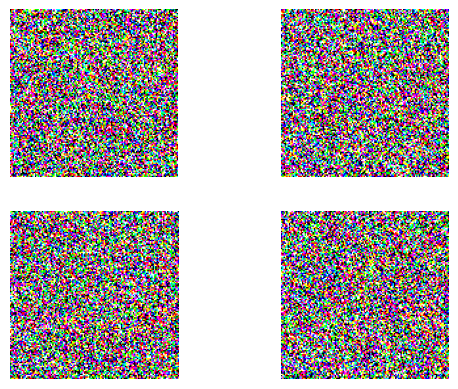

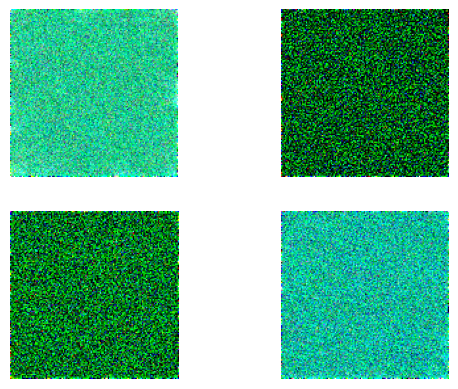

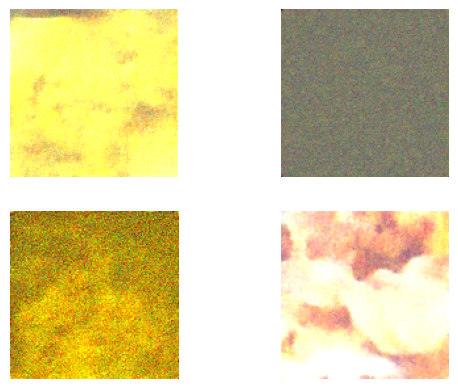

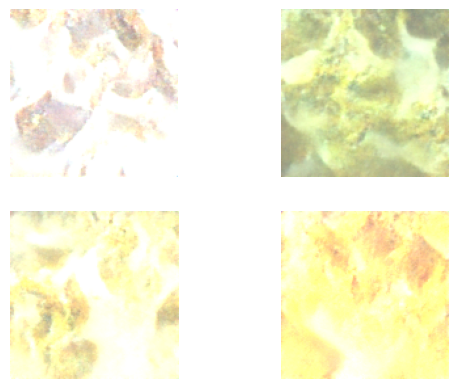

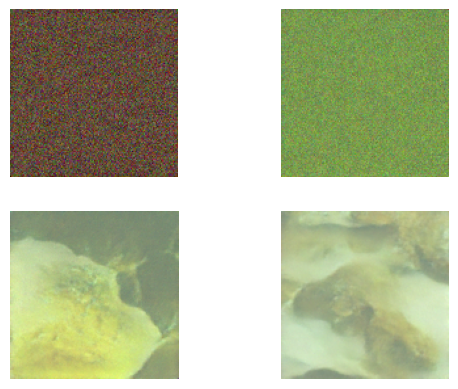

...

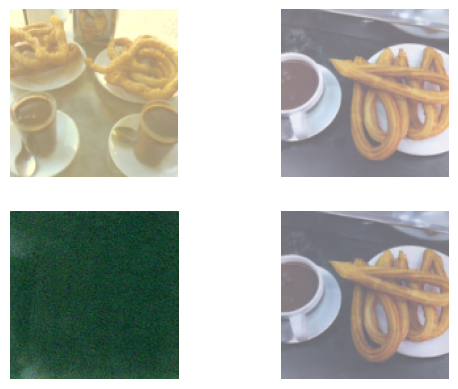

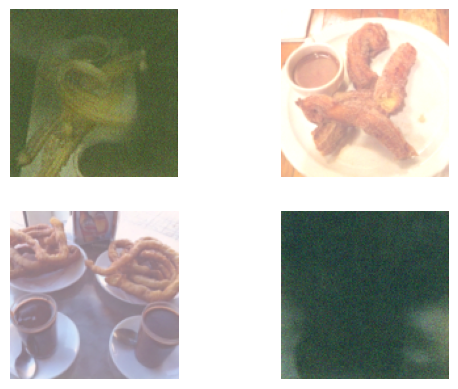

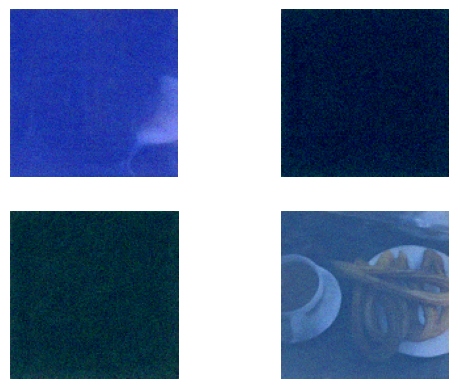

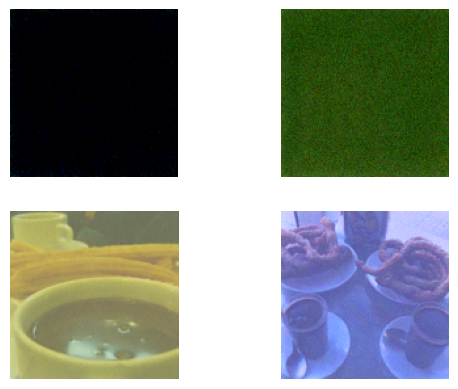

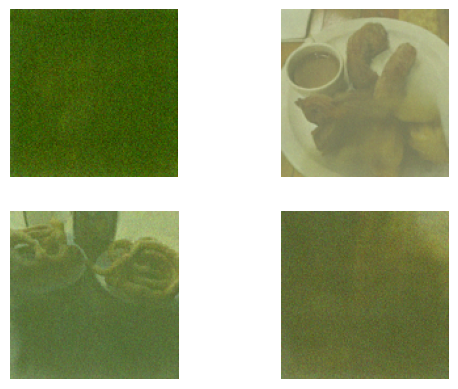

In [ ]:
g_model_path = './temp_2_3/Diffusion_00_Food101_models_sample_10_data_01/'
g_video_path = './temp_2_3/Diffusion_00_Food101_videos_sample_10_data_01/'
Path(g_model_path).mkdir(exist_ok=True, parents=True)
Path(g_video_path).mkdir(exist_ok=True, parents=True)


# parameters
n_steps = 1000
batch_size = 4
nsample = batch_size * 5
epoches = n_steps * nsample * 100
eval_step = nsample
nb_images = 4
img_channel = 3

# datasets
transform = transforms.Compose([
                transforms.ToTensor(),
                transforms.Resize((128),interpolation=transforms.InterpolationMode.BILINEAR, antialias=True),
                transforms.CenterCrop((128, 128)),
                # transforms.Normalize(mean=(0.5), std=(0.5)) # Normalizes to [-1, 1]
            ])
dataset = datasets.Food101(root='./temp/data', split='train', download=True, transform=transform)
# print(len(dataset))
# print(type(dataset))



data_sz = len(dataset)
# subset_sz = int(data_sz * 0.0005)
indices = list(range(nsample))
subset_dataset = Subset(dataset, indices)
dataloader = torch.utils.data.DataLoader(subset_dataset, batch_size=batch_size, shuffle=True, drop_last=True)

# Setup Model
model = UNet(in_ch = img_channel)
model.to(g_device)
optimizer = torch.optim.Adam(model.parameters(), lr=2e-5)
diffusion_model = DiffusionModel(n_steps, model, g_device)

# Training
loss_lst = []
loss_best = float('inf')
for ep in range(epoches):
    # print(f"Epoch - {ep}")
    tq = tqdm(enumerate(dataloader), total = len(dataloader), desc="Training")
    loss_e = 0
    for i, x0, in tq:
        x0 = x0[0].to(g_device)
        _loss = diffusion_model.training(x0, batch_size, optimizer)
        loss_lst.append(_loss)
        loss_e += _loss
        tq.set_description(f"Epoch - {ep} / {epoches}- Loss: {_loss:.5f}; step {i}; epoch {ep}")

    if loss_e < loss_best:
        print(f"best loss : {loss_e}")
        loss_best = loss_e
        _model_path = os.path.join(g_model_path, f'unet_best.pth')
        torch.save(diffusion_model.function_approximator.state_dict(), _model_path)

    _model_path = os.path.join(g_model_path, f'unet_last.pth')
    torch.save(diffusion_model.function_approximator.state_dict(), _model_path)


    diffusion_model.function_approximator.eval()
    if ep % (nsample*10) == 0 or ep == epoches-1:
        _, t_list = diffusion_model.sampling(n_samples=nb_images, image_channels=img_channel, img_size=(128, 128))
        vfp = os.path.join(g_video_path, f"test_{ep:03d}.mp4")
        save_video_01(t_list, 2, 2, vfp)

        st = time.time()
        samples = diffusion_model.ddpm_sampling(n_samples=nb_images, image_channels=img_channel, img_size=(128, 128), use_tqdm=True)
        # print(f"DDPM-Sampling {time.time() - st } seconds")
        ddpm_sampling_ts = time.time() - st
        img_op = os.path.join(g_video_path, f"ddpm_{ep:03d}.jpg")
        # samples = (samples.to("cpu") + 1) * 0.5
        ts.save(samples, img_op, ncols = 2)

        st = time.time()
        samples = diffusion_model.ddim_sampling(n_samples=nb_images, image_channels=img_channel, img_size=(128, 128), use_tqdm=True)
        # print(f"DDIM-Sampling {time.time() - st } seconds")
        ddim_sampling_ts = time.time() - st
        img_op = os.path.join(g_video_path, f"ddim_{ep:03d}.jpg")
        # samples = (samples.to("cpu") + 1) * 0.5
        ts.save(samples, img_op, ncols = 2)

        st = time.time()
        samples = diffusion_model.dpm_solver_sampling(n_samples=nb_images, n_steps=10, image_channels=img_channel, img_size=(128, 128), use_tqdm=True)
        # print(f"DPM-Solver-Sampling {time.time() - st } seconds")
        dpm_sampling_ts = time.time() - st
        img_op = os.path.join(g_video_path, f"dpm_solver_{ep:03d}.jpg")
        # samples = (samples.to("cpu") + 1) * 0.5
        ts.save(samples, img_op, ncols = 2)

        print(f"ddpm - {ddpm_sampling_ts:.5f}, ddim - {ddim_sampling_ts:.5f}, dpm_sampling - {dpm_sampling_ts:.5f}")


    diffusion_model.function_approximator.train()

plt.plot(loss_lst)
plt.show()